<a href="https://colab.research.google.com/github/cosminconstantincostea/RL_cosmincostea/blob/Reinforcement-Learning/sMAPPO_Implementation_Optuna_2_1_Stable.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing libraries and dependencies.

In [1]:
from google.colab import drive
from datetime import datetime

drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
pip cache purge

Files removed: 0


In [3]:
!lscpu

Architecture:                x86_64
  CPU op-mode(s):            32-bit, 64-bit
  Address sizes:             52 bits physical, 57 bits virtual
  Byte Order:                Little Endian
CPU(s):                      44
  On-line CPU(s) list:       0-43
Vendor ID:                   AuthenticAMD
  Model name:                AMD EPYC 9B14
    CPU family:              25
    Model:                   17
    Thread(s) per core:      2
    Core(s) per socket:      22
    Socket(s):               1
    Stepping:                1
    BogoMIPS:                5200.01
    Flags:                   fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pg
                             e mca cmov pat pse36 clflush mmx fxsr sse sse2 ht s
                             yscall nx mmxext fxsr_opt pdpe1gb rdtscp lm constan
                             t_tsc rep_good nopl nonstop_tsc cpuid extd_apicid t
                             sc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse
                             4_1

In [4]:
import os
os.environ["RAY_DISABLE_USAGE_STATS"] = "1"   # telemetry, not metrics
os.environ["OTEL_METRICS_EXPORTER"] = "none"  # disable OpenTelemetry metrics exporter
os.environ["OTEL_SDK_DISABLED"] = "true"      # disable OTEL SDK entirely (more aggressive)

In [5]:
# TODO: update to install stable version from PyPi
!pip install --no-deps CityLearn==2.2.0
!pip install nrel-pysam

# Prove standard RL algorithms
!pip install stable-baselines3
!pip install tensorboard
!pip install pettingzoo


# --- Library import ---
!pip install lz4
!pip install -U ray
!pip install ray[tune]

# Otpuna
!pip install optuna

#! Plotly
!pip install Plotly



   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 372.5/372.5 kB 16.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.3/47.3 MB 55.8 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
citylearn 2.2.0 requires doe-xstock>=1.0.0, which is not installed.
citylearn 2.2.0 requires gymnasium, which is not installed.
citylearn 2.2.0 requires openstudio<=3.3.0, which is not installed.
citylearn 2.2.0 requires numpy<2.0.0, but you have numpy 2.0.2 which is incompatible.
citylearn 2.2.0 requires scikit-learn<=1.2.2, but you have scikit-learn 1.6.1 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.0/188.0 kB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 952.1/952.1 kB 61.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour

In [6]:
!pip install ray

In [7]:
# import the necessary pacakages

import gymnasium as gym
from gymnasium import spaces



# system operations
import inspect
import uuid
import warnings

import ray
from ray.tune.registry import register_env
from ray.rllib.algorithms.ppo import PPOConfig
from ray.rllib.env.multi_agent_env import MultiAgentEnv
from ray.rllib.env.multi_agent_env import MultiAgentDict
from ray.rllib.algorithms.callbacks import DefaultCallbacks
from ray.rllib.algorithms.algorithm import Algorithm
from ray import tune
from ray.tune.search.optuna import OptunaSearch
from ray.tune.schedulers import ASHAScheduler
from ray.tune.registry import register_env
from ray.tune import Callback
from ray.rllib.core.rl_module.default_model_config import DefaultModelConfig
from ray.rllib.core.rl_module.multi_rl_module import MultiRLModuleSpec
from ray.rllib.core.rl_module.rl_module import RLModuleSpec
from ray.rllib.policy.policy import PolicySpec


import subprocess
from torch.utils.tensorboard import SummaryWriter

# date and time
import datetime

# type hinting
from typing import Any

# User interaction
from ipywidgets import Button, HTML
from ipywidgets import Text, HBox, VBox

# data visualization
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
from tqdm import tqdm

# data manipulation
from bs4 import BeautifulSoup
import math
import numpy as np
import pandas as pd
import random
import re
import requests
import simplejson as json

# cityLearn
from citylearn.agents.base import (
    BaselineAgent,
    Agent as RandomAgent
)
from citylearn.agents.rbc import HourRBC
from citylearn.agents.q_learning import TabularQLearning
from citylearn.citylearn import CityLearnEnv
from citylearn.data import DataSet
from citylearn.reward_function import RewardFunction
from citylearn.wrappers import (
    NormalizedObservationWrapper,
    StableBaselines3Wrapper,
    TabularQLearningWrapper,
    DiscreteObservationWrapper,
    DiscreteActionWrapper
)

# RL algorithms
from stable_baselines3 import SAC
from stable_baselines3 import PPO
from stable_baselines3 import DQN
from stable_baselines3 import DDPG


# Callbacks
from stable_baselines3.common.callbacks import CheckpointCallback
from stable_baselines3.common.callbacks import EvalCallback
from stable_baselines3.common.callbacks import CallbackList
from stable_baselines3.common.callbacks import StopTrainingOnRewardThreshold
from stable_baselines3.common.callbacks import BaseCallback

import time

import optuna
from absl import flags
from optuna.pruners import MedianPruner
from optuna.samplers import TPESampler
from optuna.visualization import plot_optimization_history, plot_param_importances, plot_parallel_coordinate
from stable_baselines3 import PPO
from stable_baselines3.common.callbacks import StopTrainingOnNoModelImprovement
from stable_baselines3.common.monitor import Monitor

import optuna

# You can use Matplotlib instead of Plotly for visualization by simply replacing `optuna.visualization` with
# `optuna.visualization.matplotlib` in the following examples.
from optuna.visualization.matplotlib import plot_contour
from optuna.visualization.matplotlib import plot_edf
from optuna.visualization.matplotlib import plot_intermediate_values
from optuna.visualization.matplotlib import plot_optimization_history
from optuna.visualization.matplotlib import plot_parallel_coordinate
from optuna.visualization.matplotlib import plot_param_importances
from optuna.visualization.matplotlib import plot_rank
from optuna.visualization.matplotlib import plot_slice
from optuna.visualization.matplotlib import plot_timeline


import shutil

/usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
  warnings.warn(


In [8]:
# Global settings for the remainder of the note book

# All plotted figures without margins
plt.rcParams['axes.ymargin'] = 0
plt.rcParams['axes.xmargin'] = 0
%matplotlib inline

# ignore depractino warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [9]:
# ============================================
# Complete CityLearn Setup with Google Drive
# ============================================

import os
import urllib.request
import json
from google.colab import drive

# Configuration
GDRIVE_PATH = '/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/00_CityLearnDataset'
DATASET_NAME = 'citylearn_challenge_2022_phase_all'
BASE_URL = 'https://raw.githubusercontent.com/nagyzoltan/CityLearn/master/data/datasets/citylearn_challenge_2022_phase_all/'





In [10]:
display('All CityLearn datasets:', sorted(DataSet().get_dataset_names()))
DATASET_NAME = 'citylearn_challenge_2022_phase_all'

print("\nThis is datasetname:",DATASET_NAME)

schema = DataSet().get_schema(DATASET_NAME)
print("\nThis is schema:", schema)
root_directory = schema['root_directory']

print("\nThis is root directoy",root_directory)

INFO:root:The dataset names DNE in cache. Will download from intelligent-environments-lab/CityLearn/tree/v2.2.0 GitHub repository and write to /root/.cache/citylearn/v2.2.0/dataset_names.json. Next time DataSet.get_dataset_names is called, it will read from cache unless DataSet.clear_cache is run first.


'All CityLearn datasets:'

['baeda_3dem',
 'ca_alameda_county_neighborhood',
 'citylearn_challenge_2020_climate_zone_1',
 'citylearn_challenge_2020_climate_zone_2',
 'citylearn_challenge_2020_climate_zone_3',
 'citylearn_challenge_2020_climate_zone_4',
 'citylearn_challenge_2021',
 'citylearn_challenge_2022_phase_1',
 'citylearn_challenge_2022_phase_2',
 'citylearn_challenge_2022_phase_3',
 'citylearn_challenge_2022_phase_all',
 'citylearn_challenge_2022_phase_all_plus_evs',
 'citylearn_challenge_2023_phase_1',
 'citylearn_challenge_2023_phase_2_local_evaluation',
 'citylearn_challenge_2023_phase_2_online_evaluation_1',
 'citylearn_challenge_2023_phase_2_online_evaluation_2',
 'citylearn_challenge_2023_phase_2_online_evaluation_3',
 'citylearn_challenge_2023_phase_3_1',
 'citylearn_challenge_2023_phase_3_2',
 'citylearn_challenge_2023_phase_3_3',
 'quebec_neighborhood_with_demand_response_set_points',
 'quebec_neighborhood_without_demand_response_set_points',
 'tx_travis_county_neighborhood',
 'vt_chittenden_cou

INFO:root:The citylearn_challenge_2022_phase_all dataset DNE in cache. Will download from intelligent-environments-lab/CityLearn/tree/v2.2.0 GitHub repository and write to /root/.cache/citylearn/v2.2.0/datasets. Next time DataSet.get_dataset('citylearn_challenge_2022_phase_all') is called, it will read from cache unless DataSet.clear_cache is run first.



This is datasetname: citylearn_challenge_2022_phase_all

This is schema: {'random_seed': 2022, 'root_directory': '/root/.cache/citylearn/v2.2.0/datasets/citylearn_challenge_2022_phase_all', 'central_agent': False, 'simulation_start_time_step': 0, 'simulation_end_time_step': 8759, 'episode_time_steps': None, 'rolling_episode_split': False, 'random_episode_split': False, 'seconds_per_time_step': 3600, 'observations': {'month': {'active': True, 'shared_in_central_agent': True}, 'day_type': {'active': True, 'shared_in_central_agent': True}, 'hour': {'active': True, 'shared_in_central_agent': True}, 'daylight_savings_status': {'active': False, 'shared_in_central_agent': True}, 'outdoor_dry_bulb_temperature': {'active': True, 'shared_in_central_agent': True}, 'outdoor_dry_bulb_temperature_predicted_1': {'active': True, 'shared_in_central_agent': True}, 'outdoor_dry_bulb_temperature_predicted_2': {'active': True, 'shared_in_central_agent': True}, 'outdoor_dry_bulb_temperature_predicted_3': {

# Building selection and Simulation period selection

In [11]:
def select_buildings(
dataset_name: str, count: int, seed: int, buildings_to_exclude: list[str] = None,
) -> list[str]:
    """ Randoms elect buildings from Citylearn dataset.

    Parameters
    ----------
    dataset_name = str
        CityLearn dataset to query buildings from.
    count: int
        Number of buildings to set as active in schema.
    seed: int
        Seed for pseudo-random number generator
    building_to_exclude: list[str]
        List of buildings to exclude from selection pool

    Returns
    -------
    buildings: list[str]
    """

    assert 1 <= count <= 15, 'count must be between 1 and 15'

    # set random seed
    np.random.seed(seed)

    # get all bulding names
    schema = DataSet().get_schema(dataset_name)
    buildings = list(schema['buildings'].keys())

    # remove buildings 12 and 15 as they have peculiarities in thei data
    # that are no relevant for this application
    buildings_to_exclude = [] if buildings_to_exclude is None \
        else [b for b in buildings_to_exclude]
    buildings_to_exclude += ['Building_12', 'Building_15']

    for b in buildings_to_exclude:
        if b in buildings:
            buildings.remove(b)

    # randomly select specified number of buildings
    buildings = np.random.choice(buildings, count, replace=False)

    return buildings.tolist()

In [12]:
def select_simulation_period(
    dataset_name: str, count: int, seed: int,
    simulation_periods_to_exclude: list[tuple[int, int]] = None
) -> tuple[int, int]:
    """Randomly select environment simulation start and end time steps
    that cover a specified number of days.

    Parameters
    ----------
    dataset_name: str
        CityLearn dataset to query buildings from.
    count: int
        Number of simulation days.
    seed: int
        Seed for pseudo-random number generator.
    simulation_periods_to_exclude: list[tuple[int, int]]
        List of simulation periods to exclude from selection pool.

    Returns
    -------
    simulation_start_time_step: int
        The first time step in schema time series files to
        be read when constructing the environment.
    simulation_end_time_step: int
        The last time step in schema time series files to
        be read when constructing the environment.
    """

    assert 1 <= count <= 365, 'count must be between 1 and 365.'

    # set random seed
    np.random.seed(seed)

    # use any of the files to determine the total
    # number of available time steps
    schema = DataSet().get_schema(dataset_name)
    filename = schema['buildings'][building_name]['carbon_intensity']
    filepath = os.path.join(root_directory, filename)
    time_steps = pd.read_csv(filepath).shape[0]

    # set candidate simulation start time steps
    # spaced by the number of specified days
    simulation_start_time_step_list = np.arange(0, time_steps, 24*count)

    # exclude period if needed
    if simulation_periods_to_exclude is not None:
        simulation_start_time_step_list_to_exclude = \
            [s for s, e in simulation_periods_to_exclude]
        simulation_start_time_step_list = np.setdiff1d(
            simulation_start_time_step_list,
            simulation_start_time_step_list_to_exclude
        )

    else:
        pass

    # randomly select a simulation start time step
    simulation_start_time_step = np.random.choice(
        simulation_start_time_step_list, size=1
    )[0]
    simulation_end_time_step = simulation_start_time_step + 24*count - 1

    # Split for testing and training
    # 70% testing
    # 30% training
    training_days = int(count*0.7)
    print("Training days:", training_days)
    testing_days = int(count*0.3)
    print("Testing days:", testing_days)

    training_time_steps = training_days*24
    print("Training time steps:", training_time_steps)
    testing_time_steps = testing_days*24
    print("Testing time steps:", testing_time_steps)

    training_start_time_step = simulation_start_time_step
    training_end_time_step   = simulation_start_time_step + training_time_steps -1

    testing_start_time_step = training_end_time_step + 1
    testing_end_time_step   = testing_start_time_step + testing_time_steps -1

    return simulation_start_time_step, simulation_end_time_step,\
           training_start_time_step, training_end_time_step, \
           testing_start_time_step , testing_end_time_step



# Get KPIs for evaluation


In [13]:
def get_kpis(env: CityLearnEnv) -> pd.DataFrame:
    """Returns evaluation KPIs.

    Electricity cost and carbon emissions KPIs are provided
    at the building-level and average district-level. Average daily peak,
    ramping and (1 - load factor) KPIs are provided at the district level.

    Parameters
    ----------
    env: CityLearnEnv
        CityLearn environment instance.

    Returns
    -------
    kpis: pd.DataFrame
        KPI table.
    """
    kpis = env.unwrapped.evaluate()

    """try:
        kpis = env.unwrapped.evaluate()
    except ZeroDivisionError:
        # Skip or insert a dummy KPI table
        kpis = pd.DataFrame(columns=['cost_function', 'value', 'level', 'name'])
    """

    # names of KPIs to retrieve from evaluate function
    kpi_names = {
        'cost_total': 'Cost',
        'carbon_emissions_total': 'Emissions',
        'daily_peak_average': 'Avg. daily peak',
        'ramping_average': 'Ramping',
        'monthly_one_minus_load_factor_average': '1 - load factor'
    }
    kpis = kpis[
        (kpis['cost_function'].isin(kpi_names))
    ].dropna()
    kpis['cost_function'] = kpis['cost_function'].map(lambda x: kpi_names[x])

    # round up the values to 2 decimal places for readability
    kpis['value'] = kpis['value'].round(2)

    # rename the column that defines the KPIs
    kpis = kpis.rename(columns={'cost_function': 'kpi'})

    # Add epsilon to prevent division by zero in 1 - load factor calculation
    epsilon = 1e-9
    kpis.loc[kpis['kpi'] == '1 - load factor', 'value'] = kpis.loc[kpis['kpi'] == '1 - load factor', 'value'].apply(lambda x: x if x != 0 else epsilon)


    return kpis

In [14]:
def normalize_kpis_to_reference(kpis: pd.DataFrame, reference_env_id: str) -> pd.DataFrame:
    """
    Normalize KPI values relative to a reference environment.

    The reference environment's KPI values become 1.0, and all others
    are divided by those baseline values.

    Parameters
    ----------
    kpis : pd.DataFrame
        Combined KPI table containing multiple env_ids.
        Must include columns ['env_id', 'kpi', 'name', 'value'].
        (For district-level KPIs, 'name' can be missing or NaN — handled automatically.)
    reference_env_id : str
        Environment ID to use as baseline for normalization.

    Returns
    -------
    pd.DataFrame
        Same KPI table with normalized 'value' column.
    """
    import pandas as pd

    # Copy to avoid mutating the input DataFrame
    kpis = kpis.copy()

    # Build a baseline lookup: (kpi, name) → value
    baseline = kpis[kpis['env_id'] == reference_env_id].copy()
    if 'name' not in baseline.columns:
        baseline['name'] = None  # for district-level where name may be missing

    baseline_lookup = baseline.set_index(['kpi', 'name'])['value']

    # Define a function for normalization lookup
    def normalize_row(row):
        key = (row['kpi'], row.get('name', None))
        base_val = baseline_lookup.get(key, None)
        if base_val is not None and base_val != 0:
            return row['value'] / base_val
        else:
            return row['value']  # leave unchanged if no baseline or zero baseline

    # Apply normalization
    kpis['value'] = kpis.apply(normalize_row, axis=1)

    return kpis


In [15]:
def plot_building_kpis(envs: dict[str, CityLearnEnv]) -> plt.Figure:
    """Plots electricity consumption, cost and carbon emissions
    at the building-level for different control agents in bar charts.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    kpis_list = []

    for k, v in envs.items():
        kpis = get_kpis(v)
        kpis = kpis[kpis['level']=='building'].copy()
        kpis['building_id'] = kpis['name'].str.split('_', expand=True)[1]
        kpis['building_id'] = kpis['building_id'].astype(int).astype(str)
        kpis['env_id'] = k
        kpis_list.append(kpis)

    kpis = pd.concat(kpis_list, ignore_index=True, sort=False)

    reference_env_id = list(envs.keys())[0]  # first env as baseline
    kpis = normalize_kpis_to_reference(kpis, reference_env_id)

    kpi_names= kpis['kpi'].unique()
    column_count_limit = 3
    row_count = math.ceil(len(kpi_names)/column_count_limit)
    column_count = min(column_count_limit, len(kpi_names))
    building_count = len(kpis['name'].unique())
    env_count = len(envs)
    figsize = (3.0*column_count, 0.3*env_count*building_count*row_count)
    fig, _ = plt.subplots(
        row_count, column_count, figsize=figsize, sharey=True
    )

    for i, (ax, (k, k_data)) in enumerate(zip(fig.axes, kpis.groupby('kpi'))):
        sns.barplot(x='value', y='name', data=k_data, hue='env_id', ax=ax)
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.set_title(k)

        for j, _ in enumerate(envs):
            ax.bar_label(ax.containers[j], fmt='%.2f')

        if i == len(kpi_names) - 1:
            ax.legend(
                loc='upper left', bbox_to_anchor=(1.3, 1.0), framealpha=0.0
            )
        else:
            ax.legend().set_visible(False)

        for s in ['right','top']:
            ax.spines[s].set_visible(False)

    return fig

In [16]:
def plot_district_kpis(envs: dict[str, CityLearnEnv]) -> plt.Figure:
    """Plots electricity consumption, cost, carbon emissions,
    average daily peak, ramping and (1 - load factor) at the
    district-level for different control agents in a bar chart.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    kpis_list = []

    for k, v in envs.items():
        kpis = get_kpis(v)
        kpis = kpis[kpis['level']=='district'].copy()
        kpis['env_id'] = k
        kpis_list.append(kpis)

    kpis = pd.concat(kpis_list, ignore_index=True, sort=False)

    reference_env_id = list(envs.keys())[0]  # first env as baseline
    kpis = normalize_kpis_to_reference(kpis, reference_env_id)

    row_count = 1
    column_count = 1
    env_count = len(envs)
    kpi_count = len(kpis['kpi'].unique())
    figsize = (6.0*column_count, 0.225*env_count*kpi_count*row_count)
    fig, ax = plt.subplots(row_count, column_count, figsize=figsize)
    sns.barplot(x='value', y='kpi', data=kpis, hue='env_id', ax=ax)
    ax.set_xlabel(None)
    ax.set_ylabel(None)

    for j, _ in enumerate(envs):
        ax.bar_label(ax.containers[j], fmt='%.2f')

    for s in ['right','top']:
        ax.spines[s].set_visible(False)

    ax.legend(loc='upper left', bbox_to_anchor=(1.3, 1.0), framealpha=0.0)
    plt.tight_layout()

    return fig

In [17]:
def plot_building_load_profiles(
    envs: dict[str, CityLearnEnv], daily_average: bool = None
) -> plt.Figure:
    """Plots building-level net electricty consumption profile
    for different control agents.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.
    daily_average: bool, default: False
        Whether to plot the daily average load profile.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    daily_average = False if daily_average is None else daily_average
    building_count = len(list(envs.values())[0].buildings)
    column_count_limit = 4
    row_count = math.ceil(building_count/column_count_limit)
    column_count = min(column_count_limit, building_count)
    figsize = (4.0*column_count, 3*row_count)
    fig, _ = plt.subplots(row_count, column_count, figsize=figsize)

    for i, ax in enumerate(fig.axes):
        for k, v in envs.items():
            y = v.unwrapped.buildings[i].net_electricity_consumption
            y = np.reshape(y, (-1, 24)).mean(axis=0) if daily_average else y
            x = range(len(y))
            ax.plot(x, y, label=k)

        ax.set_title(v.unwrapped.buildings[i].name)
        ax.set_ylabel('kWh')

        if daily_average:
            ax.set_xlabel('Hour')
            ax.xaxis.set_major_locator(ticker.MultipleLocator(2))

        else:
            ax.set_xlabel('Time step')
            ax.xaxis.set_major_locator(ticker.MultipleLocator(24*7))

        if i == building_count - 1:
            ax.legend(
                loc='upper left', bbox_to_anchor=(1.0, 1.0), framealpha=0.0
            )
        else:
            ax.legend().set_visible(False)


    plt.tight_layout()

    return fig

In [18]:
def plot_average_building_load_profiles(
    envs: dict[str, CityLearnEnv], mode: str = "raw"
) -> plt.Figure:
    """
    Plot building-level net electricity consumption profiles.

    For 'weekly' or 'monthly' mode:
    - Compute average profile for each week/month sequentially
      and plot their evolution across the year.
    """

    # --- setup subplot grid ---
    building_count = len(list(envs.values())[0].buildings)
    column_count_limit = 4
    row_count = math.ceil(building_count / column_count_limit)
    column_count = min(column_count_limit, building_count)
    figsize = (4.0 * column_count, 3 * row_count)
    fig, _ = plt.subplots(row_count, column_count, figsize=figsize)

    for i, ax in enumerate(fig.axes):
        for k, v in envs.items():
            if i >= len(v.buildings):
                continue

            y = np.array(v.buildings[i].net_electricity_consumption)

            # --- mode-specific handling ---
            if mode == "daily":
                period = 24
                y_trim = y[: (len(y) // period) * period]
                y = np.reshape(y_trim, (-1, period)).mean(axis=0)
                x = np.arange(24)
                ax.set_xlabel("Hour of Day")

            elif mode == "weekly":
                period = 24 * 7
                y_trim = y[: (len(y) // period) * period]
                y_weeks = np.reshape(y_trim, (-1, period))
                weekly_means = np.mean(y_weeks, axis=1)  # one avg per week
                y = weekly_means
                x = np.arange(len(y))
                ax.set_xlabel("Week of Year")

            elif mode == "monthly":
                period = 24 * 30
                y_trim = y[: (len(y) // period) * period]
                y_months = np.reshape(y_trim, (-1, period))
                monthly_means = np.mean(y_months, axis=1)  # one avg per month
                y = monthly_means
                x = np.arange(len(y))
                ax.set_xlabel("Month of Year")

            else:  # raw
                x = np.arange(len(y))
                ax.set_xlabel("Time step")

            ax.plot(x, y, label=k)

        ax.set_title(v.buildings[i].name)
        ax.set_ylabel("kWh")

        if i == building_count - 1:
            ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
        else:
            ax.legend().set_visible(False)

    plt.tight_layout()
    return fig


In [19]:
def plot_district_load_profiles(
    envs: dict[str, CityLearnEnv], daily_average: bool = None
) -> plt.Figure:
    """Plots district-level net electricty consumption profile
    for different control agents.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.
    daily_average: bool, default: False
        Whether to plot the daily average load profile.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    daily_average = False if daily_average is None else daily_average
    figsize = (10, 3)
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    for k, v in envs.items():
        y = v.unwrapped.net_electricity_consumption
        y = np.reshape(y, (-1, 24)).mean(axis=0) if daily_average else y
        x = range(len(y))
        ax.plot(x, y, label=k)

    ax.set_ylabel('kWh')

    if daily_average:
        ax.set_xlabel('Hour')
        ax.xaxis.set_major_locator(ticker.MultipleLocator(2))

    else:
        ax.set_xlabel('Time step')
        ax.xaxis.set_major_locator(ticker.MultipleLocator(24*7))

    ax.legend(loc='upper left', bbox_to_anchor=(1.0, 1.0), framealpha=0.0)

    plt.tight_layout()
    return fig

In [20]:
def plot_average_district_load_profiles(
    envs: dict[str, CityLearnEnv], mode: str = "raw"
) -> plt.Figure:
    """
    Plot district-level net electricity consumption profiles.

    For 'weekly' or 'monthly' mode:
    - Compute average district load for each week/month sequentially
      and plot its evolution across the year.

    Parameters
    ----------
    envs : dict[str, CityLearnEnv]
        Mapping of agent names to CityLearn environments.
    mode : str, default "raw"
        One of {"raw", "daily", "weekly", "monthly"}:
        - "raw": full time series
        - "daily": average daily profile (24 hours)
        - "weekly": sequential weekly averages
        - "monthly": sequential monthly averages

    Returns
    -------
    fig : plt.Figure
        Figure containing plotted axes.
    """
    figsize = (10, 3)
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    for k, v in envs.items():
        y = np.array(v.net_electricity_consumption)

        # --- mode-specific processing ---
        if mode == "daily":
            period = 24
            y_trim = y[: (len(y) // period) * period]
            y = np.reshape(y_trim, (-1, period)).mean(axis=0)
            x = np.arange(24)
            ax.set_xlabel("Hour of Day")

        elif mode == "weekly":
            period = 24 * 7
            y_trim = y[: (len(y) // period) * period]
            y_weeks = np.reshape(y_trim, (-1, period))
            weekly_means = np.mean(y_weeks, axis=1)
            y = weekly_means
            x = np.arange(len(y))
            ax.set_xlabel("Week of Year")

        elif mode == "monthly":
            period = 24 * 30
            y_trim = y[: (len(y) // period) * period]
            y_months = np.reshape(y_trim, (-1, period))
            monthly_means = np.mean(y_months, axis=1)
            y = monthly_means
            x = np.arange(len(y))
            ax.set_xlabel("Month of Year")

        else:  # raw
            x = np.arange(len(y))
            ax.set_xlabel("Time step")

        ax.plot(x, y, label=k)

    ax.set_ylabel("kWh")

    if mode == "daily":
        ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
    elif mode == "weekly":
        ax.xaxis.set_major_locator(ticker.MultipleLocator(4))
    elif mode == "monthly":
        ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
    else:
        ax.xaxis.set_major_locator(ticker.MultipleLocator(24 * 7))

    ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
    plt.tight_layout()
    return fig
#

In [21]:
def plot_battery_soc_profiles(envs: dict[str, CityLearnEnv]) -> plt.Figure:
    """Plots building-level battery SoC profiles fro different control agents.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    building_count = len(list(envs.values())[0].buildings)
    column_count_limit = 4
    row_count = math.ceil(building_count/column_count_limit)
    column_count = min(column_count_limit, building_count)
    figsize = (4.0*column_count, 3*row_count)
    fig, _ = plt.subplots(row_count, column_count, figsize=figsize)

    for i, ax in enumerate(fig.axes):
        for k, v in envs.items():
            y = np.array(v.unwrapped.buildings[i].electrical_storage.soc)
            x = range(len(y))
            ax.plot(x, y, label=k)

        ax.set_title(v.unwrapped.buildings[i].name)
        ax.set_xlabel('Time step')
        ax.set_ylabel('SoC')
        ax.xaxis.set_major_locator(ticker.MultipleLocator(24*7))
        ax.set_ylim(0.0, 1.0)

        if i == building_count - 1:
            ax.legend(
                loc='upper left', bbox_to_anchor=(1.0, 1.0), framealpha=0.0
            )
        else:
            ax.legend().set_visible(False)


    plt.tight_layout()

    return fig

In [22]:

def plot_24h_soc_profiles(envs: dict[str, "CityLearnEnv"], start_hour: int = 0) -> plt.Figure:
    """Plots building-level battery SoC average 24h (hour-of-day) profiles for different control agents.

    The profile is averaged across all full days in the test horizon, and then
    circularly shifted so that hour 0 corresponds to midnight.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments.
    start_hour: int, default=0
        Hour-of-day (0..23) corresponding to the FIRST timestep of the test horizon.
        Example: if the first timestep is at 06:00, pass start_hour=6.
        The curve is shifted so x=0 corresponds to midnight.

    Returns
    -------
    fig: plt.Figure
        Figure containing plotted axes.
    """

    if not envs:
        raise ValueError("envs is empty.")

    if not (0 <= start_hour <= 23):
        raise ValueError(f"start_hour must be in [0, 23], got {start_hour}.")

    # Use any env as reference to get building count
    ref_env = next(iter(envs.values()))
    building_count = len(ref_env.buildings)

    column_count_limit = 4
    row_count = math.ceil(building_count / column_count_limit)
    column_count = min(column_count_limit, building_count)
    figsize = (4.0 * column_count, 3 * row_count)
    fig, _ = plt.subplots(row_count, column_count, figsize=figsize)

    for i, ax in enumerate(fig.axes):
        if i >= building_count:
            ax.set_visible(False)
            continue

        for agent_name, env in envs.items():
            # --- get SOC time series ---
            soc = np.array(env.unwrapped.buildings[i].electrical_storage.soc, dtype=float)

            # --- average 24h profile over full days ---
            period = 24
            n = (len(soc) // period) * period
            if n == 0:
                # Not enough samples for a full day; skip plotting for this agent/building.
                continue

            soc = soc[:n]
            soc_24h = soc.reshape(-1, period).mean(axis=0)  # shape (24,)

            # --- align hour 0 with midnight ---
            # If the first timestep corresponds to start_hour, rotate left by start_hour.
            soc_24h = np.roll(soc_24h, -start_hour)

            x = np.arange(24)
            ax.plot(x, soc_24h, label=agent_name)

        ax.set_title(ref_env.unwrapped.buildings[i].name)
        ax.set_xlabel("Hour of day")
        ax.set_ylabel("SoC")
        ax.set_xlim(0, 23)
        ax.set_xticks(np.arange(0, 24, 3))
        ax.set_ylim(0.0, 1.0)

        if i == building_count - 1:
            ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
        else:
            ax.legend().set_visible(False)

    plt.tight_layout()
    return fig


In [23]:
def plot_simulation_summary(envs: dict[str, CityLearnEnv]):
    """Plots KPIs, load and battery SoC profiles for different control agents.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of user-defined control agent names to environments
        the agents have been used to control.
    """

    print('#'*8 + ' BUILDING-LEVEL ' + '#'*8)
    print('Building-level KPIs:')
    _ = plot_building_kpis(envs)
    plt.show()

    print('Building-level simulation period load profiles:')
    _ = plot_building_load_profiles(envs)
    plt.show()

    print('Building-level daily-average load profiles:')
    _ = plot_building_load_profiles(envs, daily_average=True)
    plt.show()

    print('Battery SoC profiles:')
    _ = plot_battery_soc_profiles(envs)
    plt.show()

    print('#'*8 + ' DISTRICT-LEVEL ' + '#'*8)
    print('District-level KPIs:')
    _ = plot_district_kpis(envs)
    plt.show()

    print('District-level simulation period load profiles:')
    _ = plot_district_load_profiles(envs)
    plt.show()

    print('District-level daily-average load profiles:')
    _ = plot_district_load_profiles(envs, daily_average=True)
    plt.show()

In [24]:
## --- Save the figures ---
def plot_simulation_summary(
    envs: dict[str, CityLearnEnv],
    save_dir: str | None = None
):
    """Plots KPIs, load and battery SoC profiles.
    Figures are saved only if save_dir exists.

    Parameters
    ----------
    envs: dict[str, CityLearnEnv]
        Mapping of control agent names to environments.
    save_dir: str | None
        Existing directory where figures will be saved.
    """

    save_figs = save_dir is not None and os.path.isdir(save_dir)

    print('#'*8 + ' BUILDING-LEVEL ' + '#'*8)

    print('Building-level KPIs:')
    fig = plot_building_kpis(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/building_kpis.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('Building-level simulation period load profiles:')
    fig = plot_building_load_profiles(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/building_load_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('Building-level daily-average load profiles:')
    fig = plot_building_load_profiles(envs, daily_average=True)
    if save_figs:
        fig.savefig(f"{save_dir}/building_daily_avg_load_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('Battery SoC profiles:')
    fig = plot_battery_soc_profiles(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/battery_soc_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('#'*8 + ' DISTRICT-LEVEL ' + '#'*8)

    print('District-level KPIs:')
    fig = plot_district_kpis(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/district_kpis.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('District-level simulation period load profiles:')
    fig = plot_district_load_profiles(envs)
    if save_figs:
        fig.savefig(f"{save_dir}/district_load_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()

    print('District-level daily-average load profiles:')
    fig = plot_district_load_profiles(envs, daily_average=True)
    if save_figs:
        fig.savefig(f"{save_dir}/district_daily_avg_load_profiles.png", dpi=300, bbox_inches="tight")
    plt.show()


In [25]:
def plot_actions(actions_list: list[list[float]], building_names: list[str], title: str) -> plt.Figure:
    """Plots action time series for different buildings

    Parameters
    ----------
    actions_list: list[list[float]]
        List of actions where each element with index, i,
        in list is a list of the actions for different buildings
        taken at time step i.
    building_names: list[str]:
        List of build names that map to the action lists.
    title: str
        Plot axes title

    Returns
    -------
    fig: plt.Figure
        Figure with plotted axes

    """

    fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    fig.subplots_adjust(right = 0.78)

    #plt.close(fig)
    plot_data = pd.DataFrame(actions_list, columns=building_names)
    x = list(range(plot_data.shape[0]))

    for c in plot_data.columns:
        y = plot_data[c].tolist()
        ax.plot(x, y, label=c)

    ax.legend(loc='upper left', bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
    ax.set_xlabel('Time step')
    ax.set_ylabel(r'$\frac{kWh}{kWh_{capacity}}$')
    ax.xaxis.set_major_locator(ticker.MultipleLocator(24*7))
    ax.set_title(title)

    return fig

In [26]:
def plot_actions_daily_avg(
    actions_list: list[list[float]],
    building_names: list[str],
    title: str,
    steps_per_day: int = 24,
    ) -> plt.Figure:
    """Plots daily-averaged action/SOC time series for different buildings.

    Assumes actions_list is shaped [T, n_buildings] and that one "day"
    corresponds to `steps_per_day` timesteps (default 24).
    """

    plot_data = pd.DataFrame(actions_list, columns=building_names)

    # Keep only full days (optional but usually cleaner)
    n_full_days = plot_data.shape[0] // steps_per_day
    plot_data = plot_data.iloc[: n_full_days * steps_per_day]

    # Group by day index and average within each day
    day_index = (pd.RangeIndex(len(plot_data)) // steps_per_day)
    daily_avg = plot_data.groupby(day_index).mean()

    fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    fig.subplots_adjust(right = 0.78)
    #plt.close(fig)
    x = list(range(daily_avg.shape[0]))  # day number

    for c in daily_avg.columns:
        ax.plot(x, daily_avg[c].tolist(), label=c)

    ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)
    ax.set_xlabel("Day")
    ax.set_ylabel(r"$\frac{kWh}{kWh_{capacity}}$")
    ax.xaxis.set_major_locator(ticker.MultipleLocator(7))  # weekly tick (in days)
    ax.set_title(title)

    return fig


In [27]:
def plot_actions_daily_profile(
    actions_list: list[list[float]],
    building_names: list[str],
    title: str,
    steps_per_day: int = 24,
) -> plt.Figure:
    """Plots average daily (24h) profile for each building."""

    plot_data = pd.DataFrame(actions_list, columns=building_names)

    # keep full days only
    n_full_days = plot_data.shape[0] // steps_per_day
    plot_data = plot_data.iloc[: n_full_days * steps_per_day]

    # hour of day index: 0..23
    hour_index = pd.RangeIndex(len(plot_data)) % steps_per_day

    # average over all days for each hour
    daily_profile = plot_data.groupby(hour_index).mean()

    fig, ax = plt.subplots(1, 1, figsize=(10,4))
    #plt.close(fig)
    x = list(range(steps_per_day))

    for c in daily_profile.columns:
        ax.plot(x, daily_profile[c].tolist(), label=c)

    ax.set_xlabel("Hour of day")
    ax.set_ylabel(r"$\frac{kWh}{kWh_{capacity}}$")
    ax.xaxis.set_major_locator(ticker.MultipleLocator(4))
    ax.set_title(title)
    ax.legend(loc="upper left", bbox_to_anchor=(1.0, 1.0), framealpha=0.0)

    return fig


In [28]:
def plot_rewards(ax: plt.Axes, rewards: list[float], title: str) -> plt.Axes:
    """Plots rewards over training episodes.

    Parameters
    ----------
    rewards: list[float]
        List of reward sum per episode.
    title: str
        Plot axes title

    Returns
    -------
    ax: plt.Axes
        Plotted axes
    """

    ax.plot(rewards)
    ax.set_xlabel('Episode')
    ax.set_ylabel('Reward')
    ax.set_title(title)

    return ax

In [29]:
def plot_aer(agent_rewards_dict, epochs, episodes_per_epoch):
    """
    Plots the Average Epoch Rewards (AER) for multiple agents.

    Parameters
    ----------
    agent_rewards_dict : dict
        Dictionary where keys are agent names (str) and values are lists of episode rewards (from ARC.get_rewards()).
        Example:
            {
                "DQN": rewards_dqn,
                "PPO": rewards_ppo,
                "SAC": rewards_sac
            }

    epochs : int
        Total number of epochs to consider.

    episodes_per_epoch : int
        Number of episodes in each epoch.

    Returns
    -------
    None
        Displays a matplotlib plot of all agents' AER curves.
    """
    plt.figure(figsize=(10, 6))

    for agent_name, episode_rewards in (agent_rewards_dict.items()):
        aer_values = average_epoch_reward(episode_rewards, epochs, episodes_per_epoch)
        plt.plot(range(1, len(aer_values) + 1), aer_values, label=agent_name)

    plt.xlabel("Epoch")
    plt.ylabel("Average Reward per Epoch")
    plt.title("Average Epoch Rewards of Agents")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# DASHBOARD


In [30]:
import os
import warnings

# Suppress TensorFlow warnings
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

# Suppress Python warnings
warnings.filterwarnings('ignore')

# Suppress Ray dedup logs
os.environ['RAY_DEDUP_LOGS'] = '0'

os.environ["RAY_DISABLE_USAGE_STATS"] = "1"
print("✅ Warning suppression enabled")

✅ Warning suppression enabled


## Callback functions single agent reward

In [31]:
class CustomReward(RewardFunction):
    def __init__(self, env_metadata: dict[str, Any]):
        r"""Initialize CustomReward.

        Parameters
        ----------
        env_metadata: dict[str, Any]:
            General static information about the environment.
        """

        super().__init__(env_metadata)

    def calculate(
        self, observations: list[dict[str, int | float]]
    ) -> list[float]:
        r"""Returns reward for most recent action.

        The reward is designed to minimize electricity cost.
        It is calculated for each building, i and summed to provide the agent
        with a reward that is representative of all n buildings.
        It encourages net-zero energy use by penalizing grid load satisfaction
        when there is energy in the battery as well as penalizing
        net export when the battery is not fully charged through the penalty
        term. There is neither penalty nor reward when the battery
        is fully charged during net export to the grid. Whereas, when the
        battery is charged to capacity and there is net import from the
        grid the penalty is maximized.

        Parameters
        ----------
        observations: list[dict[str, int | float]]
            List of all building observations at current
            :py:attr:`citylearn.citylearn.CityLearnEnv.time_step`
            that are got from calling
            :py:meth:`citylearn.building.Building.observations`.

        Returns
        -------
        reward: list[float]
            Reward for transition to current timestep.
        """

        reward_list = []

        for o, m in zip(observations, self.env_metadata['buildings']):
            cost = o['net_electricity_consumption']*o['electricity_pricing']
            battery_soc = o['electrical_storage_soc']
            penalty = -(1.0 + np.sign(cost)*battery_soc)
            reward = penalty*abs(cost)
            reward_list.append(reward)

        reward = [sum(reward_list)]

        # for i, o in enumerate(observations):
        #     cost = o['net_electricity_consumption'] * o['electricity_pricing']
        #     soc  = o['electrical_storage_soc']
        #     pen  = -(1.0 + np.sign(cost) * soc)
        #     rew  = pen * abs(cost)
        #     print(
        #         i,
        #         "net=", o['net_electricity_consumption'],
        #         "price=", o['electricity_pricing'],
        #         "cost=", cost,
        #         "soc=", soc,
        #         "pen=", pen,
        #         "rew_i=", rew,
        #         # include the battery action you sent for that building:
        #         "a_batt=", actions[i] if np.ndim(actions) == 1 else actions[i, 0]
        #     )

        return reward

## Period Calculation

In [32]:
display('All CityLearn datasets:', sorted(DataSet().get_dataset_names()))
DATASET_NAME = 'citylearn_challenge_2022_phase_all'

schema = DataSet().get_schema(DATASET_NAME)
display(schema)
root_directory = schema['root_directory']

print('This is root_directory:',root_directory)

building_name = 'Building_1'

filename = schema['buildings'][building_name]['energy_simulation']
print('Filename:', filename)
filepath = os.path.join(root_directory, filename)
building_data = pd.read_csv(filepath)
display(building_data.head())


print("Summer Train Period")
summer_train_start = building_data['month'].to_numpy().tolist().index(6)-1
summer_train_end = 8759-24
print(summer_train_start)
print(summer_train_end)
display(building_data.loc[[summer_train_start],:],
        building_data.loc[[summer_train_end],:])

print('Summer Test Period')
summer_test_start = building_data['month'].to_numpy().tolist().index(8)
summer_test_end = building_data['month'].to_numpy().tolist().index(9)-1
print(summer_test_start)
print(summer_test_end)
display(building_data.loc[[summer_test_start],:],
        building_data.loc[[summer_test_end],:])

print("Winter Train Period")
winter_train_start = building_data['month'].to_numpy().tolist().index(10)
winter_train_end =  building_data['month'].to_numpy().tolist().index(12)-1-24
print(winter_train_start)
print(winter_train_end)
display(building_data.loc[[winter_train_start],:],
        building_data.loc[[winter_train_end],:])

print('Winter Test Period')
winter_test_start = building_data['month'].to_numpy().tolist().index(12)
winter_test_end = building_data['month'].to_numpy().tolist().index(1)-1
print(winter_test_start)
print(winter_test_end)
display(building_data.loc[[winter_test_start],:],
        building_data.loc[[winter_test_end],:])

'All CityLearn datasets:'

['baeda_3dem',
 'ca_alameda_county_neighborhood',
 'citylearn_challenge_2020_climate_zone_1',
 'citylearn_challenge_2020_climate_zone_2',
 'citylearn_challenge_2020_climate_zone_3',
 'citylearn_challenge_2020_climate_zone_4',
 'citylearn_challenge_2021',
 'citylearn_challenge_2022_phase_1',
 'citylearn_challenge_2022_phase_2',
 'citylearn_challenge_2022_phase_3',
 'citylearn_challenge_2022_phase_all',
 'citylearn_challenge_2022_phase_all_plus_evs',
 'citylearn_challenge_2023_phase_1',
 'citylearn_challenge_2023_phase_2_local_evaluation',
 'citylearn_challenge_2023_phase_2_online_evaluation_1',
 'citylearn_challenge_2023_phase_2_online_evaluation_2',
 'citylearn_challenge_2023_phase_2_online_evaluation_3',
 'citylearn_challenge_2023_phase_3_1',
 'citylearn_challenge_2023_phase_3_2',
 'citylearn_challenge_2023_phase_3_3',
 'quebec_neighborhood_with_demand_response_set_points',
 'quebec_neighborhood_without_demand_response_set_points',
 'tx_travis_county_neighborhood',
 'vt_chittenden_cou

{'random_seed': 2022,
 'root_directory': '/root/.cache/citylearn/v2.2.0/datasets/citylearn_challenge_2022_phase_all',
 'central_agent': False,
 'simulation_start_time_step': 0,
 'simulation_end_time_step': 8759,
 'episode_time_steps': None,
 'rolling_episode_split': False,
 'random_episode_split': False,
 'seconds_per_time_step': 3600,
 'observations': {'month': {'active': True, 'shared_in_central_agent': True},
  'day_type': {'active': True, 'shared_in_central_agent': True},
  'hour': {'active': True, 'shared_in_central_agent': True},
  'daylight_savings_status': {'active': False,
   'shared_in_central_agent': True},
  'outdoor_dry_bulb_temperature': {'active': True,
   'shared_in_central_agent': True},
  'outdoor_dry_bulb_temperature_predicted_1': {'active': True,
   'shared_in_central_agent': True},
  'outdoor_dry_bulb_temperature_predicted_2': {'active': True,
   'shared_in_central_agent': True},
  'outdoor_dry_bulb_temperature_predicted_3': {'active': True,
   'shared_in_central_a

This is root_directory: /root/.cache/citylearn/v2.2.0/datasets/citylearn_challenge_2022_phase_all
Filename: Building_1.csv


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
0,7,24,7,0,NaN,NaN,NaN,2.275800,0.0,0.0,0.0,0.0
1,8,1,1,0,NaN,NaN,NaN,0.851167,0.0,0.0,0.0,0.0
2,8,2,1,0,NaN,NaN,NaN,0.834600,0.0,0.0,0.0,0.0
3,8,3,1,0,NaN,NaN,NaN,0.838167,0.0,0.0,0.0,0.0
4,8,4,1,0,NaN,NaN,NaN,1.478433,0.0,0.0,0.0,0.0


Summer Train Period
7296
8735


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
7296,5,24,3,0,NaN,NaN,NaN,0.605442,0.0,0.0,0.0,0.0


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
8735,7,23,7,0,NaN,NaN,NaN,1.237117,0.0,0.0,0.0,0.0


Summer Test Period
1
744


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
1,8,1,1,0,NaN,NaN,NaN,0.851167,0.0,0.0,0.0,0.0


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
744,8,24,3,0,NaN,NaN,NaN,3.579383,0.0,0.0,0.0,0.0


Winter Train Period
1465
2904


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
1465,10,1,6,0,NaN,NaN,NaN,0.693983,0.0,0.0,0.0,0.0


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
2904,11,24,2,0,NaN,NaN,NaN,0.59575,0.0,0.0,0.0,0.0


Winter Test Period
2929
3672


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
2929,12,1,4,0,NaN,NaN,NaN,0.559683,0.0,0.0,0.0,0.0


,month,hour,day_type,daylight_savings_status,indoor_dry_bulb_temperature,average_unmet_cooling_setpoint_difference,indoor_relative_humidity,non_shiftable_load,dhw_demand,cooling_demand,heating_demand,solar_generation
3672,12,24,6,0,NaN,NaN,NaN,0.743517,0.0,0.0,0.0,0.0


In [33]:
# Custom reward function adapted for the Multi Agent
class CustomReward_MA(RewardFunction):

    def __init__(self, env_metadata: dict[str, Any]):
        super().__init__(env_metadata)


    def calculate(self, observations: list[dict[str, int | float]]) -> list[float]:
        rewards = []

        for o in observations:
            cost = o["net_electricity_consumption"] * o["electricity_pricing"]
            battery_soc = o["electrical_storage_soc"]
            penalty = -(1.0 + np.sign(cost) * battery_soc)
            reward = penalty * abs(cost)
            rewards.append(reward)

        return rewards  # one value per building

## Control Parameters

In [34]:
# --- Params for the env creation


TRAIN_DATASET = 'citylearn_challenge_2022_phase_all' #/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/00_CityLearnDataset/schema.json'
TEST_DATASET = 'citylearn_challenge_2022_phase_all'#'/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/00_CityLearnDataset/schema.json'

RANDOM_SEED = 42

BUILDING_COUNT= 4 #17

BUILDINGS_TRAIN = sorted(select_buildings(
    TRAIN_DATASET,
    BUILDING_COUNT,
    RANDOM_SEED,
))
BUILDINGS_TEST = sorted(select_buildings(
    TEST_DATASET,
    BUILDING_COUNT,
    RANDOM_SEED
))

REWARD_CLASS = CustomReward_MA
ACTIVE_OBSERVATIONS = [
    'hour',
    'day_type',
    'solar_generation',
    'net_electricity_consumption',
    'electrical_storage_soc'
]
CENTRAL_AGENT = False

# - REcapt for the periods
TRAIN_START_TIME_STEP = summer_train_start
TRAIN_END_TIME_STEP = summer_train_end
TEST_START_TIME_STEP = summer_test_start
TEST_END_TIME_STEP = summer_test_end
print('Summer train start:', summer_train_start)
print('Summer train end:', summer_train_end)
print('Summer test start:', summer_test_start)
print('Summer test end:', summer_test_end)

print('Test period:',summer_train_end - summer_train_start+1)

print('Winter train start:', winter_train_start)
print('Winter train end:', winter_train_end)
print('Winter test start:', winter_test_start)
print('Winter test end:', winter_test_end)

print('Winter Train period:',winter_train_end - winter_train_start +1)
print('Winter Test period:', winter_test_end - winter_test_start +1)

Summer train start: 7296
Summer train end: 8735
Summer test start: 1
Summer test end: 744
Test period: 1440
Winter train start: 1465
Winter train end: 2904
Winter test start: 2929
Winter test end: 3672
Winter Train period: 1440
Winter Test period: 744


# Optuna - Set-up


## Resources estimation


In [35]:
def auto_configure_resources(
    min_workers_per_trial=2,
    max_workers_per_trial=12,
    ram_per_env_gb=0.8,
    verbose=True
):
    """
    Automatically configure Ray resources based on available hardware.

    Parameters:
    -----------
    min_workers_per_trial : int
        Minimum env_runners per trial (default: 2)
    max_workers_per_trial : int
        Maximum env_runners per trial (default: 12)
    ram_per_env_gb : float
        Estimated RAM per environment in GB (default: 0.8)
    verbose : bool
        Print configuration details (default: True)

    Returns:
    --------
    config : dict
        {
            'num_cpus': int,              # For ray.init()
            'NUM_ENV_RUNNERS': int,       # Workers per trial
            'max_concurrent_trials': int, # Parallel trials
        }
    """
    import psutil
    import os

    # Detect available resources
    AVAILABLE_CPUS = os.cpu_count()
    AVAILABLE_RAM_GB = psutil.virtual_memory().total / (1024**3)

    # Reserve for system (10% or minimum 2 CPUs)
    RESERVED_CPUS = max(2, int(AVAILABLE_CPUS * 0.10))
    USABLE_CPUS = AVAILABLE_CPUS - RESERVED_CPUS

    # Base CPUs per trial (driver + learner)
    CPUS_PER_TRIAL_BASE = 2

    # Calculate workers per trial
    # Target: Use 25-35% of usable CPUs per trial
    TARGET_CPUS_PER_TRIAL = max(
        CPUS_PER_TRIAL_BASE + min_workers_per_trial,
        int(USABLE_CPUS * 0.30)
    )
    NUM_ENV_RUNNERS = min(
        TARGET_CPUS_PER_TRIAL - CPUS_PER_TRIAL_BASE,
        max_workers_per_trial
    )

    # Calculate concurrent trials
    max_concurrent_trials = max(1, USABLE_CPUS // (NUM_ENV_RUNNERS + CPUS_PER_TRIAL_BASE))

    # Redistribute leftover CPUs to workers
    ACTUAL_CPUS_USED = max_concurrent_trials * (NUM_ENV_RUNNERS + CPUS_PER_TRIAL_BASE)
    LEFTOVER_CPUS = USABLE_CPUS - ACTUAL_CPUS_USED

    if LEFTOVER_CPUS >= max_concurrent_trials:
        EXTRA_WORKERS = LEFTOVER_CPUS // max_concurrent_trials
        NUM_ENV_RUNNERS = min(NUM_ENV_RUNNERS + EXTRA_WORKERS, max_workers_per_trial)

    # Recalculate actual usage
    CPUS_PER_TRIAL = NUM_ENV_RUNNERS + CPUS_PER_TRIAL_BASE
    TOTAL_CPUS_USED = max_concurrent_trials * CPUS_PER_TRIAL

    # RAM constraint check
    TOTAL_ENVS = max_concurrent_trials * NUM_ENV_RUNNERS
    ESTIMATED_RAM_USAGE = TOTAL_ENVS * ram_per_env_gb
    RAM_UTILIZATION = (ESTIMATED_RAM_USAGE / AVAILABLE_RAM_GB) * 100

    # If RAM usage > 80%, reduce workers
    if RAM_UTILIZATION > 80:
        reduction_factor = 0.8 / (RAM_UTILIZATION / 100)
        new_workers = max(min_workers_per_trial, int(NUM_ENV_RUNNERS * reduction_factor))

        if verbose:
            print(f"⚠️  RAM Warning: {RAM_UTILIZATION:.0f}% estimated usage")
            print(f"   Reducing NUM_ENV_RUNNERS: {NUM_ENV_RUNNERS} → {new_workers}")

        NUM_ENV_RUNNERS = new_workers
        CPUS_PER_TRIAL = NUM_ENV_RUNNERS + CPUS_PER_TRIAL_BASE
        TOTAL_CPUS_USED = max_concurrent_trials * CPUS_PER_TRIAL
        TOTAL_ENVS = max_concurrent_trials * NUM_ENV_RUNNERS
        ESTIMATED_RAM_USAGE = TOTAL_ENVS * ram_per_env_gb
        RAM_UTILIZATION = (ESTIMATED_RAM_USAGE / AVAILABLE_RAM_GB) * 100

    config = {
        'num_cpus': AVAILABLE_CPUS,  # Ray init uses all CPUs
        'NUM_ENV_RUNNERS': NUM_ENV_RUNNERS,
        'max_concurrent_trials': max_concurrent_trials,
    }

    if verbose:
        print("\n" + "="*70)
        print("AUTO-CONFIGURATION")
        print("="*70)
        print(f"Hardware Detected:")
        print(f"  Total CPUs:           {AVAILABLE_CPUS}")
        print(f"  Reserved for system:  {RESERVED_CPUS}")
        print(f"  Usable CPUs:          {USABLE_CPUS}")
        print(f"  Total RAM:            {AVAILABLE_RAM_GB:.1f} GB")
        print(f"\nOptimal Configuration:")
        print(f"  NUM_ENV_RUNNERS:        {NUM_ENV_RUNNERS}")
        print(f"  max_concurrent_trials:  {max_concurrent_trials}")
        print(f"  CPUs per trial:         {CPUS_PER_TRIAL}")
        print(f"  Total CPUs used:        {TOTAL_CPUS_USED}/{USABLE_CPUS} ({TOTAL_CPUS_USED/USABLE_CPUS*100:.0f}%)")
        print(f"\nResource Estimates:")
        print(f"  Total environments:     {TOTAL_ENVS}")
        print(f"  Est. RAM usage:         {ESTIMATED_RAM_USAGE:.1f}/{AVAILABLE_RAM_GB:.1f} GB ({RAM_UTILIZATION:.0f}%)")
        print(f"  RAM per environment:    {ram_per_env_gb:.1f} GB")
        print("="*70 + "\n")

    return config

In [36]:
# Auto-detect and configure --- ESTIMATION SET UP TO BE CONFIGURED IN THE NEXT CELL
config = auto_configure_resources(
    min_workers_per_trial=2,    # Minimum env_runners
    max_workers_per_trial=12,   # Maximum env_runners
    verbose=True
)



AUTO-CONFIGURATION
Hardware Detected:
  Total CPUs:           8
  Reserved for system:  2
  Usable CPUs:          6
  Total RAM:            51.0 GB

Optimal Configuration:
  NUM_ENV_RUNNERS:        4
  max_concurrent_trials:  1
  CPUs per trial:         6
  Total CPUs used:        6/6 (100%)

Resource Estimates:
  Total environments:     4
  Est. RAM usage:         3.2/51.0 GB (6%)
  RAM per environment:    0.8 GB



In [52]:
def auto_configure_resources_with_trials(
    num_trials=60,
    min_workers_per_trial=2,
    max_workers_per_trial=12,
    ram_per_env_gb=0.8,
    asha_reduction_factor=2,
    grace_period_fraction=0.25,
    verbose=True
):
    """
    Automatically configure Ray resources based on available hardware AND trial count.

    Strategy:
    - Few trials (< 10): Maximize speed per trial (more workers, fewer concurrent)
    - Many trials (> 30): Maximize throughput (more concurrent, moderate workers)
    - With ASHA: Account for early stopping to optimize total time

    Parameters:
    -----------
    num_trials : int
        Total number of trials to run
    min_workers_per_trial : int
        Minimum env_runners per trial (default: 2)
    max_workers_per_trial : int
        Maximum env_runners per trial (default: 12)
    ram_per_env_gb : float
        Estimated RAM per environment in GB (default: 0.8)
    asha_reduction_factor : int
        ASHA reduction factor (default: 2 means keep top 50%)
    grace_period_fraction : float
        Fraction of full training to reach grace period (default: 0.25)
    verbose : bool
        Print configuration details (default: True)

    Returns:
    --------
    config : dict
        Configuration dictionary with optimal settings
    """
    import psutil
    import os
    import math

    # Detect available resources
    AVAILABLE_CPUS = os.cpu_count()
    AVAILABLE_RAM_GB = psutil.virtual_memory().total / (1024**3)

    # Reserve for system (10% or minimum 2 CPUs)
    RESERVED_CPUS = max(2, int(AVAILABLE_CPUS * 0.10))
    USABLE_CPUS = AVAILABLE_CPUS - RESERVED_CPUS

    # Base CPUs per trial (driver + learner)
    CPUS_PER_TRIAL_BASE = 2

    # ========================================================================
    # STRATEGY BASED ON TRIAL COUNT
    # ========================================================================

    # Estimate trials that complete to each rung with ASHA
    trials_at_grace = num_trials
    trials_at_rung_1 = num_trials / asha_reduction_factor
    trials_at_rung_2 = trials_at_rung_1 / asha_reduction_factor
    trials_complete = max(1, trials_at_rung_2 / asha_reduction_factor)

    # Calculate "effective trials" (weighted by how far they run)
    # Grace period counts as 0.25x, Rung 1 as 0.5x, Complete as 1.0x
    effective_trials = (
        trials_at_grace * grace_period_fraction +
        trials_at_rung_1 * 0.5 +
        trials_at_rung_2 * 0.75 +
        trials_complete * 1.0
    )

    if verbose:
        print(f"\nASHA Progression Estimate:")
        print(f"  Trials reaching grace:    {trials_at_grace:.0f}")
        print(f"  Trials reaching rung 1:   {trials_at_rung_1:.0f}")
        print(f"  Trials reaching rung 2:   {trials_at_rung_2:.0f}")
        print(f"  Trials completing full:   {trials_complete:.0f}")
        print(f"  Effective trial count:    {effective_trials:.1f}")

    # ========================================================================
    # DETERMINE STRATEGY: THROUGHPUT vs SPEED
    # ========================================================================

    # Calculate throughput score (0 to 1, higher = favor more concurrent trials)
    if num_trials <= 5:
        throughput_score = 0.0  # Very few trials: maximize speed per trial
    elif num_trials <= 15:
        throughput_score = 0.3  # Few trials: slightly favor speed
    elif num_trials <= 40:
        throughput_score = 0.6  # Medium trials: balanced
    else:
        throughput_score = 0.8  # Many trials: favor throughput

    # Adjust based on CPU availability (more CPUs = can afford more concurrent)
    if USABLE_CPUS >= 40:
        throughput_score = min(1.0, throughput_score + 0.2)
    elif USABLE_CPUS <= 8:
        throughput_score = max(0.0, throughput_score - 0.2)

    if verbose:
        print(f"\nStrategy Score:")
        print(f"  Throughput focus: {throughput_score:.1f} (0=speed, 1=throughput)")

    # ========================================================================
    # CALCULATE WORKERS PER TRIAL
    # ========================================================================

    # Base target: 30% of usable CPUs per trial
    base_target = int(USABLE_CPUS * 0.30)

    # Adjust based on throughput score
    # High throughput = fewer workers per trial
    # Low throughput = more workers per trial
    workers_adjustment = (1 - throughput_score)  # 0.0 to 1.0
    target_workers = int(
        min_workers_per_trial +
        (base_target - CPUS_PER_TRIAL_BASE) * workers_adjustment
    )

    NUM_ENV_RUNNERS = max(
        min_workers_per_trial,
        min(target_workers, max_workers_per_trial)
    )

    # ========================================================================
    # CALCULATE CONCURRENT TRIALS
    # ========================================================================

    CPUS_PER_TRIAL = NUM_ENV_RUNNERS + CPUS_PER_TRIAL_BASE

    # Maximum possible concurrent trials based on CPUs
    max_possible_concurrent = USABLE_CPUS // CPUS_PER_TRIAL

    # Optimal concurrent based on trial count
    # Rule: Don't need more concurrent than ~20% of total trials
    # (with ASHA stopping most early, this maintains good pipeline)
    optimal_for_trials = max(1, int(num_trials * 0.20))

    # Choose the limiting factor
    max_concurrent_trials = min(max_possible_concurrent, optimal_for_trials)

    # Ensure at least 1, but cap at reasonable maximum (8-10 is usually enough)
    max_concurrent_trials = max(1, min(max_concurrent_trials, 10))

    # ========================================================================
    # REDISTRIBUTE LEFTOVER CPUS
    # ========================================================================

    ACTUAL_CPUS_USED = max_concurrent_trials * CPUS_PER_TRIAL
    LEFTOVER_CPUS = USABLE_CPUS - ACTUAL_CPUS_USED

    # Add leftover CPUs back as workers (if meaningful and under max)
    if LEFTOVER_CPUS >= max_concurrent_trials and NUM_ENV_RUNNERS < max_workers_per_trial:
        EXTRA_WORKERS = LEFTOVER_CPUS // max_concurrent_trials
        NUM_ENV_RUNNERS = min(NUM_ENV_RUNNERS + EXTRA_WORKERS, max_workers_per_trial)
        CPUS_PER_TRIAL = NUM_ENV_RUNNERS + CPUS_PER_TRIAL_BASE
        ACTUAL_CPUS_USED = max_concurrent_trials * CPUS_PER_TRIAL

    # ========================================================================
    # RAM CONSTRAINT CHECK
    # ========================================================================

    TOTAL_ENVS = max_concurrent_trials * NUM_ENV_RUNNERS
    ESTIMATED_RAM_USAGE = TOTAL_ENVS * ram_per_env_gb
    RAM_UTILIZATION = (ESTIMATED_RAM_USAGE / AVAILABLE_RAM_GB) * 100

    # If RAM usage > 80%, reduce workers
    if RAM_UTILIZATION > 80:
        reduction_factor = 0.75 / (RAM_UTILIZATION / 100)
        new_workers = max(min_workers_per_trial, int(NUM_ENV_RUNNERS * reduction_factor))

        if verbose:
            print(f"\n⚠️  RAM Warning: {RAM_UTILIZATION:.0f}% estimated usage")
            print(f"   Reducing NUM_ENV_RUNNERS: {NUM_ENV_RUNNERS} → {new_workers}")

        NUM_ENV_RUNNERS = new_workers
        CPUS_PER_TRIAL = NUM_ENV_RUNNERS + CPUS_PER_TRIAL_BASE
        ACTUAL_CPUS_USED = max_concurrent_trials * CPUS_PER_TRIAL
        TOTAL_ENVS = max_concurrent_trials * NUM_ENV_RUNNERS
        ESTIMATED_RAM_USAGE = TOTAL_ENVS * ram_per_env_gb
        RAM_UTILIZATION = (ESTIMATED_RAM_USAGE / AVAILABLE_RAM_GB) * 100

    # ========================================================================
    # TIME ESTIMATION
    # ========================================================================

    # Rough estimates (adjust based on your actual environment)
    SECONDS_PER_1K_TIMESTEPS_BASE = 10  # With 1 worker
    speedup_from_workers = min(NUM_ENV_RUNNERS * 0.85, NUM_ENV_RUNNERS)  # 85% efficiency
    seconds_per_1k = SECONDS_PER_1K_TIMESTEPS_BASE / speedup_from_workers

    # Estimate time with ASHA early stopping
    grace_timesteps = 14400  # Your grace period
    full_timesteps = 288000  # Your max timesteps

    # Compute time for each stage
    time_to_grace = (grace_timesteps / 1000) * seconds_per_1k
    time_to_rung1 = ((grace_timesteps * 2) / 1000) * seconds_per_1k
    time_to_rung2 = ((grace_timesteps * 4) / 1000) * seconds_per_1k
    time_to_complete = (full_timesteps / 1000) * seconds_per_1k

    # Total compute time (all trials if run sequentially)
    total_compute = (
        trials_at_grace * time_to_grace +
        (trials_at_rung_1 - trials_at_rung_2) * (time_to_rung1 - time_to_grace) +
        (trials_at_rung_2 - trials_complete) * (time_to_rung2 - time_to_rung1) +
        trials_complete * (time_to_complete - time_to_rung2)
    )

    # Wall clock time with parallelization
    wall_clock_time = total_compute / max_concurrent_trials
    estimated_hours = wall_clock_time / 3600

    # ========================================================================
    # BUILD CONFIGURATION
    # ========================================================================

    config = {
        'num_cpus': AVAILABLE_CPUS,
        'NUM_ENV_RUNNERS': NUM_ENV_RUNNERS,
        'max_concurrent_trials': max_concurrent_trials,
        'estimated_hours': estimated_hours,
        'strategy': 'throughput' if throughput_score > 0.5 else 'speed',
    }

    if verbose:
        print("\n" + "="*70)
        print("AUTO-CONFIGURATION WITH TRIAL COUNT")
        print("="*70)
        print(f"Input Parameters:")
        print(f"  Total trials:         {num_trials}")
        print(f"  ASHA reduction:       {asha_reduction_factor}x (keep top {100/asha_reduction_factor:.0f}%)")

        print(f"\nHardware Detected:")
        print(f"  Total CPUs:           {AVAILABLE_CPUS}")
        print(f"  Reserved for system:  {RESERVED_CPUS}")
        print(f"  Usable CPUs:          {USABLE_CPUS}")
        print(f"  Total RAM:            {AVAILABLE_RAM_GB:.1f} GB")

        print(f"\nOptimal Configuration:")
        print(f"  Strategy:               {config['strategy'].upper()}")
        print(f"  NUM_ENV_RUNNERS:        {NUM_ENV_RUNNERS}")
        print(f"  max_concurrent_trials:  {max_concurrent_trials}")
        print(f"  CPUs per trial:         {CPUS_PER_TRIAL}")
        print(f"  Total CPUs used:        {ACTUAL_CPUS_USED}/{USABLE_CPUS} ({ACTUAL_CPUS_USED/USABLE_CPUS*100:.0f}%)")

        print(f"\nResource Estimates:")
        print(f"  Total environments:     {TOTAL_ENVS}")
        print(f"  Est. RAM usage:         {ESTIMATED_RAM_USAGE:.1f}/{AVAILABLE_RAM_GB:.1f} GB ({RAM_UTILIZATION:.0f}%)")

        print(f"\nTime Estimation:")
        print(f"  Time per trial (grace): {time_to_grace/60:.1f} min")
        print(f"  Time per trial (full):  {time_to_complete/60:.1f} min")
        print(f"  Total compute time:     {total_compute/3600:.1f} hours")
        print(f"  Est. wall clock time:   {estimated_hours:.1f} hours")
        print("="*70 + "\n")

    return config


In [53]:
MIN_TRIALS_BEFORE_STOP = 54  # Set this first!

# Auto-configure based on hardware AND trial count
config = auto_configure_resources_with_trials(
    num_trials=MIN_TRIALS_BEFORE_STOP,
    min_workers_per_trial=2,
    max_workers_per_trial=12,
    asha_reduction_factor=3,
    grace_period_fraction=0.25,  # 14,400 / 288,000
    verbose=True
)


ASHA Progression Estimate:
  Trials reaching grace:    54
  Trials reaching rung 1:   18
  Trials reaching rung 2:   6
  Trials completing full:   2
  Effective trial count:    29.0

Strategy Score:
  Throughput focus: 1.0 (0=speed, 1=throughput)

AUTO-CONFIGURATION WITH TRIAL COUNT
Input Parameters:
  Total trials:         54
  ASHA reduction:       3x (keep top 33%)

Hardware Detected:
  Total CPUs:           44
  Reserved for system:  4
  Usable CPUs:          40
  Total RAM:            172.9 GB

Optimal Configuration:
  Strategy:               THROUGHPUT
  NUM_ENV_RUNNERS:        2
  max_concurrent_trials:  10
  CPUs per trial:         4
  Total CPUs used:        40/40 (100%)

Resource Estimates:
  Total environments:     20
  Est. RAM usage:         16.0/172.9 GB (9%)

Time Estimation:
  Time per trial (grace): 1.4 min
  Time per trial (full):  28.2 min
  Total compute time:     2.5 hours
  Est. wall clock time:   0.2 hours



##  DASHBOARD

In [54]:
# --- Optuna Study Hyperparams ---

# Simulation day
day_simulation = "2026_02_13"
project_name = "_MAPPO_Summer_Optuna_trial_v1"
EXP_ROOT = '/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/'+day_simulation+project_name
print(EXP_ROOT)

#/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/00_CityLearnDataset

# Local root directory
LOCAL_ROOT = os.path.join("/content", day_simulation+project_name)
os.makedirs(LOCAL_ROOT, exist_ok=True)

# GLOBAL CONFIGURATION

# Dataset and training parameters
TRAIN_SCHEMA = TRAIN_DATASET
TRAIN_START_TIMESTEP = TRAIN_START_TIME_STEP
TRAIN_END_TIMESTEP = TRAIN_END_TIME_STEP+1
BUILDINGS_TRAIN_LIST = BUILDINGS_TRAIN
TOTAL_TIMESTEPS = TRAIN_END_TIMESTEP - TRAIN_START_TIMESTEP

# Evaluation parameters
EVAL_SCHEMA = TRAIN_DATASET
EVAL_START_TIMESTEP = TEST_START_TIME_STEP
EVAL_END_TIMESTEP = TEST_END_TIME_STEP+1
BUILDINGS_EVAL_LIST = BUILDINGS_TEST

# Environment configuration
CENTRAL_AGENT_FLAG = CENTRAL_AGENT

# Train Flag
TRAIN = True

# CONFIGURATION FLAG
TEST_MODE = False # Set to False for full optimization

# Adjust parameters based on mode
if TEST_MODE:
    # Single trial, fast test
    # SB3
    N_EPOCHS = 200
    GRACE_PERIOD = int(N_EPOCHS/20) # Minimum of steps to run the trial.
    MAX_NO_IMPROVEMENT = 2 # Maximum evaluations before stopping the training
    MIN_EVALUATIONS = 1
    N_EVAL_EPISODES = 1  # How many times to evaluate the model

    START_AFTER_EPISODES = 40  # After how many episodes the evaluation should start?

    EVAL_FREQUENCY = TOTAL_TIMESTEPS * 10  # Eval only once at end

    # Optuna
    N_TRIALS = 1
    MIN_TRIALS_BEFORE_STOP = 1  # Minimum trials to run in Optuna
    TRIAL_PATIENCE_WINDOW = 1   # After MIN_TRIALS_BEFORE_STOP make another 10 to check if there are any improvements

else:
    # Full optimization
    # ---- USED IN THIS CASE ---
    N_EPOCHS = 100
    GRACE_PERIOD = int(N_EPOCHS/20) # Minimum of steps to run the trial.
    MIN_TRIALS_BEFORE_STOP = 54 # Minimum trials to run in Optun
    NUM_ENV_RUNNERS = 2
    NUM_CPUS = 40
    MAX_CONCURRENT_TRIALS = 10
    # --- USED IN THIS CASE ---

    MAX_NO_IMPROVEMENT = 1 # Maximum evaluations before stopping the training
    MIN_EVALUATIONS = 1    # Minimum evaluations before stopping the triaining
    N_EVAL_EPISODES = 1    # How many times to evaluate the model

    START_AFTER_EPISODES = 50  # After how many episodes the evaluation should start?

    EVAL_FREQUENCY = (TOTAL_TIMESTEPS-1) * 10  # Every episodes

    # Optuna
    N_TRIALS = None
    TRIAL_PATIENCE_WINDOW = 3  # After MIN_TRIALS_BEFORE_STOP make another 10 to check if there are any improvements


# Training configuration
N_TRAIN_EPOCHS = N_EPOCHS
SEED_TRAIN = RANDOM_SEED
SEED_EVAL = RANDOM_SEED

# Evaluation configuration
N_EVALUATION_EPISODES = N_EVAL_EPISODES


/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


In [36]:
# IN case of emergency to delete
#shutil.rmtree('/content/ray_results')

In [37]:
print(LOCAL_ROOT)
print(EXP_ROOT)

/content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/IPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


## Custom Reward MA Definition

In [55]:
%%writefile /content/custom_reward.py
"""
Custom reward function for CityLearn MARL.
This file must be importable by Ray workers.
"""

import numpy as np
from typing import Any
from citylearn.reward_function import RewardFunction


class CustomReward_MA(RewardFunction):
    """Custom reward function adapted for Multi-Agent."""

    def __init__(self, env_metadata: dict[str, Any]):
        super().__init__(env_metadata)

    def calculate(self, observations: list[dict[str, int | float]]) -> list[float]:
        """
        Calculate reward for each building independently.

        Returns one reward value per building.

        Reward structure:
        - Penalizes high electricity costs
        - Considers battery state of charge (SOC)
        - Higher penalty when buying from grid (positive cost) with low battery
        - Lower penalty when selling to grid (negative cost) or with high battery
        """
        rewards = []

        for o in observations:
            # Calculate electricity cost
            cost = o["net_electricity_consumption"] * o["electricity_pricing"]

            # Get battery state of charge
            battery_soc = o["electrical_storage_soc"]

            # Penalty factor:
            # - If cost > 0 (buying): penalty increases with low SOC
            # - If cost < 0 (selling): penalty decreases
            penalty = -(1.0 + np.sign(cost) * battery_soc)

            # Final reward: negative of (penalty * |cost|)
            reward = penalty * abs(cost)

            rewards.append(reward)

        return rewards  # one value per building


# Make it easily importable
__all__ = ['CustomReward_MA']

Overwriting /content/custom_reward.py


##  RLlib Wrapper

In [56]:
from gymnasium.spaces import Dict as GymDict, Box
from ray.rllib.env.multi_agent_env import MultiAgentEnv
from citylearn.citylearn import CityLearnEnv
from citylearn.wrappers import NormalizedObservationWrapper
from custom_reward import CustomReward_MA
import numpy as np


class RllibCityLearnEnv(MultiAgentEnv):
    """
    RLlib-compatible wrapper for CityLearn (Ray 2.x / MAPPO).
    Each agent observation is a Dict with:
      "obs"   - local observation (for the actor)
      "state" - concatenation of all agents' observations (for the centralized critic)
    """

    def __init__(self, config: dict):
        schema_path = config["schema"]
        buildings   = config.get("buildings")
        episode_limit    = config.get("episode_limit", 1440)
        start_timestep   = config.get("simulation_start_time_step")
        end_timestep     = config.get("simulation_end_time_step")

        base_env = CityLearnEnv(
            schema=schema_path,
            reward_function=CustomReward_MA,
            central_agent=False,
            buildings=buildings,
            simulation_start_time_step=start_timestep,
            simulation_end_time_step=end_timestep,
        )
        self.env = NormalizedObservationWrapper(base_env)

        building_names   = [b.name for b in self.env.unwrapped.buildings]
        num_agents       = len(building_names)
        self._agent_ids  = set(building_names)
        self.possible_agents = list(building_names)

        super().__init__()

        self._num_agents    = num_agents
        self._episode_limit = episode_limit
        self._obs_space_in_preferred_format    = True
        self._action_space_in_preferred_format = True

        self.env.reset()

        # Local obs dims per agent (needed to build the global state space)
        local_spaces = [
            Box(
                low=self.env.observation_space[i].low,
                high=self.env.observation_space[i].high,
                shape=self.env.observation_space[i].shape,
                dtype=np.float32,
            )
            for i in range(num_agents)
        ]
        local_obs_dim  = local_spaces[0].shape[0]   # homogeneous agents
        global_obs_dim = local_obs_dim * num_agents

        # Each agent sees: its own local obs + the full global state
        self.observation_space = GymDict({
            building: GymDict({
                "obs": local_spaces[i],
                "state": Box(
                    low=-np.inf,
                    high=np.inf,
                    shape=(global_obs_dim,),
                    dtype=np.float32,
                ),
            })
            for i, building in enumerate(building_names)
        })

        self.action_space = GymDict({
            building: self.env.action_space[i]
            for i, building in enumerate(building_names)
        })

        # print(f"Environment created with {num_agents} agents:")
        # print(f"  Local obs dim : {local_obs_dim}")
        # print(f"  Global state dim: {global_obs_dim}")

    def _build_obs_dict(self, obs_list):
        """Convert CityLearn obs_list into per-agent {obs, state} dicts."""
        building_names = [b.name for b in self.env.unwrapped.buildings]
        local_obs = [np.array(obs_list[i], dtype=np.float32) for i in range(self._num_agents)]
        global_state = np.concatenate(local_obs)   # shape: (global_obs_dim,)
        return {
            building: {
                "obs":   local_obs[i],
                "state": global_state,
            }
            for i, building in enumerate(building_names)
        }

    def reset(self, *, seed=None, options=None):
        obs_list, _ = self.env.reset()
        obs_dict    = self._build_obs_dict(obs_list)
        building_names = [b.name for b in self.env.unwrapped.buildings]
        info_dict   = {building: {} for building in building_names}
        return obs_dict, info_dict

    def step(self, action_dict):
        building_names = [b.name for b in self.env.unwrapped.buildings]

        action_list = [
            [action_dict[building]]
            for building in building_names
        ]

        obs_list, reward_list, terminated, truncated, _ = self.env.step(action_list)

        done = terminated or truncated
        obs_dict    = self._build_obs_dict(obs_list)
        reward_dict = {building: reward_list[i] for i, building in enumerate(building_names)}

        terminated_dict = {building: done for building in building_names}
        terminated_dict["__all__"] = done

        truncated_dict = {building: False for building in building_names}
        truncated_dict["__all__"] = False

        info_dict = {building: {} for building in building_names}

        return obs_dict, reward_dict, terminated_dict, truncated_dict, info_dict

## RL Module for MAPPO

In [57]:
"""
MAPPOTorchRLModule
==================
Custom PPO RLModule implementing MAPPO (Multi-Agent PPO) with a centralized critic.

Architecture (CTDE - Centralized Training, Decentralized Execution):
  Actor  : local_obs  ("obs"   key) -> MLP -> action distribution inputs
  Critic : global_state ("state" key) -> MLP -> scalar value estimate

The actor and critic are fully separate networks (no shared layers).
Log-std is a learned parameter vector, not produced by the MLP.

Compatible with Ray RLlib >= 2.5 new API stack (PPOTorchRLModule base class).
"""

import torch
import torch.nn as nn
from ray.rllib.core.rl_module.torch.torch_rl_module import TorchRLModule
from ray.rllib.core.rl_module.apis.value_function_api import ValueFunctionAPI
from ray.rllib.core.columns import Columns

_ACTIVATIONS = {
    "tanh": nn.Tanh,
    "relu": nn.ReLU,
    "elu":  nn.ELU,
}

def _build_mlp(input_dim, hidden_sizes, output_dim, activation):
    act_cls = _ACTIVATIONS.get(activation, nn.Tanh)
    layers = []
    in_dim = input_dim
    for h in hidden_sizes:
        layers.append(nn.Linear(in_dim, h))
        layers.append(act_cls())
        in_dim = h
    layers.append(nn.Linear(in_dim, output_dim))
    return nn.Sequential(*layers)


class MAPPOTorchRLModule(TorchRLModule, ValueFunctionAPI):
    """
    MAPPO RLModule with centralized critic.
    Actor  : obs["obs"]   -> action distribution inputs
    Critic : obs["state"] -> scalar value estimate
    Implements ValueFunctionAPI so RLlib's GAE connector can call compute_values().
    """

    def __init__(self, *args, **kwargs):
        if args and not kwargs and hasattr(args[0], 'observation_space'):
            cfg = args[0]
            TorchRLModule.__init__(
                self,
                observation_space=cfg.observation_space,
                action_space=cfg.action_space,
                inference_only=getattr(cfg, 'inference_only', False),
                learner_only=getattr(cfg, 'learner_only', False),
                model_config=getattr(cfg, 'model_config', {}),
            )
        else:
            TorchRLModule.__init__(self, *args, **kwargs)

    def setup(self):
        local_obs_dim    = self.observation_space["obs"].shape[0]
        global_state_dim = self.observation_space["state"].shape[0]
        action_dim       = self.action_space.shape[0]

        cfg = self.model_config
        if hasattr(cfg, 'fcnet_hiddens'):
            hiddens    = list(cfg.fcnet_hiddens)
            activation = cfg.fcnet_activation
        else:
            hiddens    = list(cfg.get('fcnet_hiddens', [64, 64]))
            activation = cfg.get('fcnet_activation', 'tanh')

        self.actor  = _build_mlp(local_obs_dim,    hiddens, action_dim * 2, activation)
        self.critic = _build_mlp(global_state_dim, hiddens, 1,              activation)

    def compute_values(self, batch, embeddings=None):
        """
        Called by GeneralAdvantageEstimation connector to bootstrap values.
        Must return a tensor of shape [B].
        """
        obs = batch[Columns.OBS]
        # obs may arrive as a plain tensor if the connector flattens it —
        # handle both dict and flat tensor defensively
        if isinstance(obs, dict):
            global_state = obs["state"]
        else:
            # fallback: treat full obs as state (should not happen with correct wrapper)
            global_state = obs
        return self.critic(global_state).squeeze(-1)

    def _forward_inference(self, batch, **kwargs):
        return {Columns.ACTION_DIST_INPUTS: self.actor(batch[Columns.OBS]["obs"])}

    def _forward_exploration(self, batch, **kwargs):
        obs = batch[Columns.OBS]
        return {
            Columns.ACTION_DIST_INPUTS: self.actor(obs["obs"]),
            Columns.VF_PREDS:           self.critic(obs["state"]).squeeze(-1),
        }

    def _forward_train(self, batch, **kwargs):
        obs = batch[Columns.OBS]
        return {
            Columns.ACTION_DIST_INPUTS: self.actor(obs["obs"]),
            Columns.VF_PREDS:           self.critic(obs["state"]).squeeze(-1),
        }

## Schema Path and Test Config

In [58]:
# UPDATE THIS PATH to your schema location
SCHEMA_PATH = "/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/00_CityLearnDataset/schema.json"  # Colab default

# Or if you're mounting from Google Drive:
# from google.colab import drive
# drive.mount('/content/drive')
# SCHEMA_PATH = "/content/drive/MyDrive/path/to/schema.json"

# Or use the one from your files:
# SCHEMA_PATH = "/home/allenwu/Desktop/work/MARLlib_CityLearn2/citylearn_challenge_2022_phase_1/schema.json"

print(f"Schema path: {SCHEMA_PATH}")
print(f"Exists: {os.path.exists(SCHEMA_PATH)}")

Schema path: /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/00_CityLearnDataset/schema.json
Exists: True


In [46]:
# Create a test environment
test_config = {
    "schema": SCHEMA_PATH,
    "buildings": BUILDINGS_TRAIN,
    "simulation_start_time_step": TRAIN_START_TIMESTEP,
    "simulation_end_time_step": TRAIN_END_TIMESTEP,
    "episode_limit": TRAIN_END_TIMESTEP - TRAIN_START_TIMESTEP,
}

print("Creating test environment...")
test_env = RllibCityLearnEnv(test_config)

print("\nResetting environment...")
obs_dict, info_dict = test_env.reset()

print(f"\nNumber of agents: {len(obs_dict)}")
print(f"Agent IDs: {list(obs_dict.keys())}")

# Access observation_space as a DICT, not a method call
print(f"\nObservation space for agent_0:")
print(f"  Shape: {test_env.observation_space['Building_1']}")
print(f"  Low: {test_env.observation_space['Building_1'].low[:3]}... (first 3)")
print(f"  High: {test_env.observation_space['Building_1'].high[:3]}... (first 3)")

# Access action_space as a DICT, not a method call
print(f"\nAction space for agent_0:")
print(f"  {test_env.action_space['Building_1']}")

print(f"\nSample observation for agent_0:")
print(f"  Shape: {len(obs_dict['Building_1'])}")
print(f"  Values: {obs_dict['Building_1'][:5]}... (first 5)")

# Test a step
print("\nTesting environment step...")
# Sample from action spaces (also dict access now)
action_dict = {
    agent_id: test_env.action_space[agent_id].sample()
    for agent_id in obs_dict.keys()
}

obs, rewards, terminated, truncated, infos = test_env.step(action_dict)

print(f"✓ Step successful!")
print(f"  Rewards: {list(rewards.values())[:4]}... (first 3 agents)")
print(f"  Done: {terminated['__all__']}")

Creating test environment...


INFO:root:The PV sizing data DNE in cache. Will download from intelligent-environments-lab/CityLearn/tree/v2.2.0 GitHub repository and write to /root/.cache/citylearn/v2.2.0/misc. Next time DataSet.get_pv_sizing_data is called, it will read from cache unless DataSet.clear_cache is run first.
INFO:root:The battery sizing data DNE in cache. Will download from intelligent-environments-lab/CityLearn/tree/v2.2.0 GitHub repository and write to /root/.cache/citylearn/v2.2.0/misc. Next time DataSet.get_battery_sizing_data is called, it will read from cache unless DataSet.clear_cache is run first.


Environment created with 4 agents:
  Local obs dim : 31
  Global state dim: 124

Resetting environment...

Number of agents: 4
Agent IDs: ['Building_1', 'Building_10', 'Building_13', 'Building_16']

Observation space for agent_0:
  Shape: Dict('obs': Box(0.0, 1.0, (31,), float32), 'state': Box(-inf, inf, (124,), float32))


AttributeError: 'Dict' object has no attribute 'low'

In [59]:
# Initialize Ray with runtime_env to include our custom module
if ray.is_initialized():
    ray.shutdown()

# Tell Ray about our custom module
ray.init(
    ignore_reinit_error=True,
    num_cpus=2,
    num_gpus=0,
    runtime_env={
        "py_modules": ["/content/custom_reward.py"],  # Include our custom module
        "env_vars": {"PYTHONPATH": "/content"}  # Ensure /content is in path
    }
)

# Environment factory function
def env_creator(config):
    return RllibCityLearnEnv(config)

# Register environment
ENV_NAME = "CityLearnMAPPO-v0"
register_env(ENV_NAME, env_creator)

print(f"✓ Ray initialized with custom reward module")
print(f"✓ Environment '{ENV_NAME}' registered")

INFO:root:Failed to configure TPU pod. Got: tpu_name: None, worker_id: 0, accelerator_type: v6e-1
2026-02-13 14:21:56,490	INFO worker.py:2007 -- Started a local Ray instance.
2026-02-13 14:21:56,493	INFO packaging.py:691 -- Creating a file package for local module '/content/custom_reward.py'.
2026-02-13 14:21:56,494	INFO packaging.py:463 -- Pushing file package 'gcs://_ray_pkg_9c82dd1520ed948b.zip' (0.00MiB) to Ray cluster...
2026-02-13 14:21:56,495	INFO packaging.py:476 -- Successfully pushed file package 'gcs://_ray_pkg_9c82dd1520ed948b.zip'.


✓ Ray initialized with custom reward module
✓ Environment 'CityLearnMAPPO-v0' registered


## Tensor Board

In [ ]:
#DRIVE_ROOT = '/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_15_PPO_SA_Run'

In [ ]:
# %reload_ext tensorboard
# %tensorboard --logdir {LOCAL_ROOT}

## Test BED

In [46]:
"""
Test suite for the MAPPO-modified RllibCityLearnEnv wrapper.
Runs without CityLearn, gymnasium, or Ray by mocking all dependencies.
Can also be pasted directly into Colab to test with real packages.
"""

import sys
import types
import numpy as np

# ---------------------------------------------------------------------------
# Mock external dependencies so the test runs without Ray / CityLearn / gym
# ---------------------------------------------------------------------------

def _make_mock_modules():
    # --- numpy-based Box and Dict replacements ---
    class Box:
        def __init__(self, low, high, shape=None, dtype=np.float32):
            if shape is None:
                shape = np.array(low).shape
            self.low   = np.full(shape, low,  dtype=dtype)
            self.high  = np.full(shape, high, dtype=dtype)
            self.shape = shape
            self.dtype = dtype
        def sample(self):
            return np.random.uniform(self.low, self.high).astype(self.dtype)
        def __repr__(self):
            return f"Box(shape={self.shape})"

    class GymDict(dict):
        """Minimal Dict space — just a plain dict for our purposes."""
        pass

    # gymnasium.spaces
    gym_spaces = types.ModuleType("gymnasium.spaces")
    gym_spaces.Box  = Box
    gym_spaces.Dict = GymDict
    gymnasium = types.ModuleType("gymnasium")
    gymnasium.spaces = gym_spaces
    sys.modules["gymnasium"]        = gymnasium
    sys.modules["gymnasium.spaces"] = gym_spaces

    # ray stubs
    for mod in [
        "ray", "ray.tune", "ray.tune.registry",
        "ray.rllib", "ray.rllib.env", "ray.rllib.env.multi_agent_env",
    ]:
        sys.modules[mod] = types.ModuleType(mod)

    class MultiAgentEnv:
        def __init__(self): pass

    ray_rllib_env = sys.modules["ray.rllib.env.multi_agent_env"]
    ray_rllib_env.MultiAgentEnv = MultiAgentEnv

    # custom_reward stub
    custom_reward = types.ModuleType("custom_reward")
    custom_reward.CustomReward_MA = object
    sys.modules["custom_reward"] = custom_reward

    # --- Minimal CityLearn mock ---
    N_AGENTS  = 3
    OBS_DIM   = 8   # features per agent
    OBS_TOTAL = N_AGENTS * OBS_DIM

    class MockBuilding:
        def __init__(self, name): self.name = name

    class MockInnerEnv:
        buildings = [MockBuilding(f"Building_{i+1}") for i in range(N_AGENTS)]

    class MockNormalizedEnv:
        def __init__(self):
            self._inner = MockInnerEnv()
            self.observation_space = [
                Box(low=0.0, high=1.0, shape=(OBS_DIM,)) for _ in range(N_AGENTS)
            ]
            self.action_space = [
                Box(low=-1.0, high=1.0, shape=(1,)) for _ in range(N_AGENTS)
            ]
        def unwrapped(self): pass
        @property
        def unwrapped(self):
            return self._inner
        def reset(self):
            obs = [np.random.rand(OBS_DIM).astype(np.float32) for _ in range(N_AGENTS)]
            return obs, {}
        def step(self, action_list):
            obs      = [np.random.rand(OBS_DIM).astype(np.float32) for _ in range(N_AGENTS)]
            rewards  = [float(np.random.randn()) for _ in range(N_AGENTS)]
            terminated = False
            truncated  = False
            info = {}
            return obs, rewards, terminated, truncated, info

    # Patch citylearn imports
    citylearn_mod   = types.ModuleType("citylearn")
    cl_env_mod      = types.ModuleType("citylearn.citylearn")
    cl_wrap_mod     = types.ModuleType("citylearn.wrappers")

    class CityLearnEnv:
        def __init__(self, **kwargs): pass

    cl_env_mod.CityLearnEnv = CityLearnEnv
    cl_wrap_mod.NormalizedObservationWrapper = lambda env: MockNormalizedEnv()

    sys.modules["citylearn"]          = citylearn_mod
    sys.modules["citylearn.citylearn"] = cl_env_mod
    sys.modules["citylearn.wrappers"]  = cl_wrap_mod

    return N_AGENTS, OBS_DIM

N_AGENTS, OBS_DIM = _make_mock_modules()

# ---------------------------------------------------------------------------
# Now import the wrapper (inline definition since we can't import the .py)
# ---------------------------------------------------------------------------
from gymnasium.spaces import Dict as GymDict, Box
from ray.rllib.env.multi_agent_env import MultiAgentEnv
from citylearn.citylearn import CityLearnEnv
from citylearn.wrappers import NormalizedObservationWrapper
from custom_reward import CustomReward_MA


class RllibCityLearnEnv(MultiAgentEnv):
    def __init__(self, config: dict):
        schema_path    = config["schema"]
        buildings      = config.get("buildings")
        episode_limit  = config.get("episode_limit", 1440)
        start_timestep = config.get("simulation_start_time_step")
        end_timestep   = config.get("simulation_end_time_step")

        base_env   = CityLearnEnv(schema=schema_path)
        self.env   = NormalizedObservationWrapper(base_env)

        building_names       = [b.name for b in self.env.unwrapped.buildings]
        num_agents           = len(building_names)
        self._agent_ids      = set(building_names)
        self.possible_agents = list(building_names)

        super().__init__()

        self._num_agents    = num_agents
        self._episode_limit = episode_limit
        self._obs_space_in_preferred_format    = True
        self._action_space_in_preferred_format = True

        self.env.reset()

        local_spaces = [
            Box(
                low=self.env.observation_space[i].low,
                high=self.env.observation_space[i].high,
                shape=self.env.observation_space[i].shape,
                dtype=np.float32,
            )
            for i in range(num_agents)
        ]
        local_obs_dim  = local_spaces[0].shape[0]
        global_obs_dim = local_obs_dim * num_agents

        self.observation_space = GymDict({
            building: GymDict({
                "obs": local_spaces[i],
                "state": Box(
                    low=-np.inf,
                    high=np.inf,
                    shape=(global_obs_dim,),
                    dtype=np.float32,
                ),
            })
            for i, building in enumerate(building_names)
        })

        self.action_space = GymDict({
            building: self.env.action_space[i]
            for i, building in enumerate(building_names)
        })

        self._local_obs_dim  = local_obs_dim
        self._global_obs_dim = global_obs_dim

    def _build_obs_dict(self, obs_list):
        building_names = [b.name for b in self.env.unwrapped.buildings]
        local_obs    = [np.array(obs_list[i], dtype=np.float32) for i in range(self._num_agents)]
        global_state = np.concatenate(local_obs)
        return {
            building: {"obs": local_obs[i], "state": global_state}
            for i, building in enumerate(building_names)
        }

    def reset(self, *, seed=None, options=None):
        obs_list, _ = self.env.reset()
        obs_dict    = self._build_obs_dict(obs_list)
        building_names = [b.name for b in self.env.unwrapped.buildings]
        info_dict   = {building: {} for building in building_names}
        return obs_dict, info_dict

    def step(self, action_dict):
        building_names = [b.name for b in self.env.unwrapped.buildings]
        action_list = [[action_dict[b]] for b in building_names]
        obs_list, reward_list, terminated, truncated, _ = self.env.step(action_list)

        done     = terminated or truncated
        obs_dict = self._build_obs_dict(obs_list)

        reward_dict = {b: reward_list[i] for i, b in enumerate(building_names)}

        terminated_dict = {b: done for b in building_names}
        terminated_dict["__all__"] = done

        truncated_dict = {b: False for b in building_names}
        truncated_dict["__all__"] = False

        info_dict = {b: {} for b in building_names}
        return obs_dict, reward_dict, terminated_dict, truncated_dict, info_dict


# ---------------------------------------------------------------------------
# Tests
# ---------------------------------------------------------------------------

PASS = "[PASS]"
FAIL = "[FAIL]"

def check(label, condition, detail=""):
    status = PASS if condition else FAIL
    suffix = f" -- {detail}" if detail else ""
    print(f"  {status}  {label}{suffix}")
    return condition

def run_tests():
    cfg = {
        "schema": "dummy_schema.json",
        "buildings": None,
        "simulation_start_time_step": 0,
        "simulation_end_time_step": 100,
        "episode_limit": 100,
    }

    print("\n--- Constructing environment ---")
    env = RllibCityLearnEnv(cfg)

    all_ok = True

    # 1. Agent IDs
    print("\n[1] Agent setup")
    all_ok &= check("Correct number of agents",
                    env._num_agents == N_AGENTS, f"got {env._num_agents}")
    all_ok &= check("_agent_ids is a set",
                    isinstance(env._agent_ids, set))
    all_ok &= check("Agent count matches possible_agents",
                    len(env.possible_agents) == N_AGENTS)

    # 2. Observation space structure
    print("\n[2] Observation space structure")
    for agent in env.possible_agents:
        agent_space = env.observation_space[agent]
        all_ok &= check(f"{agent}: space is a dict",
                        isinstance(agent_space, dict))
        all_ok &= check(f"{agent}: has 'obs' key",
                        "obs" in agent_space)
        all_ok &= check(f"{agent}: has 'state' key",
                        "state" in agent_space)
        all_ok &= check(f"{agent}: 'obs' shape is ({OBS_DIM},)",
                        agent_space["obs"].shape == (OBS_DIM,),
                        f"got {agent_space['obs'].shape}")
        all_ok &= check(f"{agent}: 'state' shape is ({N_AGENTS * OBS_DIM},)",
                        agent_space["state"].shape == (N_AGENTS * OBS_DIM,),
                        f"got {agent_space['state'].shape}")

    # 3. reset()
    print("\n[3] reset()")
    obs_dict, info_dict = env.reset()

    all_ok &= check("Returns obs for all agents",
                    set(obs_dict.keys()) == env._agent_ids)
    all_ok &= check("Returns info for all agents",
                    set(info_dict.keys()) == env._agent_ids)

    for agent in env.possible_agents:
        o = obs_dict[agent]
        all_ok &= check(f"{agent}: obs dict has 'obs' and 'state'",
                        "obs" in o and "state" in o)
        all_ok &= check(f"{agent}: 'obs' shape correct",
                        o["obs"].shape == (OBS_DIM,), f"got {o['obs'].shape}")
        all_ok &= check(f"{agent}: 'state' shape correct",
                        o["state"].shape == (N_AGENTS * OBS_DIM,),
                        f"got {o['state'].shape}")
        all_ok &= check(f"{agent}: 'obs' dtype float32",
                        o["obs"].dtype == np.float32)
        all_ok &= check(f"{agent}: 'state' dtype float32",
                        o["state"].dtype == np.float32)

    # 4. Global state is shared and equals concatenation of local obs
    print("\n[4] Global state correctness")
    agents = env.possible_agents
    local_obs_concat = np.concatenate([obs_dict[a]["obs"] for a in agents])
    state_sample     = obs_dict[agents[0]]["state"]

    all_ok &= check("Global state == concat of local obs",
                    np.allclose(local_obs_concat, state_sample))
    all_ok &= check("All agents share the same global state",
                    all(np.allclose(obs_dict[a]["state"], state_sample) for a in agents))

    # 5. step()
    print("\n[5] step()")
    action_dict = {a: env.action_space[a].sample() for a in env.possible_agents}
    obs2, rewards, terminated, truncated, infos = env.step(action_dict)

    all_ok &= check("Obs returned for all agents",
                    set(obs2.keys()) == env._agent_ids)
    all_ok &= check("Rewards returned for all agents",
                    set(rewards.keys()) == env._agent_ids)
    all_ok &= check("'__all__' in terminated",
                    "__all__" in terminated)
    all_ok &= check("'__all__' in truncated",
                    "__all__" in truncated)
    all_ok &= check("Rewards are floats",
                    all(isinstance(v, float) for v in rewards.values()))

    for agent in env.possible_agents:
        o = obs2[agent]
        all_ok &= check(f"{agent}: post-step obs has correct keys",
                        "obs" in o and "state" in o)
        all_ok &= check(f"{agent}: post-step 'obs' shape correct",
                        o["obs"].shape == (OBS_DIM,))
        all_ok &= check(f"{agent}: post-step 'state' shape correct",
                        o["state"].shape == (N_AGENTS * OBS_DIM,))

    # 6. Global state consistency after step
    print("\n[6] Post-step global state correctness")
    local_concat_2 = np.concatenate([obs2[a]["obs"] for a in agents])
    state_sample_2 = obs2[agents[0]]["state"]

    all_ok &= check("Post-step global state == concat of local obs",
                    np.allclose(local_concat_2, state_sample_2))
    all_ok &= check("Post-step all agents share the same state",
                    all(np.allclose(obs2[a]["state"], state_sample_2) for a in agents))

    # 7. Multiple steps without crash
    print("\n[7] Stability over multiple steps")
    env.reset()
    crashed = False
    try:
        for _ in range(10):
            actions = {a: env.action_space[a].sample() for a in env.possible_agents}
            env.step(actions)
    except Exception as e:
        crashed = True
        all_ok &= check("10-step rollout stable", False, str(e))
    if not crashed:
        all_ok &= check("10-step rollout stable", True)

    # Summary
    print("\n" + "="*50)
    if all_ok:
        print("All tests passed.")
    else:
        print("Some tests FAILED -- review output above.")
    print("="*50)


if __name__ == "__main__":
    run_tests()


--- Constructing environment ---

[1] Agent setup
  [PASS]  Correct number of agents -- got 3
  [PASS]  _agent_ids is a set
  [PASS]  Agent count matches possible_agents

[2] Observation space structure
  [PASS]  Building_1: space is a dict
  [PASS]  Building_1: has 'obs' key
  [PASS]  Building_1: has 'state' key
  [PASS]  Building_1: 'obs' shape is (8,) -- got (8,)
  [PASS]  Building_1: 'state' shape is (24,) -- got (24,)
  [PASS]  Building_2: space is a dict
  [PASS]  Building_2: has 'obs' key
  [PASS]  Building_2: has 'state' key
  [PASS]  Building_2: 'obs' shape is (8,) -- got (8,)
  [PASS]  Building_2: 'state' shape is (24,) -- got (24,)
  [PASS]  Building_3: space is a dict
  [PASS]  Building_3: has 'obs' key
  [PASS]  Building_3: has 'state' key
  [PASS]  Building_3: 'obs' shape is (8,) -- got (8,)
  [PASS]  Building_3: 'state' shape is (24,) -- got (24,)

[3] reset()
  [PASS]  Returns obs for all agents
  [PASS]  Returns info for all agents
  [PASS]  Building_1: obs dict has '

# Base implementation


In [43]:
# Import the custom reward from the file we just created
import sys
sys.path.insert(0, '/content')  # Ensure /content is in Python path

from custom_reward import CustomReward_MA

print("✓ Custom reward function imported from custom_reward.py")
print(f"  Module location: {CustomReward_MA.__module__}")
print(f"  Available in: {CustomReward_MA}")

✓ Custom reward function imported from custom_reward.py
  Module location: custom_reward
  Available in: <class 'custom_reward.CustomReward_MA'>


In [44]:
# Test that Ray workers can import it
import ray
import importlib

# Simulate what Ray workers will do
try:
    # This is what happens inside CityLearn when Ray worker loads it
    test_module = importlib.import_module('custom_reward')
    test_class = getattr(test_module, 'CustomReward_MA')
    print("✓ CustomReward_MA is properly importable!")
    print(f"  Class: {test_class}")
except Exception as e:
    print(f"✗ Import failed: {e}")
    print("  This means Ray workers won't be able to find it either.")

✓ CustomReward_MA is properly importable!
  Class: <class 'custom_reward.CustomReward_MA'>


## Algo config

In [51]:
# Environment config
env_config = {
    "schema": SCHEMA_PATH,
    "buildings": BUILDINGS_TRAIN,
    "simulation_start_time_step": TRAIN_START_TIMESTEP,
    "simulation_end_time_step": TRAIN_END_TIMESTEP,
    "episode_limit": TRAIN_END_TIMESTEP - TRAIN_START_TIMESTEP+1,
}

# Create temp env to get agent info
temp_env = env_creator(env_config)
agent_ids = list(temp_env.get_agent_ids())
num_agents = len(agent_ids)

print(f"Configuring MAPPO for {num_agents} agents: {agent_ids}")

# Configure PPO for MAPPO (Multi Agent PPO)
# Configure PPO for MAPPO (Multi Agent PPO)
config = (
    PPOConfig()
    .environment(
        env=ENV_NAME,
        env_config=env_config,
    )
    .learners(
        num_gpus_per_learner=0,
        num_cpus_per_learner=NUM_CPUS,
    )
    .env_runners(
        num_env_runners=NUM_ENV_RUNNERS,
        num_envs_per_env_runner=1,
        rollout_fragment_length=200,
    )
    .training(
        # Hyperparameters from MAPPO paper (Schroeder et al., 2020)
        train_batch_size=2000,
        minibatch_size=200,
        num_epochs=10,
        lr=5e-4,
        gamma=0.99,
        lambda_=0.95,
        clip_param=0.2,
        vf_clip_param=10.0,
        entropy_coeff=0.01,
        vf_loss_coeff=0.5,
        grad_clip=0.5,
    )
   .multi_agent(
    policies={"shared_policy": PolicySpec()},
    policy_mapping_fn=lambda agent_id, *args, **kwargs: "shared_policy",
    )
    .rl_module(
        rl_module_spec=MultiRLModuleSpec(
            rl_module_specs={
                "shared_policy": RLModuleSpec(
                    module_class=MAPPOTorchRLModule,
                )
            },
        ),
        model_config=DefaultModelConfig(
            fcnet_hiddens=[64, 64],
            fcnet_activation="tanh",
        ),
    )
        .debugging(
            log_level="WARN",
        )
    )

print("MAPPO configuration created")
print(f"  Train batch size: {config.train_batch_size}")
print(f"  Number of workers: {config.num_env_runners}")
print(f"  Learning rate: {config.lr}")

print("Building MAPPO algorithm...")
algo = config.build()
print("Algorithm built successfully!")

2026-02-13 13:30:29,929	WARNING ipython-input-529936659.py:12 -- DeprecationWarning: `get_agent_ids` has been deprecated. Use `MultiAgentEnv.possible_agents` instead. This will raise an error in the future!
2026-02-13 13:30:29,931	WARNING ipython-input-529936659.py:76 -- DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
2026-02-13 13:30:29,933	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html


Environment created with 4 agents:
  Local obs dim : 31
  Global state dim: 124
Configuring MAPPO for 4 agents: ['Building_13', 'Building_16', 'Building_10', 'Building_1']
MAPPO configuration created
  Train batch size: 2000
  Number of workers: 2
  Learning rate: 0.0005
Building MAPPO algorithm...


(pid=3497) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=3497) E0000 00:00:1770989435.049072    3497 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=3497) E0000 00:00:1770989435.056290    3497 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=3497) W0000 00:00:1770989435.074008    3497 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
(pid=3497) W0000 00:00:1770989435.074046    3497 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
(pid=3497) W0000 00:00:1770989435.074049    3497 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking t

(MultiAgentEnvRunner pid=3497) Environment created with 4 agents:
(MultiAgentEnvRunner pid=3497)   Local obs dim : 31
(MultiAgentEnvRunner pid=3497)   Global state dim: 124


(MultiAgentEnvRunner pid=3497) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
2026-02-13 13:30:48,817	WARNING rl_module.py:459 -- DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
2026-02-13 13:30:54,611	INFO trainable.py:161 -- Trainable.setup took 24.654 seconds. If your trainable is slow to initialize, consider setting reuse_actors=True to reduce actor creation overheads.
2026-02-13 13:30:54,613	WARNING util.py:61 -- Install gputil for GPU system monitoring.


Algorithm built successfully!


In [52]:
algo.stop()
algo = config.build_algo()

(pid=2983) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=2983) E0000 00:00:1770989180.927154    2983 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=2983) E0000 00:00:1770989180.933980    2983 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=2983) W0000 00:00:1770989180.951364    2983 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
(pid=2983) W0000 00:00:1770989180.951410    2983 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
(pid=2983) W0000 00:00:1770989180.951413    2983 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking t

(MultiAgentEnvRunner pid=2983) Environment created with 4 agents:
(MultiAgentEnvRunner pid=2983)   Local obs dim : 31
(MultiAgentEnvRunner pid=2983)   Global state dim: 124


(MultiAgentEnvRunner pid=2983) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(pid=2984) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=2984) E0000 00:00:1770989181.001366    2984 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
(pid=2984) E0000 00:00:1770989181.008371    2984 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
(pid=2984) W0000 00:00:1770989181.025435    2984 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once. [repeated 4x across cluster]
2026-02-13 13:26:35,722	INFO trainable.p

## Traning Stage

In [54]:
# Training parameters
NUM_ITERATIONS = 10  # Start small for testing
CHECKPOINT_FREQ = 5

print(f"Starting training for {NUM_ITERATIONS} iterations...\n")

best_reward = -np.inf
results = []

for iteration in range(NUM_ITERATIONS):
    result = algo.train()

    # Extract metrics (updated keys for new API)
    episode_return_mean = result.get("env_runners", {}).get("episode_return_mean", 0)
    episode_len_mean = result.get("env_runners", {}).get("episode_len_mean", 0)
    episodes_this_iter = result.get("env_runners", {}).get("num_episodes", 0)
    timesteps_total = result.get("num_env_steps_sampled_lifetime", 0)

    results.append({
        "iteration": iteration + 1,
        "reward_mean": episode_return_mean,
        "episode_len": episode_len_mean,
        "episodes": episodes_this_iter,
        "timesteps": timesteps_total,
    })

    print(f"Iter {iteration + 1:3d} | "
          f"Reward: {episode_return_mean:8.2f} | "
          f"Len: {episode_len_mean:6.1f} | "
          f"Episodes: {episodes_this_iter} | "
          f"Steps: {timesteps_total}")

    # Save best model
    if episode_return_mean > best_reward:
        best_reward = episode_return_mean
        checkpoint_dir = algo.save("/content/mappo_checkpoints/best")
        print(f"  → New best! Saved to {checkpoint_dir}")

    # Periodic checkpoint
    if (iteration + 1) % CHECKPOINT_FREQ == 0:
        checkpoint_dir = algo.save(f"/content/mappo_checkpoints/iter_{iteration+1}")
        print(f"  → Checkpoint saved to {checkpoint_dir}")

print("\n" + "="*60)
print(f"Training complete! Best reward: {best_reward:.2f}")
print("="*60)

Starting training for 10 iterations...

Iter   1 | Reward: -4165.06 | Len: 1440.0 | Episodes: 2.0 | Steps: 6000.0
  → New best! Saved to TrainingResult(checkpoint=Checkpoint(filesystem=local, path=/content/ippo_checkpoints/best), metrics={'timers': {'training_iteration': 16.82838541800004, 'restore_env_runners': 2.0096000071134767e-05, 'training_step': 16.827793192999934, 'env_runner_sampling_timer': 12.121155662999968, 'learner_update_timer': 4.700278521999962, 'synch_weights': 0.0032425449999209377, 'synch_env_connectors': 0.0034824690000050396}, 'env_runners': {'sample': np.float64(2.363705078299995), 'module_to_env_connector': {'connector_pipeline_timer': np.float64(0.0012208713368035114), 'timers': {'connectors': {'un_batch_to_individual_items': np.float64(7.82111654295591e-05), 'module_to_agent_unmapping': np.float64(9.864585168465696e-06), 'get_actions': np.float64(0.00038765072618271044), 'remove_single_ts_time_rank_from_batch': np.float64(3.931955848548988e-06), 'tensor_to_num

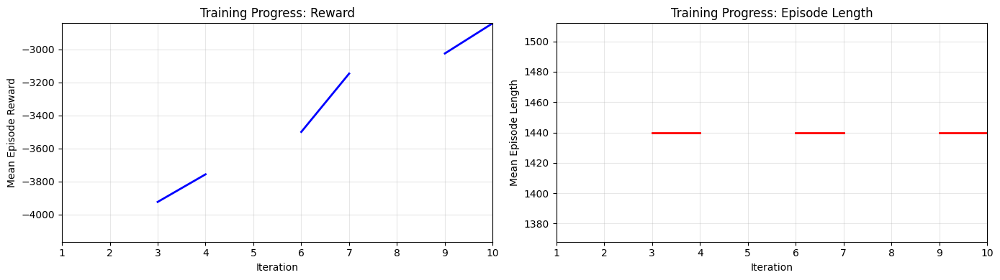


Final mean reward: [np.float64(-4165.06103515625), nan, np.float64(-3923.7261962890625), np.float64(-3756.552978515625), nan, np.float64(-3499.44091796875), np.float64(-3145.908935546875), nan, np.float64(-3024.0220947265625), np.float64(-2840.7977294921875)]
Best mean reward: -2840.80 (iteration 10)


In [55]:
import matplotlib.pyplot as plt

# Convert results to arrays
iterations = [r["iteration"] for r in results]
rewards = [r["reward_mean"] for r in results]
episode_lens = [r["episode_len"] for r in results]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 4))

# Plot rewards
ax1.plot(iterations, rewards, 'b-', linewidth=2)
ax1.set_xlabel('Iteration')
ax1.set_ylabel('Mean Episode Reward')
ax1.set_title('Training Progress: Reward')
ax1.grid(True, alpha=0.3)

# Plot episode length
ax2.plot(iterations, episode_lens, 'r-', linewidth=2)
ax2.set_xlabel('Iteration')
ax2.set_ylabel('Mean Episode Length')
ax2.set_title('Training Progress: Episode Length')
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print(f"\nFinal mean reward: {rewards}")
print(f"Best mean reward: {max(rewards):.2f} (iteration {iterations[rewards.index(max(rewards))]})")

## Evaluation Policy

In [57]:
import torch
from ray.rllib.core.columns import Columns


print("="*70)
print("EVALUATING ON TEST SET")
print("="*70)

test_env_config = {
    "schema": SCHEMA_PATH,
    "buildings": BUILDINGS_TEST,
    "simulation_start_time_step": TEST_START_TIME_STEP,
    "simulation_end_time_step": TEST_END_TIME_STEP ,  # +1 for 1440 steps
    "episode_limit": TEST_END_TIME_STEP - TEST_START_TIME_STEP + 1,
}

test_env = env_creator(test_env_config)

obs, _ = test_env.reset()
terminated = {"__all__": False}
truncated  = {"__all__": False}
step_count = 0

# Per-agent reward accumulator
per_agent_rewards = {agent_id: [] for agent_id in agent_ids}
combined_rewards  = []

while not (terminated["__all__"] or truncated["__all__"]):
    actions = {}
    for agent_id in obs.keys():
        agent_obs = obs[agent_id]  # dict: {"obs": np.array, "state": np.array}

        obs_tensor = {
            Columns.OBS: {
                "obs":   torch.FloatTensor(agent_obs["obs"]).unsqueeze(0),
                "state": torch.FloatTensor(agent_obs["state"]).unsqueeze(0),
            }
        }

        with torch.no_grad():
            out = algo.env_runner.module["shared_policy"].forward_inference(obs_tensor)

        # Gaussian actor: ACTION_DIST_INPUTS = [means..., log_stds...]
        # Take only the first half (means) as the deterministic action
        dist_inputs = out[Columns.ACTION_DIST_INPUTS]
        action = dist_inputs[..., :dist_inputs.shape[-1] // 2].squeeze(0).numpy()
        actions[agent_id] = action

    obs, rewards, terminated, truncated, _ = test_env.step(actions)

    for agent_id in agent_ids:
        per_agent_rewards[agent_id].append(rewards.get(agent_id, 0.0))

    combined_rewards.append(sum(rewards.values()))
    step_count += 1

# --- Summary ---
print(f"\nEpisode length:          {step_count} steps")
print(f"Combined total reward:   {sum(combined_rewards):.4f}")
print(f"Combined mean reward:    {np.mean(combined_rewards):.4f}")
print(f"\nPer-agent rewards:")
for agent_id in agent_ids:
    total = sum(per_agent_rewards[agent_id])
    mean  = np.mean(per_agent_rewards[agent_id])
    std   = np.std(per_agent_rewards[agent_id])
    print(f"  {agent_id}: total={total:.4f}  mean/step={mean:.4f}  std={std:.4f}")

EVALUATING ON TEST SET
Environment created with 4 agents:
  Local obs dim : 31
  Global state dim: 124

Episode length:          743 steps
Combined total reward:   -1081.6632
Combined mean reward:    -1.4558

Per-agent rewards:
  Building_13: total=-235.1330  mean/step=-0.3165  std=0.3717
  Building_16: total=-257.2578  mean/step=-0.3462  std=0.4175
  Building_10: total=-302.7101  mean/step=-0.4074  std=0.5640
  Building_1: total=-286.5624  mean/step=-0.3857  std=0.4554


In [ ]:
# Cleanup
ray.shutdown()
print("✓ Ray shutdown complete")

In [ ]:
# type(eval_rewards[-1])
# eval_env = eval_rewards[-1]

In [ ]:
# kpis = get_kpis(eval_env.env.unwrapped)
# print(kpis)

# Tune - Optuna Study


## DriveSync

In [63]:
class DriveSync(Callback):
    """
    Callback to sync Ray Tune results to Google Drive after each trial completes.

    This allows:
    - Fast local I/O during training
    - Automatic backup to Drive after each trial
    - Recovery if Colab disconnects
    """

    def __init__(self, local_dir, drive_dir):
        self.local_dir = local_dir
        self.drive_dir = drive_dir
        self.sync_count = 0

    def on_trial_complete(self, iteration, trials, trial, **info):
        """Called after each trial completes (success or failure)"""
        self.sync_count += 1

        print(f"\n{'='*70}")
        print(f"Syncing trial results to Google Drive... (sync #{self.sync_count})")
        print(f"   From: {self.local_dir}")
        print(f"   To:   {self.drive_dir}")

        try:
            # Use rsync to copy files (faster than cp, handles incremental sync)
            result = subprocess.run(
                ['rsync', '-av', '--update', self.local_dir + '/', self.drive_dir + '/'],
                capture_output=True,
                text=True,
                timeout=300  # 5 minute timeout
            )

            if result.returncode == 0:
                print(f"Sync complete! Trial '{trial}' backed up to Drive")
            else:
                print(f"Sync had issues (but continuing): {result.stderr}")

        except subprocess.TimeoutExpired:
            print(f"Sync timed out after 5 minutes (continuing anyway)")
        except Exception as e:
            print(f"Sync failed with error: {e}")
            print(f"   (Training will continue, but this trial may not be backed up)")


print("DriveSync callback defined")


DriveSync callback defined


## Tensorboard Launch

In [64]:
print(LOCAL_ROOT)

/content/2026_02_13_MAPPO_Summer_Optuna_trial_v1


In [65]:
%reload_ext tensorboard

# Launch TensorBoard pointing to Ray Tune's log directory
%tensorboard --logdir {LOCAL_ROOT}

print("✓ TensorBoard launched")
print("  Open the TensorBoard tab above to monitor training in real-time")
print("  You'll see learning curves for each trial as they run")

Reusing TensorBoard on port 6006 (pid 6448), started 0:08:43 ago. (Use '!kill 6448' to kill it.)

<IPython.core.display.Javascript object>

✓ TensorBoard launched
  Open the TensorBoard tab above to monitor training in real-time
  You'll see learning curves for each trial as they run


## Restart in case of Failure

In [66]:
# CELL 1.6: [OPTIONAL] Recovery from Colab Disconnect
# ----------------------------------------------------------------------------
# If Colab disconnects and you want to RESUME optimization:
#
# 1. Re-run your setup cells (imports, EXP_ROOT definition, etc.)
# 2. Mount Drive:
#    from google.colab import drive
#    drive.mount('/content/drive')
# 3. Copy results back from Drive:
#    !rsync -av {EXP_ROOT}/ /content/ray_results/
# 4. Run Cell 5 with resume=True or resume="AUTO":
#    analysis = tune.run(..., resume="AUTO")
#
# Tune will detect completed trials and skip them!
#
# DO NOT RUN THIS CELL - IT'S JUST DOCUMENTATION


## Trainable Function


In [67]:
# Get agent IDs ONCE before optimization starts
print("Extracting agent IDs from environment...")
def env_creator(env_config):
    return RllibCityLearnEnv(env_config)

temp_env = env_creator({
    "schema": SCHEMA_PATH,
    "buildings": BUILDINGS_TRAIN,
    "simulation_start_time_step": TRAIN_START_TIMESTEP,
    "simulation_end_time_step": TRAIN_END_TIMESTEP,
    "episode_limit": TRAIN_END_TIMESTEP - TRAIN_START_TIMESTEP,
})
temp_env.reset()

if hasattr(temp_env, 'citylearn_env'):
    AGENT_IDS = list(temp_env.citylearn_env.buildings.keys())
elif hasattr(temp_env, 'buildings'):
    AGENT_IDS = list(temp_env.buildings.keys())
else:
    AGENT_IDS = list(temp_env.possible_agents)

temp_env.close()
print(f"✓ Found {len(AGENT_IDS)} agents: {AGENT_IDS}")

# Now AGENT_IDS is available as a global constant

Extracting agent IDs from environment...
Environment created with 4 agents:
  Local obs dim : 31
  Global state dim: 124
✓ Found 4 agents: ['Building_1', 'Building_10', 'Building_13', 'Building_16']


In [68]:
def train_mappo(config):
    """
    Trainable function for Ray Tune.
    Each trial calls this with different hyperparameters from Optuna.
    """
    # ============ NEW: Setup TensorBoard Writer ============
    # Use Ray Tune's existing trial directory for TensorBoard logs
    # This way all metrics (Ray's + custom) are in one place
    # tensorboard_dir = tune.get_trial_dir()
    # writer = SummaryWriter(log_dir=tensorboard_dir)
    # print(f"TensorBoard logging to: {tensorboard_dir}")
    # ========================================================

    # Register environment
    def env_creator(env_config):
        return RllibCityLearnEnv(env_config)

    register_env("CityLearnMAPPO-v0", env_creator)

    # Environment config
    env_config = {
        "schema": SCHEMA_PATH,
        "buildings": BUILDINGS_TRAIN,
        "simulation_start_time_step": TRAIN_START_TIMESTEP,
        "simulation_end_time_step": TRAIN_END_TIMESTEP,
        "episode_limit": TRAIN_END_TIMESTEP - TRAIN_START_TIMESTEP,
    }

    agent_ids = AGENT_IDS

    # Build PPO config with trial hyperparameters
    # Configure PPO for IPPO (Independent PPO)
    ppo_config = (
        PPOConfig()
        .environment(
            env="CityLearnMAPPO-v0",
            env_config=env_config,
        )
        .learners(
            num_gpus_per_learner=0,
            num_cpus_per_learner=NUM_CPUS,
        )
        .env_runners(
            num_env_runners=NUM_ENV_RUNNERS,
            num_envs_per_env_runner=1,
            rollout_fragment_length=config["rollout_fragment_length"],
        )
        .training(
            # HYPERPARAMETERS FROM OPTUNA
            train_batch_size=config["train_batch_size"],
            minibatch_size=config["minibatch_size"],
            num_epochs=config["num_epochs"],
            lr=config["learning_rate"],
            gamma=config["gamma"],
            entropy_coeff=config["entropy_coeff"],

            # FIXED HYPERPARAMETERS (from MAPPO paper)
            lambda_=0.95,
            clip_param=0.2,
            vf_clip_param=10.0,
            vf_loss_coeff=0.5,
            grad_clip=0.5,
        )
        .multi_agent(
            policies={"shared_policy": PolicySpec()},
            policy_mapping_fn=lambda agent_id, *args, **kwargs: "shared_policy",
        )
        .rl_module(
            rl_module_spec=MultiRLModuleSpec(
                rl_module_specs={
                    "shared_policy": RLModuleSpec(
                        module_class=MAPPOTorchRLModule,
                    )
                },
            ),
        model_config=DefaultModelConfig(
            fcnet_hiddens=[64, 64],
            fcnet_activation="tanh",
            ),
        )
            .debugging(
                log_level="WARN",
        )
        )

    # print("MAPPO configuration created")
    # print(f"  Train batch size: {config['train_batch_size']}")
    # print(f"  Number of workers: {NUM_ENV_RUNNERS}")
    # print(f"  Learning rate: {config['learning_rate']}")

    # print("Building MAPPO algorithm...")
    algo = ppo_config.build()
    # print("Algorithm built successfully!")

    # Training loop with REAL-TIME reporting to Tune
    # This creates detailed learning curves within each trial for TensorBoard
    timesteps_total = 0
    target_timesteps = N_EPOCHS*TOTAL_TIMESTEPS
    iteration_count = 0

    last_valid_reward = 0.0 # to pass to ASHA to make it able to compare trials
    last_valid_episode_len = 0.0

    while timesteps_total < target_timesteps:
        result = algo.train()
        #print(result.get("env_runners",{})) # Debugging
        iteration_count += 1

        timesteps_total    = result.get("num_env_steps_sampled_lifetime", 0)
        episode_return_mean = result.get("env_runners", {}).get("episode_return_mean", 0)
        episode_len_mean   = result.get("env_runners", {}).get("episode_len_mean", 0)
        episodes_this_iter = result.get("env_runners", {}).get("num_episodes", 0)

        if episode_len_mean is not None and not np.isnan(float(episode_len_mean)):  # This avoids nan in the episode_len_mean
            last_valid_episode_len = float(episode_len_mean)


        # Calculate and keep track of the single agent returns.
        agent_returns = result.get("env_runners", {}).get("agent_episode_returns_mean", {})
        last_valid_agent_rewards = getattr(train_mappo, '_last_agent_rewards', {a: 0.0 for a in agent_ids})
        for agent_id in agent_ids:
            val = agent_returns.get(agent_id, float("nan"))
            if val is not None and not np.isnan(float(val)):
                last_valid_agent_rewards[agent_id] = float(val)
        train_mappo._last_agent_rewards = last_valid_agent_rewards

        # carry forward last valid reward if this iteration returned nan
        if episode_return_mean is not None and not np.isnan(float(episode_return_mean)): # This avoids nan in the episode_return_mean
          last_valid_reward = float(episode_return_mean)

        # Extract loss metrics from new API stack path, averaged across agents
        policy_losses = []
        vf_losses     = []
        entropies     = []

        for agent_id in agent_ids:
            learner_stats = result.get("learners", {}).get(agent_id, {})
            if learner_stats:
                policy_losses.append(learner_stats.get("policy_loss", 0))
                vf_losses.append(learner_stats.get("vf_loss", 0))
                entropies.append(learner_stats.get("entropy", 0))

        policy_loss = np.mean(policy_losses) if policy_losses else 0
        vf_loss     = np.mean(vf_losses)     if vf_losses     else 0
        entropy     = np.mean(entropies)     if entropies     else 0

        # Log to TensorBoard
        # writer.add_scalar("training/episode_return_mean", episode_return_mean, timesteps_total)
        # writer.add_scalar("training/episode_len_mean",    episode_len_mean,    timesteps_total)
        # writer.add_scalar("training/policy_loss",         policy_loss,         timesteps_total)
        # writer.add_scalar("training/vf_loss",             vf_loss,             timesteps_total)
        # writer.add_scalar("training/entropy",             entropy,             timesteps_total)
        # writer.flush()

        # Report to Tune for ASHA early stopping and learning curves
        tune.report({
            "episode_return_mean": last_valid_reward,
            "timesteps_total":     timesteps_total,
            "iteration":           iteration_count,
            "episodes_total":      episodes_this_iter,
            "episode_len_mean":    episode_len_mean,
            "policy_loss":         policy_loss,
            "vf_loss":             vf_loss,
             **{f"reward_{agent_id}": last_valid_agent_rewards[agent_id] for agent_id in agent_ids},

        })

        # Save checkpoint at end of training
        if timesteps_total >= target_timesteps:
            checkpoint_dir = tune.get_trial_dir()
            checkpoint_path = algo.save(checkpoint_dir)
            print(f"Final checkpoint saved: {checkpoint_path}")

    #writer.close()
    algo.stop()

## Optuna Search Space


In [69]:
# ----------------------------------------------------------------------------
# CELL 3: Configure Optuna Search with Custom Space Function
# ----------------------------------------------------------------------------
def define_search_space(trial):
    """
    Define hyperparameter search space using Optuna's native API.
    This allows conditional/dependent hyperparameters.

    RLlib PPO Parameters:
    - rollout_fragment_length: Steps collected per environment before returning data
    - train_batch_size: Total samples before training starts
    - minibatch_size: SGD batch size for gradient updates
    - num_sgd_iter: Number of SGD epochs per training iteration
    """
    # Sample rollout_fragment_length (equivalent to SB3's n_steps)
    rollout_fragment_length = trial.suggest_categorical(
        "rollout_fragment_length",
        [240, 480, 720, 1440]
    )

    # Calculate samples collected per cycle
    # With num_env_runners=2, samples_per_cycle = 2 × rollout_fragment_length
    num_env_runners = NUM_ENV_RUNNERS  # Must match your .env_runners() config
    samples_per_cycle = num_env_runners * rollout_fragment_length

    # Train batch size = multiple of samples_per_cycle
    batch_multiplier = trial.suggest_categorical("batch_multiplier", [1, 2])
    train_batch_size = samples_per_cycle * batch_multiplier

    # Minibatch splitting (following MAPPO paper: 1 or 2 minibatches)
    num_minibatches = trial.suggest_categorical("num_minibatches", [1, 2])
    minibatch_size = train_batch_size // num_minibatches

    return {
        "learning_rate": trial.suggest_categorical(
            "learning_rate",
            [1e-4, 5e-4, 1e-3, 3e-3, 5e-3, 7e-3, 1e-2]
        ),
        "rollout_fragment_length": rollout_fragment_length,
        "train_batch_size": train_batch_size,
        "minibatch_size": minibatch_size,
        "num_epochs": trial.suggest_categorical("num_epochs", [5, 10, 15, 20]),
        "gamma": trial.suggest_categorical(
            "gamma",
            [0.80, 0.85, 0.875, 0.90, 0.92, 0.94, 0.96, 0.98, 0.99, 0.995, 0.999]
        ),
        "entropy_coeff": trial.suggest_categorical(
            "entropy_coeff",
            [0.001, 0.003, 0.01, 0.03, 0.1, 0.2]
        ),
    }

# Create Optuna search algorithm with space function
optuna_search = OptunaSearch(
    space=define_search_space,
    metric="episode_return_mean",
    mode="max",
)

print("✓ Optuna search configured with custom space function")
print("  Parameter names updated for RLlib:")
print("    - rollout_fragment_length (collection steps)")
print("    - train_batch_size (total training samples)")
print("    - minibatch_size (SGD batch size)")
print("    - num_epochs (training epochs)")

print("✓ Optuna search configured with custom space function")


[I 2026-02-13 14:27:55,398] A new study created in memory with name: optuna


✓ Optuna search configured with custom space function
  Parameter names updated for RLlib:
    - rollout_fragment_length (collection steps)
    - train_batch_size (total training samples)
    - minibatch_size (SGD batch size)
    - num_epochs (training epochs)
✓ Optuna search configured with custom space function


## ASHA Scheduler

In [71]:
asha_scheduler = ASHAScheduler(
    time_attr="timesteps_total", # Here we are trackint timesteps. if "training_iteration" we would trak the training iteration.
    #metric="episode_return_mean",  # removed with the new API
    #mode="max",  # Removed with the new API
    max_t=N_EPOCHS*TOTAL_TIMESTEPS,  # 288,000 timesteps max
    grace_period=GRACE_PERIOD*TOTAL_TIMESTEPS,  # Don't stop before 72,000 timesteps
    reduction_factor=3,  # Top 50% continue at each rung
)

print("✓ ASHA Scheduler configured")
print(f"  Grace period: {GRACE_PERIOD*TOTAL_TIMESTEPS} timesteps")
print(f"  Max timesteps: {N_EPOCHS*TOTAL_TIMESTEPS} timesteps")


✓ ASHA Scheduler configured
  Grace period: 7200 timesteps
  Max timesteps: 144000 timesteps


## Run the Optimization

In [72]:
from ray.tune import Tuner, TuneConfig
from ray.air import RunConfig, FailureConfig
from ray.tune import with_resources
from ray.tune.execution.placement_groups import PlacementGroupFactory

# Verify EXP_ROOT is defined
if 'EXP_ROOT' not in globals():
    raise ValueError("EXP_ROOT is not defined! Please run your setup cell first:\n"
                     "day_simulation = '2026_02_02'\n"
                     "project_name = '_MAPPO_Summer_Optuna_trial_v1'\n"
                     "EXP_ROOT = '/content/drive/MyDrive/.../'+day_simulation+project_name")

print(f"✓ Using Drive path: {EXP_ROOT}")

# Create Drive directory if it doesn't exist
import os
os.makedirs(EXP_ROOT, exist_ok=True)

# Local directory for fast I/O during training
LOCAL_RESULTS = LOCAL_ROOT

# Create DriveSync callback
drive_sync_callback = DriveSync(
    local_dir=LOCAL_RESULTS,
    drive_dir=EXP_ROOT
)

# Ensure Ray is initialized
if ray.is_initialized():
    ray.shutdown()

ray.init(
    ignore_reinit_error=True,
    num_cpus=NUM_CPUS,
    num_gpus=0,
    runtime_env={
        "py_modules": ["/content/custom_reward.py"],
        "env_vars": {"PYTHONPATH": "/content"}
    }
)

print("STARTING HYPERPARAMETER OPTIMIZATION")

print(f"Total trials:        ",MIN_TRIALS_BEFORE_STOP)
print(f"Concurrent trials:   ",MAX_CONCURRENT_TRIALS)
print(f"Timesteps/trial:     {N_EPOCHS * TOTAL_TIMESTEPS:,}")
print(f"Search algorithm:    Optuna TPE")
print(f"Scheduler:           ASHA")
print(f"Local storage:       {LOCAL_RESULTS}")
print(f"Drive backup:        {EXP_ROOT}")
print(f"Auto-sync:           After each trial ✓")

print("\nTensorBoard is running above - watch real-time learning curves!")
print("   Each trial will show detailed progress as it trains\n")

def simple_trial_name(trial):
    return f"trial_{trial.trial_id}"

# Run optimization with DriveSync callback
tuner = Tuner(
    with_resources(
        train_mappo,
        PlacementGroupFactory([
            {"CPU": 2},                              # driver + learner
            *[{"CPU": 1} for _ in range(NUM_ENV_RUNNERS)]  # one bundle per env runner
        ])
    ),
    param_space={},
    tune_config=TuneConfig(
        search_alg=optuna_search,
        scheduler=asha_scheduler,
        num_samples=MIN_TRIALS_BEFORE_STOP,
        max_concurrent_trials=MAX_CONCURRENT_TRIALS,
        metric="episode_return_mean",
        mode="max",
    ),
    run_config=RunConfig(
        name="mappo_citylearn_optimization",
        storage_path=LOCAL_RESULTS,
        stop={"timesteps_total": N_EPOCHS * TOTAL_TIMESTEPS},
        callbacks=[drive_sync_callback],
        verbose=1,
        failure_config=FailureConfig(fail_fast=True),
    ),
)

results = tuner.fit()

print("OPTIMIZATION COMPLETE!")

# Final sync to ensure everything is backed up
print("\n🔄 Performing final sync to Drive...")
subprocess.run(['rsync', '-av', LOCAL_RESULTS + '/', EXP_ROOT + '/'])
print("✓ Final sync complete - all results backed up to Drive")


# ----------------------------------------------------------------------------
# CELL 6: Analyze Results
# ----------------------------------------------------------------------------

# Get results
results_df = results.get_dataframe()
best_result = results.get_best_result(metric="episode_return_mean", mode="max")
best_config = best_result.config


print("BEST CONFIGURATION")

for key, value in best_config.items():
    print(f"  {key:20s}: {value}")

print(f"  Best reward: {best_result.metrics['episode_return_mean']:.4f}")
print(f"  Timesteps:   {best_result.metrics['timesteps_total']:,}")
print(f"  Iterations:  {best_result.metrics['iteration']}")


# Save results locally and to Drive
results_df.to_csv("/content/mappo_optimization_results.csv", index=False)
results_df.to_csv(f"{EXP_ROOT}/mappo_optimization_results.csv", index=False)
print("\n✓ Results saved to:")
print(f"   Local: /content/mappo_optimization_results.csv")
print(f"   Drive: {EXP_ROOT}/mappo_optimization_results.csv")

✓ Using Drive path: /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


INFO:root:Failed to configure TPU pod. Got: tpu_name: None, worker_id: 0, accelerator_type: v6e-1
2026-02-13 14:28:20,252	INFO worker.py:2007 -- Started a local Ray instance.
2026-02-13 14:28:20,256	INFO packaging.py:691 -- Creating a file package for local module '/content/custom_reward.py'.
2026-02-13 14:28:20,257	INFO packaging.py:463 -- Pushing file package 'gcs://_ray_pkg_9c82dd1520ed948b.zip' (0.00MiB) to Ray cluster...
2026-02-13 14:28:20,257	INFO packaging.py:476 -- Successfully pushed file package 'gcs://_ray_pkg_9c82dd1520ed948b.zip'.


STARTING HYPERPARAMETER OPTIMIZATION
Total trials:         54
Concurrent trials:    10
Timesteps/trial:     144,000
Search algorithm:    Optuna TPE
Scheduler:           ASHA
Local storage:       /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Drive backup:        /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Auto-sync:           After each trial ✓

TensorBoard is running above - watch real-time learning curves!
   Each trial will show detailed progress as it trains

+-----------------------------------------------------------------+
| Configuration for experiment     mappo_citylearn_optimization   |
+-----------------------------------------------------------------+
| Search algorithm                 SearchGenerator                |
| Scheduler                        AsyncHyperBandScheduler        |
| Number of trials                 54                             |
+----------------------------------------------

(pid=14537) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=14537)   warnings.warn(



Trial train_mappo_3cd5a0fb started with configuration:
+---------------------------------------------+
| Trial train_mappo_3cd5a0fb config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.94 |
| learning_rate                         0.005 |
| minibatch_size                          240 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(train_mappo pid=14537) MAPPO configuration created
(train_mappo pid=14537)   Train batch size: 480
(train_mappo pid=14537)   Number of workers: 2
(train_mappo pid=14537)   Learning rate: 0.005
(train_mappo pid=14537) Building MAPPO algorithm...


(train_mappo pid=14537) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=14537) 2026-02-13 14:28:29,427	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=14537) [2026-02-13 14:28:29,481 E 14537 14665] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'bcd4f3beaa344d12bfd1848801000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p


Trial train_mappo_d4964f9a started with configuration:
+---------------------------------------------+
| Trial train_mappo_d4964f9a config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.01 |
| gamma                                 0.999 |
| learning_rate                         0.003 |
| minibatch_size                          480 |
| num_epochs                               20 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        960 |
+---------------------------------------------+
(MultiAgentEnvRunner pid=14672) Environment created with 4 agents:
(MultiAgentEnvRunner pid=14672)   Local obs dim : 31
(MultiAgentEnvRunner pid=14672)   Global state dim: 124
(train_mappo pid=14666) MAPPO configuration created
(train_mappo pid=14666)   Train batch size: 960
(train_mappo pid=14666)   Number of workers:

(MultiAgentEnvRunner pid=14672) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(train_mappo pid=14666) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=14666) 2026-02-13 14:28:34,356	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=14666) [2026-02-13 14:28:34,410 E 14666 14890] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and I

(train_mappo pid=14537) Algorithm built successfully!

Trial train_mappo_276c75ac started with configuration:
+---------------------------------------------+
| Trial train_mappo_276c75ac config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.01 |
| gamma                                   0.8 |
| learning_rate                         0.005 |
| minibatch_size                         1440 |
| num_epochs                               10 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=14904) MAPPO configuration created
(train_mappo pid=14904)   Train batch size: 2880
(train_mappo pid=14904)   Number of workers: 2
(train_mappo pid=14904)   Learning rate: 0.005
(train_mappo pid=14904) Building MAPPO algorithm...


(train_mappo pid=14904) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=14904) 2026-02-13 14:28:39,371	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=14904) [2026-02-13 14:28:39,428 E 14904 15116] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '50a7b14349ca58073053bce301000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t

(MultiAgentEnvRunner pid=14905) Environment created with 4 agents: [repeated 3x across cluster]
(MultiAgentEnvRunner pid=14905)   Local obs dim : 31 [repeated 3x across cluster]
(MultiAgentEnvRunner pid=14905)   Global state dim: 124 [repeated 3x across cluster]


(train_mappo pid=14537) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=14537)   return np.nanmean(self._values_to_merge)



Trial train_mappo_3654aa41 started with configuration:
+---------------------------------------------+
| Trial train_mappo_3654aa41 config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.03 |
| gamma                                 0.999 |
| learning_rate                         0.001 |
| minibatch_size                         1440 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=14666) Algorithm built successfully!


(train_mappo pid=14666) Install gputil for GPU system monitoring.
(pid=15130) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=15130)   warnings.warn( [repeated 3x across cluster]
(train_mappo pid=15117) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=15117) 2026-02-13 14:28:44,411	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connect

(train_mappo pid=15117) MAPPO configuration created
(train_mappo pid=15117)   Train batch size: 2880
(train_mappo pid=15117)   Number of workers: 2
(train_mappo pid=15117)   Learning rate: 0.001
(train_mappo pid=15117) Building MAPPO algorithm...


(train_mappo pid=15117) [2026-02-13 14:28:44,466 E 15117 15348] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'ac753187a542a117a423a02a01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(train_mappo pid=14904) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]


(train_mappo pid=14904) Algorithm built successfully!
(MultiAgentEnvRunner pid=15130) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=15130)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=15130)   Global state dim: 124 [repeated 2x across cluster]


(train_mappo pid=14904) Install gputil for GPU system monitoring.
(train_mappo pid=14666) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=14666)   return np.nanmean(self._values_to_merge)
(pid=gcs_server) [2026-02-13 14:28:48,765 E 11916 11916] (gcs_server) gcs_server.cc:303: Failed to establish connection to the event+metrics exporter agent. Events and metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Trial train_mappo_16e1b71b started with configuration:
+---------------------------------------------+
| Trial train_mappo_16e1b71b config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                         0.003 |
| gamma                                  0.96 |
| learning_rate                         0.007 |
| minibatch_size                         1440 |
| num_epochs                                5 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=15349) MAPPO configuration created
(train_mappo pid=15349)   Train batch size: 2880
(train_mappo pid=15349)   Number of workers: 2
(train_mappo pid=15349)   Learning rate: 0.007
(train_mappo pid=15349) Building MAPPO algorithm...


(train_mappo pid=15349) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=15349) 2026-02-13 14:28:49,440	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=15349) [2026-02-13 14:28:49,495 E 15349 15578] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '5698c8bdd649dbd522ab0f3801000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p

(train_mappo pid=15117) Algorithm built successfully!
(MultiAgentEnvRunner pid=15354) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=15354)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=15354)   Global state dim: 124 [repeated 2x across cluster]

Trial status: 5 RUNNING | 1 PENDING
Current time: 2026-02-13 14:28:52. Total running time: 30s
Logical resource usage: 24.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: d4964f9a with episode_return_mean=0.0 and params={'rollout_fragment_length': 240, 'batch_multiplier': 2, 'num_minibatches': 2, 'learning_rate': 0.003, 'num_epochs': 20, 'gamma': 0.999, 'entropy_coeff': 0.01, 'train_batch_size': 960, 'minibatch_size': 480}
+-----------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status       iter     total time (s)     ts  

(train_mappo pid=15583) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=15583) 2026-02-13 14:28:54,572	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=15583) [2026-02-13 14:28:54,629 E 15583 15805] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'b8a5595ec5e1bd6e7b7ab42601000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p

(train_mappo pid=15349) Algorithm built successfully!
(MultiAgentEnvRunner pid=15584) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=15584)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=15584)   Global state dim: 124 [repeated 2x across cluster]


(train_mappo pid=15349) Install gputil for GPU system monitoring.



Trial train_mappo_5b084cf2 started with configuration:
+----------------------------------------------+
| Trial train_mappo_5b084cf2 config            |
+----------------------------------------------+
| batch_multiplier                           1 |
| entropy_coeff                            0.1 |
| gamma                                   0.92 |
| learning_rate                         0.0005 |
| minibatch_size                           480 |
| num_epochs                                 5 |
| num_minibatches                            1 |
| rollout_fragment_length                  240 |
| train_batch_size                         480 |
+----------------------------------------------+
(train_mappo pid=15806) MAPPO configuration created
(train_mappo pid=15806)   Train batch size: 480
(train_mappo pid=15806)   Number of workers: 2
(train_mappo pid=15806)   Learning rate: 0.0005
(train_mappo pid=15806) Building MAPPO algorithm...


(train_mappo pid=15806) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=15806) 2026-02-13 14:28:59,687	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(pid=15820) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across clust

(train_mappo pid=15583) Algorithm built successfully!
(MultiAgentEnvRunner pid=15820) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=15820)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=15820)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=14671) [2026-02-13 14:29:01,702 E 14671 14812] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]
(train_mappo pid=15583) Install gputil for GPU system monitoring.
(train_mappo pid=14904) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=14904)   return np.nanmean(self._values_to_merge)



Trial train_mappo_4453b3cd started with configuration:
+---------------------------------------------+
| Trial train_mappo_4453b3cd config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.01 |
| gamma                                   0.8 |
| learning_rate                         0.007 |
| minibatch_size                         1440 |
| num_epochs                                5 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=16036) MAPPO configuration created
(train_mappo pid=16036)   Train batch size: 2880
(train_mappo pid=16036)   Number of workers: 2
(train_mappo pid=16036)   Learning rate: 0.007
(train_mappo pid=16036) Building MAPPO algorithm...


(train_mappo pid=16036) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=16036) 2026-02-13 14:29:04,916	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(pid=16040) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across clust

(train_mappo pid=15806) Algorithm built successfully!
(MultiAgentEnvRunner pid=16040) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=16040)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=16040)   Global state dim: 124 [repeated 2x across cluster]

Trial train_mappo_26b7595b started with configuration:
+---------------------------------------------+
| Trial train_mappo_26b7595b config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                           0.2 |
| gamma                                 0.995 |
| learning_rate                         0.005 |
| minibatch_size                          960 |
| num_epochs                               20 |
| num_minibatches                           1 |
| rollout_fragment_length                 240 |
| train_batch_size                        960 |
+---------------------------------------------+
(tr

(train_mappo pid=16270) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=16270) 2026-02-13 14:29:10,046	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(pid=16284) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across clust


Syncing trial results to Google Drive... (sync #1)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_d4964f9a' backed up to Drive

Trial train_mappo_d4964f9a completed after 8 iterations at 2026-02-13 14:29:10. Total running time: 48s
+------------------------------------------------+
| Trial train_mappo_d4964f9a result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                        3.6408 |
| time_total_s                           36.1698 |
| timesteps_total                           7680 |
| training_iteration                           8 |
| episode_len_mean                           nan |
| episode_return_mean                   -3773.75 |
| iteration                      

(MultiAgentEnvRunner pid=14891) Exception ignored in: <function EnvRunner.__del__ at 0x7ccba5e440e0>
(MultiAgentEnvRunner pid=14891) Traceback (most recent call last):
(MultiAgentEnvRunner pid=14891)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=14891)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=14891) 
(MultiAgentEnvRunner pid=14891)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=14891)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=14891)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=14891) SystemExit: 1
(MultiAgentEnvRunner pid=14905) 
(train_mappo pid=15806) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., mo

(train_mappo pid=16036) Algorithm built successfully!
(MultiAgentEnvRunner pid=16284) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=16284)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=16284)   Global state dim: 124 [repeated 2x across cluster]


(train_mappo pid=16036) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=15131) [2026-02-13 14:29:11,665 E 15131 15299] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]



Syncing trial results to Google Drive... (sync #2)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_276c75ac' backed up to Drive

Trial train_mappo_276c75ac completed after 3 iterations at 2026-02-13 14:29:13. Total running time: 51s
+------------------------------------------------+
| Trial train_mappo_276c75ac result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       8.93806 |
| time_total_s                           33.8732 |
| timesteps_total                           8640 |
| training_iteration                           3 |
| episode_len_mean                          1440 |
| episode_return_mean                   -3797.32 |
| iteration                      

(MultiAgentEnvRunner pid=15131) 
(MultiAgentEnvRunner pid=15130) 



Trial train_mappo_ce2388df started with configuration:
+----------------------------------------------+
| Trial train_mappo_ce2388df config            |
+----------------------------------------------+
| batch_multiplier                           2 |
| entropy_coeff                          0.001 |
| gamma                                  0.875 |
| learning_rate                         0.0005 |
| minibatch_size                          1920 |
| num_epochs                                20 |
| num_minibatches                            1 |
| rollout_fragment_length                  480 |
| train_batch_size                        1920 |
+----------------------------------------------+
(train_mappo pid=16506) MAPPO configuration created
(train_mappo pid=16506)   Train batch size: 1920
(train_mappo pid=16506)   Number of workers: 2
(train_mappo pid=16506)   Learning rate: 0.0005
(train_mappo pid=16506) Building MAPPO algorithm...


(train_mappo pid=16506) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=16506) 2026-02-13 14:29:15,380	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(pid=16507) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across clust

(train_mappo pid=16270) Algorithm built successfully!
(MultiAgentEnvRunner pid=16502) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=16502)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=16502)   Global state dim: 124 [repeated 2x across cluster]

Syncing trial results to Google Drive... (sync #3)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_3654aa41' backed up to Drive

Trial train_mappo_3654aa41 completed after 3 iterations at 2026-02-13 14:29:19. Total running time: 57s
+------------------------------------------------+
| Trial train_mappo_3654aa41 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s    

(train_mappo pid=16755) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=16755) 2026-02-13 14:29:20,564	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=16755) [2026-02-13 14:29:20,621 E 16755 16976] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '4553638ed6994e06a3ce733b01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p


Trial status: 8 RUNNING | 3 TERMINATED | 1 PENDING
Current time: 2026-02-13 14:29:22. Total running time: 1min 0s
Logical resource usage: 36.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 26b7595b with episode_return_mean=0.0 and params={'rollout_fragment_length': 240, 'batch_multiplier': 2, 'num_minibatches': 1, 'learning_rate': 0.005, 'num_epochs': 20, 'gamma': 0.995, 'entropy_coeff': 0.2, 'train_batch_size': 960, 'minibatch_size': 960}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_3cd5a0fb   RUNNING          22            50.9777   10

(train_mappo pid=16506) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=15584) [2026-02-13 14:29:21,749 E 15584 15758] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]
(train_mappo pid=16270) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=16270)   return np.nanmean(self._values_to_merge)



Trial train_mappo_0fc01e1a started with configuration:
+----------------------------------------------+
| Trial train_mappo_0fc01e1a config            |
+----------------------------------------------+
| batch_multiplier                           1 |
| entropy_coeff                            0.2 |
| gamma                                   0.94 |
| learning_rate                         0.0001 |
| minibatch_size                           480 |
| num_epochs                                15 |
| num_minibatches                            2 |
| rollout_fragment_length                  480 |
| train_batch_size                         960 |
+----------------------------------------------+
(train_mappo pid=16977) MAPPO configuration created
(train_mappo pid=16977)   Train batch size: 960
(train_mappo pid=16977)   Number of workers: 2
(train_mappo pid=16977)   Learning rate: 0.0001
(train_mappo pid=16977) Building MAPPO algorithm...


(train_mappo pid=16977) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=16977) 2026-02-13 14:29:25,868	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=16977) [2026-02-13 14:29:25,950 E 16977 17234] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '7453236f9b2c2fedf7e25dc401000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p


Syncing trial results to Google Drive... (sync #4)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(train_mappo pid=16506) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]


Sync complete! Trial 'train_mappo_b2a9b14e' backed up to Drive

Trial train_mappo_b2a9b14e completed after 3 iterations at 2026-02-13 14:29:27. Total running time: 1min 5s
+------------------------------------------------+
| Trial train_mappo_b2a9b14e result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       8.08928 |
| time_total_s                           32.2886 |
| timesteps_total                           8640 |
| training_iteration                           3 |
| episode_len_mean                          1440 |
| episode_return_mean                    -4224.8 |
| iteration                                    3 |
| policy_loss                                  0 |
| reward_Building_1                     -1073.15 |
| reward_Building_10                     -1144.8 |
| reward_Building_13                    -929.618 |
| reward_Bui

(MultiAgentEnvRunner pid=15821) Exception ignored in: <function EnvRunner.__del__ at 0x7b8f29df80e0>
(MultiAgentEnvRunner pid=15821) Traceback (most recent call last):
(MultiAgentEnvRunner pid=15821)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=15821)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=15821) 
(MultiAgentEnvRunner pid=15821)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=15821)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=15821)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=15821) SystemExit: 1
(MultiAgentEnvRunner pid=15820) 
(train_mappo pid=16755) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=15820) [2026-02-13 14:29:26,952 E 15820 15993] core_worker_process.cc:842: Failed to establ

(train_mappo pid=16755) Algorithm built successfully!
(MultiAgentEnvRunner pid=16982) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=16982)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=16982)   Global state dim: 124 [repeated 2x across cluster]


(train_mappo pid=16036) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=16036)   return np.nanmean(self._values_to_merge)



Trial train_mappo_f2ede254 started with configuration:
+---------------------------------------------+
| Trial train_mappo_f2ede254 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                           0.2 |
| gamma                                 0.995 |
| learning_rate                         0.001 |
| minibatch_size                         2880 |
| num_epochs                               10 |
| num_minibatches                           1 |
| rollout_fragment_length                1440 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=17235) MAPPO configuration created
(train_mappo pid=17235)   Train batch size: 2880
(train_mappo pid=17235)   Number of workers: 2
(train_mappo pid=17235)   Learning rate: 0.001
(train_mappo pid=17235) Building MAPPO algorithm...


(train_mappo pid=17235) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=17235) 2026-02-13 14:29:31,148	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=17235) [2026-02-13 14:29:31,206 E 17235 17458] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'b74ea263022df05a841a4e9301000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p

(train_mappo pid=16977) Algorithm built successfully!
(MultiAgentEnvRunner pid=17240) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=17240)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=17240)   Global state dim: 124 [repeated 2x across cluster]


(train_mappo pid=16506) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=16506)   return np.nanmean(self._values_to_merge)
(pid=17463) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 2x across cluster]
(pid=17463)   warnings.warn( [repeated 2x across cluster]
(train_mappo pid=16977) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]



Trial train_mappo_efe5fd72 started with configuration:
+---------------------------------------------+
| Trial train_mappo_efe5fd72 config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.01 |
| gamma                                  0.85 |
| learning_rate                         0.005 |
| minibatch_size                         1440 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=17606) MAPPO configuration created
(train_mappo pid=17606)   Train batch size: 2880
(train_mappo pid=17606)   Number of workers: 2
(train_mappo pid=17606)   Learning rate: 0.005
(train_mappo pid=17606) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=17463) Environment created with 4 agents: [repea

(train_mappo pid=17606) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=17606) 2026-02-13 14:29:38,941	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(MultiAgentEnvRunner pid=16284) [2026-02-13 14:29:37,280 E 16284 16452] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]
(train_mappo pid=17606) [2026-02-13 14:29:38,997 E 17606 17760] core_worker.cc:2223: 

(train_mappo pid=17235) Algorithm built successfully!


(train_mappo pid=17235) Install gputil for GPU system monitoring.
(train_mappo pid=16977) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=16977)   return np.nanmean(self._values_to_merge)
(pid=17606) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=17606)   warnings.warn(
(train_mappo pid=17235) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(pid=17764) /usr/lo


Syncing trial results to Google Drive... (sync #5)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
(MultiAgentEnvRunner pid=17764) Environment created with 4 agents:
(MultiAgentEnvRunner pid=17764)   Local obs dim : 31
(MultiAgentEnvRunner pid=17764)   Global state dim: 124
(MultiAgentEnvRunner pid=17765) Environment created with 4 agents:
(MultiAgentEnvRunner pid=17765)   Local obs dim : 31
(MultiAgentEnvRunner pid=17765)   Global state dim: 124


(MultiAgentEnvRunner pid=16507) [2026-02-13 14:29:42,580 E 16507 16701] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]


Sync complete! Trial 'train_mappo_26b7595b' backed up to Drive

Trial train_mappo_26b7595b completed after 8 iterations at 2026-02-13 14:29:46. Total running time: 1min 24s
+------------------------------------------------+
| Trial train_mappo_26b7595b result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       3.52429 |
| time_total_s                           35.4373 |
| timesteps_total                           7680 |
| training_iteration                           8 |
| episode_len_mean                           nan |
| episode_return_mean                   -4329.26 |
| iteration                                    8 |
| policy_loss                                  0 |
| reward_Building_1                     -1127.58 |
| reward_Building_10                    -1157.89 |
| reward_Building_13                    -959.503 |
| reward_Bu

(train_mappo pid=17606) Install gputil for GPU system monitoring.
(train_mappo pid=17606) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]



Syncing trial results to Google Drive... (sync #6)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_ce2388df' backed up to Drive

Trial train_mappo_ce2388df completed after 4 iterations at 2026-02-13 14:29:50. Total running time: 1min 27s
+------------------------------------------------+
| Trial train_mappo_ce2388df result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       6.73408 |
| time_total_s                           34.6221 |
| timesteps_total                           7680 |
| training_iteration                           4 |
| episode_len_mean                           nan |
| episode_return_mean                   -3790.43 |
| iteration                 

(MultiAgentEnvRunner pid=16759) Exception ignored in: <function EnvRunner.__del__ at 0x791155f380e0>
(MultiAgentEnvRunner pid=16759) Traceback (most recent call last):
(MultiAgentEnvRunner pid=16759)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=16759)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=16759) 
(MultiAgentEnvRunner pid=16759)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=16759)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=16759)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=16759) SystemExit: 1
(pid=17765) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5


Trial status: 8 RUNNING | 6 TERMINATED | 1 PENDING
Current time: 2026-02-13 14:29:52. Total running time: 1min 30s
Logical resource usage: 36.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 3cd5a0fb with episode_return_mean=-2000.0439453125 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 2, 'learning_rate': 0.005, 'num_epochs': 15, 'gamma': 0.94, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 240}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_3cd5a0fb   RUNNING          38         

(train_mappo pid=16977) [2026-02-13 14:29:52,886 E 16977 17079] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 4x across cluster]
(pid=18006) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=18006)   warnings.warn(



Trial train_mappo_fe12853e started with configuration:
+---------------------------------------------+
| Trial train_mappo_fe12853e config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.03 |
| gamma                                  0.96 |
| learning_rate                         0.003 |
| minibatch_size                         5760 |
| num_epochs                                5 |
| num_minibatches                           1 |
| rollout_fragment_length                1440 |
| train_batch_size                       5760 |
+---------------------------------------------+
(train_mappo pid=18006) MAPPO configuration created
(train_mappo pid=18006)   Train batch size: 5760
(train_mappo pid=18006)   Number of workers: 2
(train_mappo pid=18006)   Learning rate: 0.003
(train_mappo pid=18006) Building MAPPO algorithm...


(train_mappo pid=18006) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=18006) 2026-02-13 14:29:55,109	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=18006) [2026-02-13 14:29:55,166 E 18006 18106] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'cdf74d6557144d41ee2dc3cc01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(M


Trial train_mappo_1fad2c12 started with configuration:
+---------------------------------------------+
| Trial train_mappo_1fad2c12 config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                           0.1 |
| gamma                                 0.995 |
| learning_rate                         0.007 |
| minibatch_size                         1440 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=18107) MAPPO configuration created
(train_mappo pid=18107)   Train batch size: 2880
(train_mappo pid=18107)   Number of workers: 2
(train_mappo pid=18107)   Learning rate: 0.007
(train_mappo pid=18107) Building MAPPO algorithm...


(train_mappo pid=18107) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=18107) 2026-02-13 14:30:00,476	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=18107) [2026-02-13 14:30:00,548 E 18107 18317] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'a9aad6e030a8f12a53dbcf4101000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.



Syncing trial results to Google Drive... (sync #7)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
(MultiAgentEnvRunner pid=18112) Environment created with 4 agents:
(MultiAgentEnvRunner pid=18112)   Local obs dim : 31
(MultiAgentEnvRunner pid=18112)   Global state dim: 124


(MultiAgentEnvRunner pid=18112) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!


Sync complete! Trial 'train_mappo_0fc01e1a' backed up to Drive

Trial train_mappo_0fc01e1a completed after 8 iterations at 2026-02-13 14:30:03. Total running time: 1min 40s
+------------------------------------------------+
| Trial train_mappo_0fc01e1a result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       3.67923 |
| time_total_s                           36.1839 |
| timesteps_total                           7680 |
| training_iteration                           8 |
| episode_len_mean                           nan |
| episode_return_mean                   -3840.86 |
| iteration                                    8 |
| policy_loss                                  0 |
| reward_Building_1                     -1017.07 |
| reward_Building_10                    -1045.07 |
| reward_Building_13                    -823.127 |
| reward_Bu

(train_mappo pid=16755) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=16755)   return np.nanmean(self._values_to_merge)
(MultiAgentEnvRunner pid=17240) [2026-02-13 14:29:58,349 E 17240 17410] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 2x across cluster]
(train_mappo pid=18006) Install gputil for GPU system monitoring.


Sync complete! Trial 'train_mappo_5c4e7bf6' backed up to Drive

Trial train_mappo_5c4e7bf6 completed after 2 iterations at 2026-02-13 14:30:04. Total running time: 1min 41s
+------------------------------------------------+
| Trial train_mappo_5c4e7bf6 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               4 |
| time_this_iter_s                        16.834 |
| time_total_s                           41.8085 |
| timesteps_total                          11520 |
| training_iteration                           2 |
| episode_len_mean                          1440 |
| episode_return_mean                   -3979.26 |
| iteration                                    2 |
| policy_loss                                  0 |
| reward_Building_1                     -1025.99 |
| reward_Building_10                    -1097.89 |
| reward_Building_13                     -847.55 |
| reward_Bu

(MultiAgentEnvRunner pid=16982) Exception ignored in: <function EnvRunner.__del__ at 0x78beb0d900e0>
(MultiAgentEnvRunner pid=16982) Traceback (most recent call last):
(MultiAgentEnvRunner pid=16982)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=16982)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=16982) 
(MultiAgentEnvRunner pid=16982)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=16982)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=16982)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=16982) SystemExit: 1
(pid=18113) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5


Syncing trial results to Google Drive... (sync #9)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_f2ede254' backed up to Drive

Trial train_mappo_f2ede254 completed after 3 iterations at 2026-02-13 14:30:06. Total running time: 1min 43s
+------------------------------------------------+
| Trial train_mappo_f2ede254 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       8.89723 |
| time_total_s                           35.0198 |
| timesteps_total                           8640 |
| training_iteration                           3 |
| episode_len_mean                          1440 |
| episode_return_mean                    -4070.8 |
| iteration                 

(MultiAgentEnvRunner pid=17464) 
(MultiAgentEnvRunner pid=17463) 


(MultiAgentEnvRunner pid=18321) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=18321)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=18321)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=18321) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]


(train_mappo pid=18107) Algorithm built successfully!


(train_mappo pid=17606) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=17606)   return np.nanmean(self._values_to_merge)
(train_mappo pid=17606) [2026-02-13 14:30:05,853 E 17606 17705] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]
(train_mappo pid=18107) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=17463) Exception ignored in: <function EnvRunner.__del__ at 0x7907da3f8180> [repeated 3x across cluster]
(MultiAgentEnvRunner pid=17463) Traceback (most recent call last): [repeated 3x across cluster]
(MultiAgentEnvRunner pid=17463)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__ [repeated 3x across cluster]
(MultiAgentEnvRunner pid


Trial train_mappo_8b7e1a2c started with configuration:
+----------------------------------------------+
| Trial train_mappo_8b7e1a2c config            |
+----------------------------------------------+
| batch_multiplier                           2 |
| entropy_coeff                          0.001 |
| gamma                                  0.999 |
| learning_rate                         0.0001 |
| minibatch_size                           960 |
| num_epochs                                 5 |
| num_minibatches                            2 |
| rollout_fragment_length                  480 |
| train_batch_size                        1920 |
+----------------------------------------------+
(train_mappo pid=18540) MAPPO configuration created
(train_mappo pid=18540)   Train batch size: 1920
(train_mappo pid=18540)   Number of workers: 2
(train_mappo pid=18540)   Learning rate: 0.0001
(train_mappo pid=18540) Building MAPPO algorithm...


(train_mappo pid=18540) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=18540) 2026-02-13 14:30:10,921	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=18540) [2026-02-13 14:30:11,002 E 18540 18642] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '3884957c967b019f2c05cc0201000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t


Trial train_mappo_6ac57a46 started with configuration:
+----------------------------------------------+
| Trial train_mappo_6ac57a46 config            |
+----------------------------------------------+
| batch_multiplier                           1 |
| entropy_coeff                           0.01 |
| gamma                                   0.94 |
| learning_rate                         0.0001 |
| minibatch_size                           720 |
| num_epochs                                15 |
| num_minibatches                            2 |
| rollout_fragment_length                  720 |
| train_batch_size                        1440 |
+----------------------------------------------+
(MultiAgentEnvRunner pid=18322) Environment created with 4 agents:
(MultiAgentEnvRunner pid=18322)   Local obs dim : 31
(MultiAgentEnvRunner pid=18322)   Global state dim: 124
(train_mappo pid=18651) MAPPO configuration created
(train_mappo pid=18651)   Train batch size: 1440
(train_mappo pid=18651)   Numb

(train_mappo pid=18651) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=18651) 2026-02-13 14:30:16,120	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=18651) [2026-02-13 14:30:16,178 E 18651 18854] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '9f2affb70e2420959e131d6401000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.



Syncing trial results to Google Drive... (sync #10)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_5b084cf2' backed up to Drive

Trial train_mappo_5b084cf2 completed after 45 iterations at 2026-02-13 14:30:17. Total running time: 1min 55s
+------------------------------------------------+
| Trial train_mappo_5b084cf2 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.41769 |
| time_total_s                           74.6727 |
| timesteps_total                          21600 |
| training_iteration                          45 |
| episode_len_mean                           nan |
| episode_return_mean                   -2211.69 |
| iteration               

(MultiAgentEnvRunner pid=16045) Exception ignored in: <function EnvRunner.__del__ at 0x7a25ac0640e0>
(MultiAgentEnvRunner pid=16045) Traceback (most recent call last):
(MultiAgentEnvRunner pid=16045)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=16045)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=16045) 
(MultiAgentEnvRunner pid=16045)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=16045)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=16045)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=16045) SystemExit: 1
(MultiAgentEnvRunner pid=16040) 
(train_mappo pid=18540) Install gputil for GPU system monitoring.


(train_mappo pid=18540) Algorithm built successfully!


(train_mappo pid=18540) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(pid=18855) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 2x across cluster]
(pid=18855)   warnings.warn( [repeated 2x across cluster]



Syncing trial results to Google Drive... (sync #11)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_4453b3cd' backed up to Drive

Trial train_mappo_4453b3cd completed after 8 iterations at 2026-02-13 14:30:20. Total running time: 1min 58s
+------------------------------------------------+
| Trial train_mappo_4453b3cd result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       8.15737 |
| time_total_s                           75.7176 |
| timesteps_total                          23040 |
| training_iteration                           8 |
| episode_len_mean                          1440 |
| episode_return_mean                   -2303.23 |
| iteration                

(MultiAgentEnvRunner pid=16274) 
(MultiAgentEnvRunner pid=16284) 



Trial train_mappo_6928479c started with configuration:
+---------------------------------------------+
| Trial train_mappo_6928479c config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.01 |
| gamma                                  0.94 |
| learning_rate                         0.007 |
| minibatch_size                         1920 |
| num_epochs                               20 |
| num_minibatches                           1 |
| rollout_fragment_length                 480 |
| train_batch_size                       1920 |
+---------------------------------------------+
(train_mappo pid=18855) MAPPO configuration created
(train_mappo pid=18855)   Train batch size: 1920
(train_mappo pid=18855)   Number of workers: 2
(train_mappo pid=18855)   Learning rate: 0.007
(train_mappo pid=18855) Building MAPPO algorithm...


(train_mappo pid=18855) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=18855) 2026-02-13 14:30:21,469	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=18855) [2026-02-13 14:30:21,526 E 18855 19088] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '5b9b05e96a247acac06c76a501000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t


Trial status: 8 RUNNING | 11 TERMINATED | 1 PENDING
Current time: 2026-02-13 14:30:22. Total running time: 2min 0s
Logical resource usage: 32.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 3cd5a0fb with episode_return_mean=-1990.59716796875 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 2, 'learning_rate': 0.005, 'num_epochs': 15, 'gamma': 0.94, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 240}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_3cd5a0fb   RUNNING          52        

(MultiAgentEnvRunner pid=16284) Exception ignored in: <function EnvRunner.__del__ at 0x7c576f1dc180> [repeated 3x across cluster]
(MultiAgentEnvRunner pid=16284) Traceback (most recent call last): [repeated 3x across cluster]
(MultiAgentEnvRunner pid=16284)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__ [repeated 3x across cluster]
(MultiAgentEnvRunner pid=16284)     def __del__(self) -> None: [repeated 3x across cluster]
(MultiAgentEnvRunner pid=16284)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler [repeated 3x across cluster]
(MultiAgentEnvRunner pid=16284)     raise_sys_exit_with_custom_error_message( [repeated 3x across cluster]
(MultiAgentEnvRunner pid=16284)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message [repeated 3x across cluster]
(MultiAgentEnvRunner pid=16284) SystemExit: 1 [repeated 3x across cluster]
(train_mappo pid

(train_mappo pid=18651) Algorithm built successfully!


(train_mappo pid=18651) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(pid=19094) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=19094)   warnings.warn( [repeated 3x across cluster]
(train_mappo pid=18107) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=18107)   return np.nanmean(self._values_to_merge)
(train_mappo pid=18107) [20

(MultiAgentEnvRunner pid=19094) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=19094)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=19094)   Global state dim: 124 [repeated 2x across cluster]

Trial train_mappo_00381d5d started with configuration:
+--------------------------------------------+
| Trial train_mappo_00381d5d config          |
+--------------------------------------------+
| batch_multiplier                         1 |
| entropy_coeff                          0.1 |
| gamma                                 0.92 |
| learning_rate                         0.01 |
| minibatch_size                         480 |
| num_epochs                               5 |
| num_minibatches                          1 |
| rollout_fragment_length                240 |
| train_batch_size                       480 |
+--------------------------------------------+
(train_mappo pid=19341) MAPPO configuration created
(train_mappo pid=1

(train_mappo pid=19341) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=19341) 2026-02-13 14:30:29,085	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=18855) Install gputil for GPU system monitoring.
(train_mappo pid=19341) [2026-02-13 14:30:29,141 E 19341 19449] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '7d99c151f2b37057ea9bb1fb01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See ht


Trial train_mappo_16fcd01c started with configuration:
+----------------------------------------------+
| Trial train_mappo_16fcd01c config            |
+----------------------------------------------+
| batch_multiplier                           1 |
| entropy_coeff                            0.1 |
| gamma                                   0.92 |
| learning_rate                         0.0005 |
| minibatch_size                           480 |
| num_epochs                                 5 |
| num_minibatches                            1 |
| rollout_fragment_length                  240 |
| train_batch_size                         480 |
+----------------------------------------------+
(MultiAgentEnvRunner pid=19095) Environment created with 4 agents:
(MultiAgentEnvRunner pid=19095)   Local obs dim : 31
(MultiAgentEnvRunner pid=19095)   Global state dim: 124
(train_mappo pid=19451) MAPPO configuration created
(train_mappo pid=19451)   Train batch size: 480
(train_mappo pid=19451)   Numbe

(train_mappo pid=19451) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=19451) 2026-02-13 14:30:34,253	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=19451) [2026-02-13 14:30:34,341 E 19451 19663] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '157feb4d41212a11d07d959701000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.


(MultiAgentEnvRunner pid=19454) Environment created with 4 agents:
(MultiAgentEnvRunner pid=19454)   Local obs dim : 31
(MultiAgentEnvRunner pid=19454)   Global state dim: 124

Syncing trial results to Google Drive... (sync #12)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(train_mappo pid=19341) Install gputil for GPU system monitoring.


(train_mappo pid=19341) Algorithm built successfully!
Sync complete! Trial 'train_mappo_fe12853e' backed up to Drive

Trial train_mappo_fe12853e completed after 2 iterations at 2026-02-13 14:30:37. Total running time: 2min 15s
+------------------------------------------------+
| Trial train_mappo_fe12853e result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               4 |
| time_this_iter_s                       16.3109 |
| time_total_s                           41.0726 |
| timesteps_total                          11520 |
| training_iteration                           2 |
| episode_len_mean                          1440 |
| episode_return_mean                   -4237.75 |
| iteration                                    2 |
| policy_loss                                  0 |
| reward_Building_1                     -1096.43 |
| reward_Building_10                    -1175.06 |
| reward

(MultiAgentEnvRunner pid=18322) Exception ignored in: <function EnvRunner.__del__ at 0x7bb0f711c0e0>
(MultiAgentEnvRunner pid=18322) Traceback (most recent call last):
(MultiAgentEnvRunner pid=18322)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=18322)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=18322) 
(MultiAgentEnvRunner pid=18322)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=18322)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=18322)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=18322) SystemExit: 1
(MultiAgentEnvRunner pid=18321) 
(train_mappo pid=19341) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., mo

(MultiAgentEnvRunner pid=19667) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=19667)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=19667)   Global state dim: 124 [repeated 2x across cluster]

Syncing trial results to Google Drive... (sync #14)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_8b7e1a2c' backed up to Drive

Trial train_mappo_8b7e1a2c completed after 4 iterations at 2026-02-13 14:30:41. Total running time: 2min 19s
+------------------------------------------------+
| Trial train_mappo_8b7e1a2c result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                        5.7063 |
| time_total_s     

(train_mappo pid=19451) Install gputil for GPU system monitoring.


(train_mappo pid=19451) Algorithm built successfully!


(MultiAgentEnvRunner pid=18321) Exception ignored in: <function EnvRunner.__del__ at 0x7a7721e08180>
(MultiAgentEnvRunner pid=18321) Traceback (most recent call last):
(MultiAgentEnvRunner pid=18321)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=18321)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=18321)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=18321)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=18321)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=18321) SystemExit: 1
(train_mappo pid=19451) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an erro


Trial train_mappo_98c370ed started with configuration:
+--------------------------------------------+
| Trial train_mappo_98c370ed config          |
+--------------------------------------------+
| batch_multiplier                         1 |
| entropy_coeff                          0.1 |
| gamma                                 0.92 |
| learning_rate                         0.01 |
| minibatch_size                         720 |
| num_epochs                               5 |
| num_minibatches                          2 |
| rollout_fragment_length                720 |
| train_batch_size                      1440 |
+--------------------------------------------+
(train_mappo pid=19894) MAPPO configuration created
(train_mappo pid=19894)   Train batch size: 1440
(train_mappo pid=19894)   Number of workers: 2
(train_mappo pid=19894)   Learning rate: 0.01
(train_mappo pid=19894) Building MAPPO algorithm...


(train_mappo pid=19894) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=19894) 2026-02-13 14:30:45,944	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=19894) [2026-02-13 14:30:46,000 E 19894 20000] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '42ad7a0bb5bc17196940a55301000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t


Syncing trial results to Google Drive... (sync #15)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(pid=20005) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=20005)   warnings.warn(


Sync complete! Trial 'train_mappo_6ac57a46' backed up to Drive

Trial train_mappo_6ac57a46 completed after 5 iterations at 2026-02-13 14:30:50. Total running time: 2min 27s
+------------------------------------------------+
| Trial train_mappo_6ac57a46 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       4.80282 |
| time_total_s                           32.6366 |
| timesteps_total                           7200 |
| training_iteration                           5 |
| episode_len_mean                           nan |
| episode_return_mean                   -4019.79 |
| iteration                                    5 |
| policy_loss                                  0 |
| reward_Building_1                     -1021.41 |
| reward_Building_10                    -1123.85 |
| reward_Building_13                    -888.195 |
| reward_Bu

(train_mappo pid=20005) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=20005) 2026-02-13 14:30:51,248	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=20005) [2026-02-13 14:30:51,307 E 20005 20219] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'b5af77ef2f827cba89f8984201000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.



Trial status: 8 RUNNING | 15 TERMINATED | 1 PENDING
Current time: 2026-02-13 14:30:52. Total running time: 2min 30s
Logical resource usage: 36.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 3cd5a0fb with episode_return_mean=-1994.364501953125 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 2, 'learning_rate': 0.005, 'num_epochs': 15, 'gamma': 0.94, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 240}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_3cd5a0fb   RUNNING          67      

(MultiAgentEnvRunner pid=20010) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(train_mappo pid=19894) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=18859) [2026-02-13 14:30:48,584 E 18859 19028] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 2x across cluster]


(train_mappo pid=19894) Algorithm built successfully!

Syncing trial results to Google Drive... (sync #16)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(pid=20220) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=20220)   warnings.warn( [repeated 3x across cluster]


Sync complete! Trial 'train_mappo_6928479c' backed up to Drive

Trial train_mappo_6928479c completed after 4 iterations at 2026-02-13 14:30:56. Total running time: 2min 34s
+------------------------------------------------+
| Trial train_mappo_6928479c result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       6.41223 |
| time_total_s                           33.5166 |
| timesteps_total                           7680 |
| training_iteration                           4 |
| episode_len_mean                           nan |
| episode_return_mean                   -3886.02 |
| iteration                                    4 |
| policy_loss                                  0 |
| reward_Building_1                     -977.272 |
| reward_Building_10                    -1075.83 |
| reward_Building_13                    -866.272 |
| reward_Bu

(train_mappo pid=20220) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=20220) 2026-02-13 14:30:56,480	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=20220) [2026-02-13 14:30:56,563 E 20220 20439] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '65a20763a02261df0849cabf01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.


(MultiAgentEnvRunner pid=20225) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20225)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20225)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=20225) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(train_mappo pid=20005) Install gputil for GPU system monitoring.
(train_mappo pid=19341) [2026-02-13 14:30:56,154 E 19341 19395] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]


(train_mappo pid=20005) Algorithm built successfully!


(pid=20441) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=20441)   warnings.warn( [repeated 3x across cluster]



Trial train_mappo_79790ef1 started with configuration:
+----------------------------------------------+
| Trial train_mappo_79790ef1 config            |
+----------------------------------------------+
| batch_multiplier                           1 |
| entropy_coeff                            0.1 |
| gamma                                   0.92 |
| learning_rate                         0.0005 |
| minibatch_size                           480 |
| num_epochs                                 5 |
| num_minibatches                            1 |
| rollout_fragment_length                  240 |
| train_batch_size                         480 |
+----------------------------------------------+
(train_mappo pid=20441) MAPPO configuration created
(train_mappo pid=20441)   Train batch size: 480
(train_mappo pid=20441)   Number of workers: 2
(train_mappo pid=20441)   Learning rate: 0.0005
(train_mappo pid=20441) Building MAPPO algorithm...


(train_mappo pid=20441) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=20441) 2026-02-13 14:31:01,698	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=20441) [2026-02-13 14:31:01,754 E 20441 20661] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'fd4060e5dc01d3b964307c8d01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t

(MultiAgentEnvRunner pid=20445) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20445)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20445)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=20445) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(train_mappo pid=20220) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=19456) [2026-02-13 14:31:01,411 E 19456 19616] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]


(train_mappo pid=20220) Algorithm built successfully!


(pid=20663) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=20663)   warnings.warn( [repeated 3x across cluster]



Trial train_mappo_a3fe052b started with configuration:
+----------------------------------------------+
| Trial train_mappo_a3fe052b config            |
+----------------------------------------------+
| batch_multiplier                           1 |
| entropy_coeff                            0.1 |
| gamma                                   0.92 |
| learning_rate                         0.0005 |
| minibatch_size                           480 |
| num_epochs                                 5 |
| num_minibatches                            1 |
| rollout_fragment_length                  240 |
| train_batch_size                         480 |
+----------------------------------------------+
(train_mappo pid=20663) MAPPO configuration created
(train_mappo pid=20663)   Train batch size: 480
(train_mappo pid=20663)   Number of workers: 2
(train_mappo pid=20663)   Learning rate: 0.0005
(train_mappo pid=20663) Building MAPPO algorithm...


(train_mappo pid=20663) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=20663) 2026-02-13 14:31:06,913	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=20663) [2026-02-13 14:31:06,968 E 20663 20881] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '99db31d5801695a716b01d9d01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t

(MultiAgentEnvRunner pid=20666) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20666)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20666)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=20666) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(train_mappo pid=20441) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=19667) [2026-02-13 14:31:06,648 E 19667 19725] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 2x across cluster]


(train_mappo pid=20441) Algorithm built successfully!


(pid=20885) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=20885)   warnings.warn( [repeated 3x across cluster]
(train_mappo pid=20441) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=20441)   return np.nanmean(self._values_to_merge)


(MultiAgentEnvRunner pid=20885) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20885)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20885)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=20885) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]


(train_mappo pid=20663) Algorithm built successfully!


(train_mappo pid=20663) Install gputil for GPU system monitoring.
(train_mappo pid=19894) [2026-02-13 14:31:13,064 E 19894 19957] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=20663) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=20663)   return np.nanmean(self._values_to_merge)
(pid=20886) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=20886)   warnings.warn(
(train_mappo pid=20005) [20


Trial status: 10 RUNNING | 16 TERMINATED
Current time: 2026-02-13 14:31:22. Total running time: 3min 0s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: a3fe052b with episode_return_mean=0.0 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.1, 'train_batch_size': 480, 'minibatch_size': 480}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_3cd5a0fb   RUNNING          82           167.368    39360        

(train_mappo pid=20663) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(MultiAgentEnvRunner pid=20225) [2026-02-13 14:31:23,590 E 20225 20336] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]
(train_mappo pid=20441) [2026-02-13 14:31:28,771 E 20441 20504] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]
(train_mappo pid=20663) [2026-02-13 14:31:33,970 E 20663 20724] core


Syncing trial results to Google Drive... (sync #17)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_00381d5d' backed up to Drive

Trial train_mappo_00381d5d completed after 45 iterations at 2026-02-13 14:31:47. Total running time: 3min 24s
+------------------------------------------------+
| Trial train_mappo_00381d5d result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.54882 |
| time_total_s                           75.8887 |
| timesteps_total                          21600 |
| training_iteration                          45 |
| episode_len_mean                           nan |
| episode_return_mean                   -2298.37 |
| iteration               

(pid=21270) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=21270)   warnings.warn(
(MultiAgentEnvRunner pid=20886) [2026-02-13 14:31:39,362 E 20886 20996] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Trial train_mappo_d6553447 started with configuration:
+--------------------------------------------+
| Trial train_mappo_d6553447 config          |
+--------------------------------------------+
| batch_multiplier                         1 |
| entropy_coeff                          0.1 |
| gamma                                 0.92 |
| learning_rate                         0.01 |
| minibatch_size                         480 |
| num_epochs                               5 |
| num_minibatches                          1 |
| rollout_fragment_length                240 |
| train_batch_size                       480 |
+--------------------------------------------+
(train_mappo pid=21270) MAPPO configuration created
(train_mappo pid=21270)   Train batch size: 480
(train_mappo pid=21270)   Number of workers: 2
(train_mappo pid=21270)   Learning rate: 0.01
(train_mappo pid=21270) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=20886) Environment created with 4 agents:
(MultiAgentEnvRunner 

(train_mappo pid=21270) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=21270) 2026-02-13 14:31:55,212	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=21270) [2026-02-13 14:31:55,267 E 21270 21368] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'd7c3342d86a8e856557133cb01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p

(MultiAgentEnvRunner pid=21373) Environment created with 4 agents:
(MultiAgentEnvRunner pid=21373)   Local obs dim : 31
(MultiAgentEnvRunner pid=21373)   Global state dim: 124


(MultiAgentEnvRunner pid=21373) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!



Trial train_mappo_bb4bbed7 started with configuration:
+---------------------------------------------+
| Trial train_mappo_bb4bbed7 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.92 |
| learning_rate                          0.01 |
| minibatch_size                          480 |
| num_epochs                                5 |
| num_minibatches                           1 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(train_mappo pid=21555) MAPPO configuration created
(train_mappo pid=21555)   Train batch size: 480
(train_mappo pid=21555)   Number of workers: 2
(train_mappo pid=21555)   Learning rate: 0.01
(train_mappo pid=21555) Building MAPPO algorithm...


(train_mappo pid=21555) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=21555) 2026-02-13 14:32:02,950	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=21555) [2026-02-13 14:32:03,007 E 21555 21650] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '76155cb901874693a0b9aef401000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t

(train_mappo pid=21270) Algorithm built successfully!


(train_mappo pid=21270) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=21270)   return np.nanmean(self._values_to_merge)
(pid=21555) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=21555)   warnings.warn(
(pid=21655) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enable


Syncing trial results to Google Drive... (sync #19)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
(MultiAgentEnvRunner pid=21654) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=21654)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=21654)   Global state dim: 124 [repeated 2x across cluster]
Sync complete! Trial 'train_mappo_3320dd17' backed up to Drive

Trial train_mappo_3320dd17 completed after 45 iterations at 2026-02-13 14:32:09. Total running time: 3min 47s
+------------------------------------------------+
| Trial train_mappo_3320dd17 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.48922 |
| time_total_s    

(MultiAgentEnvRunner pid=21654) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]


(train_mappo pid=21555) Algorithm built successfully!


(train_mappo pid=21555) Install gputil for GPU system monitoring.
(train_mappo pid=21555) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=21555)   return np.nanmean(self._values_to_merge)
(pid=21654) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=21654)   warnings.warn(
(pid=21894) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (su


Trial train_mappo_cbd96b61 started with configuration:
+---------------------------------------------+
| Trial train_mappo_cbd96b61 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                          0.01 |
| minibatch_size                          480 |
| num_epochs                                5 |
| num_minibatches                           1 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(train_mappo pid=21894) MAPPO configuration created
(train_mappo pid=21894)   Train batch size: 480
(train_mappo pid=21894)   Number of workers: 2
(train_mappo pid=21894)   Learning rate: 0.01
(train_mappo pid=21894) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=21655) Environment created with 4 agents:
(MultiAg

(train_mappo pid=21894) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=21894) 2026-02-13 14:32:18,095	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=21894) [2026-02-13 14:32:18,166 E 21894 21989] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '71dedb55037ba1c5bd1291b901000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p


Trial status: 10 RUNNING | 19 TERMINATED
Current time: 2026-02-13 14:32:22. Total running time: 4min 0s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 856264d6 with episode_return_mean=-1694.460693359375 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_3cd5a0fb   RUNNING         111           224.736

(MultiAgentEnvRunner pid=21994) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(train_mappo pid=21894) Install gputil for GPU system monitoring.


(train_mappo pid=21894) Algorithm built successfully!
Sync complete! Trial 'train_mappo_a3fe052b' backed up to Drive

Trial train_mappo_a3fe052b completed after 45 iterations at 2026-02-13 14:32:26. Total running time: 4min 4s
+------------------------------------------------+
| Trial train_mappo_a3fe052b result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.51606 |
| time_total_s                           75.7604 |
| timesteps_total                          21600 |
| training_iteration                          45 |
| episode_len_mean                           nan |
| episode_return_mean                   -2275.79 |
| iteration                                   45 |
| policy_loss                                  0 |
| reward_Building_1                      -595.25 |
| reward_Building_10                     -663.33 |
| reward

(MultiAgentEnvRunner pid=21373) [2026-02-13 14:32:27,523 E 21373 21426] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=21374) [2026-02-13 14:32:27,617 E 21374 21530] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=21894) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=21894)   return np.nanmean(self._values_to_merge)
(pid=22237) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improv


Trial train_mappo_09cc7aef started with configuration:
+----------------------------------------------+
| Trial train_mappo_09cc7aef config            |
+----------------------------------------------+
| batch_multiplier                           1 |
| entropy_coeff                          0.003 |
| gamma                                   0.85 |
| learning_rate                         0.0005 |
| minibatch_size                           480 |
| num_epochs                                10 |
| num_minibatches                            1 |
| rollout_fragment_length                  240 |
| train_batch_size                         480 |
+----------------------------------------------+
(train_mappo pid=22237) MAPPO configuration created
(train_mappo pid=22237)   Train batch size: 480
(train_mappo pid=22237)   Number of workers: 2
(train_mappo pid=22237)   Learning rate: 0.0005
(train_mappo pid=22237) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=21993) Environment created with 4 a

(train_mappo pid=22237) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=22237) 2026-02-13 14:32:34,937	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=22237) [2026-02-13 14:32:34,994 E 22237 22323] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '69d0cbdcd39f8df399a850b601000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(M

(MultiAgentEnvRunner pid=22328) Environment created with 4 agents:
(MultiAgentEnvRunner pid=22328)   Local obs dim : 31
(MultiAgentEnvRunner pid=22328)   Global state dim: 124


(MultiAgentEnvRunner pid=22328) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(MultiAgentEnvRunner pid=21655) [2026-02-13 14:32:35,342 E 21655 21763] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=22237) Install gputil for GPU system monitoring.


(train_mappo pid=22237) Algorithm built successfully!


(train_mappo pid=21894) [2026-02-13 14:32:45,120 E 21894 21947] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=22237) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=22237)   return np.nanmean(self._values_to_merge)
(train_mappo pid=22237) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(MultiAgentEnvRunner pid=21994) [2026-02-13 14:32:50,455 E 21994 22044] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent stat


Trial status: 10 RUNNING | 20 TERMINATED
Current time: 2026-02-13 14:32:52. Total running time: 4min 30s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 09cc7aef with episode_return_mean=0.0 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 10, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_3cd5a0fb   RUNNING         126           254.473    60480    

(train_mappo pid=22237) [2026-02-13 14:33:02,041 E 22237 22280] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=22327) [2026-02-13 14:33:07,385 E 22327 22431] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Syncing trial results to Google Drive... (sync #21)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_3cd5a0fb' backed up to Drive

Trial train_mappo_3cd5a0fb completed after 135 iterations at 2026-02-13 14:33:11. Total running time: 4min 49s
+------------------------------------------------+
| Trial train_mappo_3cd5a0fb result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.90537 |
| time_total_s                           272.099 |
| timesteps_total                          64800 |
| training_iteration                         135 |
| episode_len_mean                           nan |
| episode_return_mean                      -2127 |
| iteration              

(pid=22708) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=22708)   warnings.warn(
(MultiAgentEnvRunner pid=22328) [2026-02-13 14:33:07,362 E 22328 22378] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Trial train_mappo_6dffe588 started with configuration:
+----------------------------------------------+
| Trial train_mappo_6dffe588 config            |
+----------------------------------------------+
| batch_multiplier                           1 |
| entropy_coeff                          0.003 |
| gamma                                    0.9 |
| learning_rate                         0.0005 |
| minibatch_size                           480 |
| num_epochs                                15 |
| num_minibatches                            1 |
| rollout_fragment_length                  240 |
| train_batch_size                         480 |
+----------------------------------------------+
(train_mappo pid=22708) MAPPO configuration created
(train_mappo pid=22708)   Train batch size: 480
(train_mappo pid=22708)   Number of workers: 2
(train_mappo pid=22708)   Learning rate: 0.0005
(train_mappo pid=22708) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=22327) Environment created with 4 a

(train_mappo pid=22708) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=22708) 2026-02-13 14:33:21,689	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=22708) [2026-02-13 14:33:21,745 E 22708 22793] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'c7399d12575b62091c590dea01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.



Trial status: 22 TERMINATED | 9 RUNNING | 1 PENDING
Current time: 2026-02-13 14:33:22. Total running time: 5min 0s
Logical resource usage: 36.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 856264d6 with episode_return_mean=-1611.2615966796875 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_16e1b71b   RUNNING          31      

(pid=22798) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=22798)   warnings.warn(
(pid=22799) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=22799)   warnings.warn(


(MultiAgentEnvRunner pid=22798) Environment created with 4 agents:
(MultiAgentEnvRunner pid=22798)   Local obs dim : 31
(MultiAgentEnvRunner pid=22798)   Global state dim: 124


(MultiAgentEnvRunner pid=22798) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!



Trial train_mappo_7582fd99 started with configuration:
+---------------------------------------------+
| Trial train_mappo_7582fd99 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                   0.9 |
| learning_rate                          0.01 |
| minibatch_size                          480 |
| num_epochs                               15 |
| num_minibatches                           1 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(train_mappo pid=22980) MAPPO configuration created
(train_mappo pid=22980)   Train batch size: 480
(train_mappo pid=22980)   Number of workers: 2
(train_mappo pid=22980)   Learning rate: 0.01
(train_mappo pid=22980) Building MAPPO algorithm...


(train_mappo pid=22980) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=22980) 2026-02-13 14:33:29,308	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=22980) [2026-02-13 14:33:29,368 E 22980 23076] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '70e45414e953399d0624b24001000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t

(train_mappo pid=22708) Algorithm built successfully!


(train_mappo pid=22708) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=22708)   return np.nanmean(self._values_to_merge)
(pid=22980) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=22980)   warnings.warn(
(pid=23080) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enable

(MultiAgentEnvRunner pid=23080) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=23080)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=23080)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=23080) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(train_mappo pid=22980) Install gputil for GPU system monitoring.


(train_mappo pid=22980) Algorithm built successfully!


(train_mappo pid=22980) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=22980)   return np.nanmean(self._values_to_merge)
(pid=23085) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=23085)   warnings.warn(
(train_mappo pid=22708) [2026-02-13 14:33:48,805 E 22708 22751] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=22980) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has be


Trial status: 22 TERMINATED | 10 RUNNING
Current time: 2026-02-13 14:33:52. Total running time: 5min 30s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 856264d6 with episode_return_mean=-1610.408447265625 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)      ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+--------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_16e1b71b   RUNNING          34           299.19

(MultiAgentEnvRunner pid=22798) [2026-02-13 14:33:54,058 E 22798 22936] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=22799) [2026-02-13 14:33:54,060 E 22799 22932] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=23085) [2026-02-13 14:34:01,714 E 23085 23188] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 2x across cluster]



Syncing trial results to Google Drive... (sync #23)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_98c370ed' backed up to Drive

Trial train_mappo_98c370ed completed after 45 iterations at 2026-02-13 14:34:13. Total running time: 5min 50s
+------------------------------------------------+
| Trial train_mappo_98c370ed result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       4.50709 |
| time_total_s                           203.211 |
| timesteps_total                          64800 |
| training_iteration                          45 |
| episode_len_mean                           nan |
| episode_return_mean                   -2106.75 |
| iteration               

(pid=23474) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=23474)   warnings.warn(
(MultiAgentEnvRunner pid=23080) [2026-02-13 14:34:01,671 E 23080 23135] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Trial train_mappo_8ee05546 started with configuration:
+---------------------------------------------+
| Trial train_mappo_8ee05546 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                   0.9 |
| learning_rate                          0.01 |
| minibatch_size                          240 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(train_mappo pid=23474) MAPPO configuration created
(train_mappo pid=23474)   Train batch size: 480
(train_mappo pid=23474)   Number of workers: 2
(train_mappo pid=23474)   Learning rate: 0.01
(train_mappo pid=23474) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=23085) Environment created with 4 agents:
(MultiAg

(train_mappo pid=23474) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=23474) 2026-02-13 14:34:21,207	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=23474) [2026-02-13 14:34:21,262 E 23474 23563] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '640f6c908709b5607ae9cc6901000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.



Trial status: 23 TERMINATED | 10 RUNNING
Current time: 2026-02-13 14:34:22. Total running time: 6min 0s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 856264d6 with episode_return_mean=-1605.0103759765625 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_16e1b71b   RUNNING          37           325

(pid=23567) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=23567)   warnings.warn(
(pid=23568) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=23568)   warnings.warn(


(MultiAgentEnvRunner pid=23567) Environment created with 4 agents:
(MultiAgentEnvRunner pid=23567)   Local obs dim : 31
(MultiAgentEnvRunner pid=23567)   Global state dim: 124


(MultiAgentEnvRunner pid=23567) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!


(train_mappo pid=23474) Algorithm built successfully!


(train_mappo pid=23474) Install gputil for GPU system monitoring.
(train_mappo pid=23474) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=23474)   return np.nanmean(self._values_to_merge)



Syncing trial results to Google Drive... (sync #24)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_79790ef1' backed up to Drive

Trial train_mappo_79790ef1 completed after 135 iterations at 2026-02-13 14:34:42. Total running time: 6min 20s
+------------------------------------------------+
| Trial train_mappo_79790ef1 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.61869 |
| time_total_s                           210.401 |
| timesteps_total                          64800 |
| training_iteration                         135 |
| episode_len_mean                           nan |
| episode_return_mean                   -2340.19 |
| iteration              

(train_mappo pid=23474) [2026-02-13 14:34:48,258 E 23474 23521] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=23474) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(pid=23865) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=23865)   warnings.warn(



Trial train_mappo_c6890c32 started with configuration:
+---------------------------------------------+
| Trial train_mappo_c6890c32 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                   0.9 |
| learning_rate                          0.01 |
| minibatch_size                          720 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       1440 |
+---------------------------------------------+
(train_mappo pid=23865) MAPPO configuration created
(train_mappo pid=23865)   Train batch size: 1440
(train_mappo pid=23865)   Number of workers: 2
(train_mappo pid=23865)   Learning rate: 0.01
(train_mappo pid=23865) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=23568) Environment created with 4 agents:
(MultiA

(train_mappo pid=23865) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=23865) 2026-02-13 14:34:51,207	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=23865) [2026-02-13 14:34:51,267 E 23865 23976] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'b218e0382688b5683cab9e9b01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.



Trial status: 24 TERMINATED | 10 RUNNING
Current time: 2026-02-13 14:34:52. Total running time: 6min 30s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 856264d6 with episode_return_mean=-1612.2481689453125 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_16e1b71b   RUNNING          41           35

(MultiAgentEnvRunner pid=23567) [2026-02-13 14:34:53,569 E 23567 23618] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=23568) [2026-02-13 14:34:53,606 E 23568 23671] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(pid=23980) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=23980)   warnings.warn(


(MultiAgentEnvRunner pid=23980) Environment created with 4 agents:
(MultiAgentEnvRunner pid=23980)   Local obs dim : 31
(MultiAgentEnvRunner pid=23980)   Global state dim: 124


(MultiAgentEnvRunner pid=23980) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(train_mappo pid=23865) Install gputil for GPU system monitoring.


(train_mappo pid=23865) Algorithm built successfully!

Syncing trial results to Google Drive... (sync #25)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_7582fd99' backed up to Drive

Trial train_mappo_7582fd99 completed after 45 iterations at 2026-02-13 14:35:02. Total running time: 6min 40s
+------------------------------------------------+
| Trial train_mappo_7582fd99 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.82142 |
| time_total_s                            88.907 |
| timesteps_total                          21600 |
| training_iteration                          45 |
| episode_len_mean                           nan |
| episode_return_mean  

(train_mappo pid=23865) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=23865)   return np.nanmean(self._values_to_merge)
(train_mappo pid=23865) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(pid=24240) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=24240)   warnings.warn(



Trial train_mappo_cae77555 started with configuration:
+---------------------------------------------+
| Trial train_mappo_cae77555 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                   0.9 |
| learning_rate                          0.01 |
| minibatch_size                          720 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       1440 |
+---------------------------------------------+
(train_mappo pid=24240) MAPPO configuration created
(train_mappo pid=24240)   Train batch size: 1440
(train_mappo pid=24240)   Number of workers: 2
(train_mappo pid=24240)   Learning rate: 0.01
(train_mappo pid=24240) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=23981) Environment created with 4 agents:
(MultiA

(train_mappo pid=24240) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=24240) 2026-02-13 14:35:11,232	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=24240) [2026-02-13 14:35:11,293 E 24240 24326] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '14c910f41f457fcdcccbd67201000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p

(MultiAgentEnvRunner pid=24330) Environment created with 4 agents:
(MultiAgentEnvRunner pid=24330)   Local obs dim : 31
(MultiAgentEnvRunner pid=24330)   Global state dim: 124


(train_mappo pid=23865) [2026-02-13 14:35:18,147 E 23865 23917] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=24330) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!


(train_mappo pid=24240) Algorithm built successfully!


(train_mappo pid=24240) Install gputil for GPU system monitoring.



Trial status: 25 TERMINATED | 10 RUNNING
Current time: 2026-02-13 14:35:22. Total running time: 7min 0s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 856264d6 with episode_return_mean=-1581.65966796875 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_16e1b71b   RUNNING          44           385.9

(MultiAgentEnvRunner pid=23980) [2026-02-13 14:35:23,605 E 23980 24031] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=24240) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(MultiAgentEnvRunner pid=23981) [2026-02-13 14:35:23,856 E 23981 24084] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Syncing trial results to Google Drive... (sync #26)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_c6890c32' backed up to Drive

Trial train_mappo_c6890c32 completed after 5 iterations at 2026-02-13 14:35:26. Total running time: 7min 4s
+------------------------------------------------+
| Trial train_mappo_c6890c32 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       4.84397 |
| time_total_s                           33.3419 |
| timesteps_total                           7200 |
| training_iteration                           5 |
| episode_len_mean                           nan |
| episode_return_mean                   -3468.93 |
| iteration                 

(train_mappo pid=24240) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=24240)   return np.nanmean(self._values_to_merge)
(pid=24603) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=24603)   warnings.warn(



Trial train_mappo_11759944 started with configuration:
+---------------------------------------------+
| Trial train_mappo_11759944 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                          0.01 |
| minibatch_size                          240 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(train_mappo pid=24603) MAPPO configuration created
(train_mappo pid=24603)   Train batch size: 480
(train_mappo pid=24603)   Number of workers: 2
(train_mappo pid=24603)   Learning rate: 0.01
(train_mappo pid=24603) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=24331) Environment created with 4 agents:
(MultiAg

(train_mappo pid=24603) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=24603) 2026-02-13 14:35:35,198	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=24603) [2026-02-13 14:35:35,257 E 24603 24689] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '918858d0f2e279431ddfffbf01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t

(MultiAgentEnvRunner pid=24693) Environment created with 4 agents:
(MultiAgentEnvRunner pid=24693)   Local obs dim : 31
(MultiAgentEnvRunner pid=24693)   Global state dim: 124


(MultiAgentEnvRunner pid=24694) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!


(train_mappo pid=24603) Algorithm built successfully!


(train_mappo pid=24603) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=24330) [2026-02-13 14:35:43,601 E 24330 24377] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=24331) [2026-02-13 14:35:43,680 E 24331 24434] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Syncing trial results to Google Drive... (sync #27)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_cae77555' backed up to Drive

Trial train_mappo_cae77555 completed after 5 iterations at 2026-02-13 14:35:46. Total running time: 7min 24s
+------------------------------------------------+
| Trial train_mappo_cae77555 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       4.92432 |
| time_total_s                           33.1203 |
| timesteps_total                           7200 |
| training_iteration                           5 |
| episode_len_mean                           nan |
| episode_return_mean                   -3351.98 |
| iteration                

(train_mappo pid=24603) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=24603)   return np.nanmean(self._values_to_merge)
(train_mappo pid=24603) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]



Trial status: 27 TERMINATED | 9 RUNNING | 1 PENDING
Current time: 2026-02-13 14:35:52. Total running time: 7min 30s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 11759944 with episode_return_mean=0.0 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 2, 'learning_rate': 0.01, 'num_epochs': 15, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 240}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_16e1b71b   RUNNING          48           419.864 

(pid=24950) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=24950)   warnings.warn(



Trial train_mappo_12553a8d started with configuration:
+---------------------------------------------+
| Trial train_mappo_12553a8d config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                         0.005 |
| minibatch_size                          240 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(train_mappo pid=24950) MAPPO configuration created
(train_mappo pid=24950)   Train batch size: 480
(train_mappo pid=24950)   Number of workers: 2
(train_mappo pid=24950)   Learning rate: 0.005
(train_mappo pid=24950) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=24694) Environment created with 4 agents:
(MultiA

(train_mappo pid=24950) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=24950) 2026-02-13 14:35:55,375	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=24950) [2026-02-13 14:35:55,430 E 24950 25038] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '232ac6fdffcaff4231da80b501000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p

(MultiAgentEnvRunner pid=25042) Environment created with 4 agents:
(MultiAgentEnvRunner pid=25042)   Local obs dim : 31
(MultiAgentEnvRunner pid=25042)   Global state dim: 124
(train_mappo pid=24950) Algorithm built successfully!


(train_mappo pid=24950) Install gputil for GPU system monitoring.
(train_mappo pid=24950) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=24950)   return np.nanmean(self._values_to_merge)
(MultiAgentEnvRunner pid=24694) [2026-02-13 14:36:07,548 E 24694 24741] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=24950) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(MultiAgentEnvRunner pid=24693) [2026-02-13 14:36:07,598 E 24693 24794] core_worker_process.cc:842: Failed to establish connection to the


Syncing trial results to Google Drive... (sync #28)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_16e1b71b' backed up to Drive

Trial train_mappo_16e1b71b completed after 50 iterations at 2026-02-13 14:36:11. Total running time: 7min 49s
+------------------------------------------------+
| Trial train_mappo_16e1b71b result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       8.52988 |
| time_total_s                           437.091 |
| timesteps_total                         144000 |
| training_iteration                          50 |
| episode_len_mean                          1440 |
| episode_return_mean                    -1842.7 |
| iteration               

(pid=25320) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=25320)   warnings.warn(



Trial train_mappo_ba07f998 started with configuration:
+---------------------------------------------+
| Trial train_mappo_ba07f998 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.96 |
| learning_rate                          0.01 |
| minibatch_size                          720 |
| num_epochs                               10 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       1440 |
+---------------------------------------------+
(train_mappo pid=25320) MAPPO configuration created
(train_mappo pid=25320)   Train batch size: 1440
(train_mappo pid=25320)   Number of workers: 2
(train_mappo pid=25320)   Learning rate: 0.01
(train_mappo pid=25320) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=25043) Environment created with 4 agents:
(MultiA

(train_mappo pid=25320) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=25320) 2026-02-13 14:36:20,156	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=25320) [2026-02-13 14:36:20,216 E 25320 25408] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'e7df630ad4962309da751d8a01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t


Trial status: 28 TERMINATED | 10 RUNNING
Current time: 2026-02-13 14:36:22. Total running time: 8min 0s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 09cc7aef with episode_return_mean=-1532.983642578125 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 10, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_efe5fd72   RUNNING          41           400

(pid=25412) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=25412)   warnings.warn(
(pid=25413) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=25413)   warnings.warn(


(MultiAgentEnvRunner pid=25412) Environment created with 4 agents:
(MultiAgentEnvRunner pid=25412)   Local obs dim : 31
(MultiAgentEnvRunner pid=25412)   Global state dim: 124


(MultiAgentEnvRunner pid=25412) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(MultiAgentEnvRunner pid=25042) [2026-02-13 14:36:27,715 E 25042 25090] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14


(train_mappo pid=25320) Algorithm built successfully!


(train_mappo pid=25320) Install gputil for GPU system monitoring.
(train_mappo pid=25320) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=25320)   return np.nanmean(self._values_to_merge)
(train_mappo pid=25320) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(MultiAgentEnvRunner pid=25043) [2026-02-13 14:36:27,763 E 25043 25148] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=25320) [2026-02-13 14:36:47,258 E 25320 25366] core_worker_process.cc:842: Failed to establish connection to the metrics


Syncing trial results to Google Drive... (sync #29)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(MultiAgentEnvRunner pid=25412) [2026-02-13 14:36:52,565 E 25412 25459] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=25413) [2026-02-13 14:36:52,612 E 25413 25512] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14


Sync complete! Trial 'train_mappo_ba07f998' backed up to Drive

Trial train_mappo_ba07f998 completed after 5 iterations at 2026-02-13 14:36:53. Total running time: 8min 31s
+------------------------------------------------+
| Trial train_mappo_ba07f998 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       4.54941 |
| time_total_s                           31.3612 |
| timesteps_total                           7200 |
| training_iteration                           5 |
| episode_len_mean                           nan |
| episode_return_mean                   -3550.35 |
| iteration                                    5 |
| policy_loss                                  0 |
| reward_Building_1                     -911.243 |
| reward_Building_10                    -986.198 |
| reward_Building_13                    -746.996 |
| reward_Bu

(pid=25764) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=25764)   warnings.warn(



Trial train_mappo_d6281e15 started with configuration:
+---------------------------------------------+
| Trial train_mappo_d6281e15 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.98 |
| learning_rate                          0.01 |
| minibatch_size                          720 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       1440 |
+---------------------------------------------+
(train_mappo pid=25764) MAPPO configuration created
(train_mappo pid=25764)   Train batch size: 1440
(train_mappo pid=25764)   Number of workers: 2
(train_mappo pid=25764)   Learning rate: 0.01
(train_mappo pid=25764) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=25413) Environment created with 4 agents:
(MultiA

(train_mappo pid=25764) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=25764) 2026-02-13 14:37:02,308	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=25764) [2026-02-13 14:37:02,363 E 25764 25853] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'e310eba5832c5c5f00e7729c01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p

(MultiAgentEnvRunner pid=25858) Environment created with 4 agents:
(MultiAgentEnvRunner pid=25858)   Local obs dim : 31
(MultiAgentEnvRunner pid=25858)   Global state dim: 124


(MultiAgentEnvRunner pid=25858) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!


(train_mappo pid=25764) Algorithm built successfully!


(train_mappo pid=25764) Install gputil for GPU system monitoring.



Syncing trial results to Google Drive... (sync #30)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_11759944' backed up to Drive

Trial train_mappo_11759944 completed after 45 iterations at 2026-02-13 14:37:17. Total running time: 8min 55s
+------------------------------------------------+
| Trial train_mappo_11759944 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.86552 |
| time_total_s                           96.3622 |
| timesteps_total                          21600 |
| training_iteration                          45 |
| episode_len_mean                           nan |
| episode_return_mean                   -2099.46 |
| iteration               

(train_mappo pid=25764) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=25764)   return np.nanmean(self._values_to_merge)
(train_mappo pid=25764) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]



Trial status: 30 TERMINATED | 9 RUNNING | 1 PENDING
Current time: 2026-02-13 14:37:23. Total running time: 9min 1s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 09cc7aef with episode_return_mean=-1535.936767578125 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 10, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_efe5fd72   RUNNING          47   

(pid=26127) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=26127)   warnings.warn(



Trial train_mappo_110c6b2e started with configuration:
+---------------------------------------------+
| Trial train_mappo_110c6b2e config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                          0.01 |
| minibatch_size                          240 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(train_mappo pid=26127) MAPPO configuration created
(train_mappo pid=26127)   Train batch size: 480
(train_mappo pid=26127)   Number of workers: 2
(train_mappo pid=26127)   Learning rate: 0.01
(train_mappo pid=26127) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=25857) Environment created with 4 agents:
(MultiAg

(train_mappo pid=26127) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=26127) 2026-02-13 14:37:26,218	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=26127) [2026-02-13 14:37:26,276 E 26127 26217] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'c267ebb85ffb705b51c28e7801000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t

(MultiAgentEnvRunner pid=26221) Environment created with 4 agents:
(MultiAgentEnvRunner pid=26221)   Local obs dim : 31
(MultiAgentEnvRunner pid=26221)   Global state dim: 124


(MultiAgentEnvRunner pid=26221) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!


(train_mappo pid=26127) Algorithm built successfully!


(train_mappo pid=26127) Install gputil for GPU system monitoring.



Syncing trial results to Google Drive... (sync #31)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(MultiAgentEnvRunner pid=25857) [2026-02-13 14:37:34,644 E 25857 25904] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=25858) [2026-02-13 14:37:34,727 E 25858 25958] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14


Sync complete! Trial 'train_mappo_d6281e15' backed up to Drive

Trial train_mappo_d6281e15 completed after 5 iterations at 2026-02-13 14:37:37. Total running time: 9min 14s
+------------------------------------------------+
| Trial train_mappo_d6281e15 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       4.93736 |
| time_total_s                           32.2755 |
| timesteps_total                           7200 |
| training_iteration                           5 |
| episode_len_mean                           nan |
| episode_return_mean                   -3939.59 |
| iteration                                    5 |
| policy_loss                                  0 |
| reward_Building_1                     -1000.55 |
| reward_Building_10                    -1105.13 |
| reward_Building_13                    -866.682 |
| reward_Bu

(train_mappo pid=26127) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=26127)   return np.nanmean(self._values_to_merge)
(train_mappo pid=26127) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(pid=26470) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=26470)   warnings.warn(



Trial train_mappo_724f2072 started with configuration:
+---------------------------------------------+
| Trial train_mappo_724f2072 config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                          0.01 |
| minibatch_size                          720 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       1440 |
+---------------------------------------------+
(train_mappo pid=26470) MAPPO configuration created
(train_mappo pid=26470)   Train batch size: 1440
(train_mappo pid=26470)   Number of workers: 2
(train_mappo pid=26470)   Learning rate: 0.01
(train_mappo pid=26470) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=26222) Environment created with 4 agents:
(MultiA

(train_mappo pid=26470) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=26470) 2026-02-13 14:37:44,973	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=26470) [2026-02-13 14:37:45,029 E 26470 26556] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'e4f307ebe663347b18efa32101000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.



Syncing trial results to Google Drive... (sync #32)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(pid=26564) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=26564)   warnings.warn(
(pid=26565) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=26565)   warnings.warn(


Sync complete! Trial 'train_mappo_efe5fd72' backed up to Drive

Trial train_mappo_efe5fd72 completed after 50 iterations at 2026-02-13 14:37:50. Total running time: 9min 28s
+------------------------------------------------+
| Trial train_mappo_efe5fd72 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       9.49713 |
| time_total_s                           487.627 |
| timesteps_total                         144000 |
| training_iteration                          50 |
| episode_len_mean                          1440 |
| episode_return_mean                   -1601.78 |
| iteration                                   50 |
| policy_loss                                  0 |
| reward_Building_1                     -426.248 |
| reward_Building_10                    -472.179 |
| reward_Building_13                    -304.923 |
| reward_B

(MultiAgentEnvRunner pid=26564) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(train_mappo pid=26470) Install gputil for GPU system monitoring.


(train_mappo pid=26470) Algorithm built successfully!


(train_mappo pid=26127) [2026-02-13 14:37:53,118 E 26127 26175] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Trial status: 32 TERMINATED | 9 RUNNING | 1 PENDING
Current time: 2026-02-13 14:37:53. Total running time: 9min 31s
Logical resource usage: 36.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 09cc7aef with episode_return_mean=-1526.4315185546875 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 10, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_856264d6   RUNNING         251 

(pid=26792) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=26792)   warnings.warn(
(train_mappo pid=26470) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(MultiAgentEnvRunner pid=26221) [2026-02-13 14:37:58,565 E 26221 26269] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Trial train_mappo_d9a6ea10 started with configuration:
+---------------------------------------------+
| Trial train_mappo_d9a6ea10 config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                         0.005 |
| minibatch_size                          480 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        960 |
+---------------------------------------------+
(train_mappo pid=26792) MAPPO configuration created
(train_mappo pid=26792)   Train batch size: 960
(train_mappo pid=26792)   Number of workers: 2
(train_mappo pid=26792)   Learning rate: 0.005
(train_mappo pid=26792) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=26565) Environment created with 4 agents:
(MultiA

(train_mappo pid=26792) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=26792) 2026-02-13 14:37:59,058	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=26792) [2026-02-13 14:37:59,119 E 26792 26885] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '0a199592446d5a53a0c8f04601000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t

(MultiAgentEnvRunner pid=26889) Environment created with 4 agents:
(MultiAgentEnvRunner pid=26889)   Local obs dim : 31
(MultiAgentEnvRunner pid=26889)   Global state dim: 124


(MultiAgentEnvRunner pid=26890) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(train_mappo pid=26792) Install gputil for GPU system monitoring.


(train_mappo pid=26792) Algorithm built successfully!


(train_mappo pid=26470) [2026-02-13 14:38:12,073 E 26470 26518] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(pid=26890) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=26890)   warnings.warn(
(train_mappo pid=26792) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(train_m


Syncing trial results to Google Drive... (sync #33)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_724f2072' backed up to Drive

Trial train_mappo_724f2072 completed after 5 iterations at 2026-02-13 14:38:20. Total running time: 9min 58s
+------------------------------------------------+
| Trial train_mappo_724f2072 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       5.21165 |
| time_total_s                           32.9502 |
| timesteps_total                           7200 |
| training_iteration                           5 |
| episode_len_mean                           nan |
| episode_return_mean                   -3295.46 |
| iteration                

(train_mappo pid=26792) [2026-02-13 14:38:26,095 E 26792 26839] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(pid=27182) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=27182)   warnings.warn(



Trial train_mappo_0926db45 started with configuration:
+---------------------------------------------+
| Trial train_mappo_0926db45 config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                         0.005 |
| minibatch_size                          480 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        960 |
+---------------------------------------------+
(train_mappo pid=27182) MAPPO configuration created
(train_mappo pid=27182)   Train batch size: 960
(train_mappo pid=27182)   Number of workers: 2
(train_mappo pid=27182)   Learning rate: 0.005
(train_mappo pid=27182) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=26890) Environment created with 4 agents:
(MultiA

(train_mappo pid=27182) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=27182) 2026-02-13 14:38:29,128	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=27182) [2026-02-13 14:38:29,184 E 27182 27275] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '1247f3611e07dd911df7b47d01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(M

(MultiAgentEnvRunner pid=27279) Environment created with 4 agents:
(MultiAgentEnvRunner pid=27279)   Local obs dim : 31
(MultiAgentEnvRunner pid=27279)   Global state dim: 124


(MultiAgentEnvRunner pid=27279) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!


(train_mappo pid=27182) Algorithm built successfully!


(train_mappo pid=27182) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=26889) [2026-02-13 14:38:31,614 E 26889 26963] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14



Syncing trial results to Google Drive... (sync #34)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_d9a6ea10' backed up to Drive

Trial train_mappo_d9a6ea10 completed after 8 iterations at 2026-02-13 14:38:40. Total running time: 10min 18s
+------------------------------------------------+
| Trial train_mappo_d9a6ea10 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       3.49902 |
| time_total_s                           36.9043 |
| timesteps_total                           7680 |
| training_iteration                           8 |
| episode_len_mean                           nan |
| episode_return_mean                   -3129.55 |
| iteration               

(train_mappo pid=27182) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=27182)   return np.nanmean(self._values_to_merge)
(train_mappo pid=27182) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(pid=27532) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=27532)   warnings.warn(



Trial train_mappo_343f198b started with configuration:
+---------------------------------------------+
| Trial train_mappo_343f198b config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                         0.005 |
| minibatch_size                          480 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        960 |
+---------------------------------------------+
(train_mappo pid=27532) MAPPO configuration created
(train_mappo pid=27532)   Train batch size: 960
(train_mappo pid=27532)   Number of workers: 2
(train_mappo pid=27532)   Learning rate: 0.005
(train_mappo pid=27532) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=27280) Environment created with 4 agents:
(MultiA

(train_mappo pid=27532) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=27532) 2026-02-13 14:38:48,983	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=27532) [2026-02-13 14:38:49,071 E 27532 27619] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'f7219e552fb944a03e5a2dc401000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p


Trial status: 34 TERMINATED | 10 RUNNING
Current time: 2026-02-13 14:38:53. Total running time: 10min 31s
Logical resource usage: 40.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 856264d6 with episode_return_mean=-1512.447021484375 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_856264d6   RUNNING         288           45

(train_mappo pid=27182) [2026-02-13 14:38:56,175 E 27182 27233] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunner pid=27624) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!


(train_mappo pid=27532) Algorithm built successfully!


(train_mappo pid=27532) Install gputil for GPU system monitoring.
(MultiAgentEnvRunner pid=27279) [2026-02-13 14:39:01,499 E 27279 27327] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=27532) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(MultiAgentEnvRunner pid=27280) [2026-02-13 14:39:01,562 E 27280 27380] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(train_mappo pid=27532) /usr/local/lib/python3.12/di


Syncing trial results to Google Drive... (sync #35)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_0926db45' backed up to Drive

Trial train_mappo_0926db45 completed after 8 iterations at 2026-02-13 14:39:08. Total running time: 10min 46s
+------------------------------------------------+
| Trial train_mappo_0926db45 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       3.36868 |
| time_total_s                           36.3648 |
| timesteps_total                           7680 |
| training_iteration                           8 |
| episode_len_mean                           nan |
| episode_return_mean                   -3005.03 |
| iteration               

(MultiAgentEnvRunner pid=23567) Exception ignored in: <function EnvRunner.__del__ at 0x7e6ad0d780e0>
(MultiAgentEnvRunner pid=23567) Traceback (most recent call last):
(MultiAgentEnvRunner pid=23567)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=23567)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=23567) 
(MultiAgentEnvRunner pid=23567)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=23567)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=23567)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=23567) SystemExit: 1
(MultiAgentEnvRunner pid=23568) 



Syncing trial results to Google Drive... (sync #37)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
Sync complete! Trial 'train_mappo_110c6b2e' backed up to Drive

Trial train_mappo_110c6b2e completed after 45 iterations at 2026-02-13 14:39:14. Total running time: 10min 52s
+------------------------------------------------+
| Trial train_mappo_110c6b2e result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.90202 |
| time_total_s                           96.3679 |
| timesteps_total                          21600 |
| training_iteration                          45 |
| episode_len_mean                           nan |
| episode_return_mean                    -2039.8 |
| iteration              

(MultiAgentEnvRunner pid=20445) 
(MultiAgentEnvRunner pid=20446) 
(pid=27921) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=27921)   warnings.warn(
(MultiAgentEnvRunner pid=20446) Exception ignored in: <function EnvRunner.__del__ at 0x79698122c0e0> [repeated 3x across cluster]
(MultiAgentEnvRunner pid=20446) Traceback (most recent call last): [repeated 3x across cluster]
(MultiAgentEnvRunner pid=20446)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__ [repeated 3x across cluster]
(MultiAgentEnvRunner pid=20446)     def __del__(self) -> None: [repeated 3x across cluster]
(MultiAgentEnvRunner pid=20446)   File "/usr


Trial train_mappo_0234542b started with configuration:
+---------------------------------------------+
| Trial train_mappo_0234542b config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                         0.003 |
| gamma                                  0.85 |
| learning_rate                         0.005 |
| minibatch_size                         1440 |
| num_epochs                               15 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=27921) MAPPO configuration created
(train_mappo pid=27921)   Train batch size: 2880
(train_mappo pid=27921)   Number of workers: 2
(train_mappo pid=27921)   Learning rate: 0.005
(train_mappo pid=27921) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=27623) Environment created with 4 agents:
(Multi

(train_mappo pid=27921) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=27921) 2026-02-13 14:39:16,964	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=27921) [2026-02-13 14:39:17,018 E 27921 28029] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'dbc99749c7df34af20a719bc01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(p


Trial train_mappo_acabaf32 started with configuration:
+---------------------------------------------+
| Trial train_mappo_acabaf32 config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.03 |
| gamma                                  0.96 |
| learning_rate                         0.005 |
| minibatch_size                         1440 |
| num_epochs                               10 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=28031) MAPPO configuration created
(train_mappo pid=28031)   Train batch size: 2880
(train_mappo pid=28031)   Number of workers: 2
(train_mappo pid=28031)   Learning rate: 0.005
(train_mappo pid=28031) Building MAPPO algorithm...


(train_mappo pid=28031) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=28031) 2026-02-13 14:39:22,238	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=28031) [2026-02-13 14:39:22,296 E 28031 28242] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '00413e31a83c6dc8b2401d2b01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.


(MultiAgentEnvRunner pid=28034) Environment created with 4 agents:
(MultiAgentEnvRunner pid=28034)   Local obs dim : 31
(MultiAgentEnvRunner pid=28034)   Global state dim: 124


(MultiAgentEnvRunner pid=28035) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!



Trial status: 38 TERMINATED | 8 RUNNING | 1 PENDING
Current time: 2026-02-13 14:39:24. Total running time: 11min 1s
Logical resource usage: 36.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 856264d6 with episode_return_mean=-1513.7958984375 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 5, 'gamma': 0.92, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_bb4bbed7   RUNNING         265     

(train_mappo pid=27921) Install gputil for GPU system monitoring.


(train_mappo pid=27921) Algorithm built successfully!

Syncing trial results to Google Drive... (sync #39)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(pid=28244) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 2x across cluster]
(pid=28244)   warnings.warn( [repeated 2x across cluster]


Sync complete! Trial 'train_mappo_343f198b' backed up to Drive

Trial train_mappo_343f198b completed after 8 iterations at 2026-02-13 14:39:28. Total running time: 11min 6s
+------------------------------------------------+
| Trial train_mappo_343f198b result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       3.45646 |
| time_total_s                           35.6915 |
| timesteps_total                           7680 |
| training_iteration                           8 |
| episode_len_mean                           nan |
| episode_return_mean                   -2903.59 |
| iteration                                    8 |
| policy_loss                                  0 |
| reward_Building_1                     -754.911 |
| reward_Building_10                    -845.935 |
| reward_Building_13                    -586.035 |
| reward_Bu

(train_mappo pid=28244) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=28244) 2026-02-13 14:39:28,308	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(MultiAgentEnvRunner pid=27624) Exception ignored in: <function EnvRunner.__del__ at 0x7c077dd440e0>
(MultiAgentEnvRunner pid=27624) Traceback (most recent call last):
(MultiAgentEnvRunner pid=27624)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=27624)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=27624) 
(MultiAgentEn

(MultiAgentEnvRunner pid=28247) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28247)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28247)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=28247) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]


(train_mappo pid=28031) Algorithm built successfully!


(train_mappo pid=28031) Install gputil for GPU system monitoring.
(pid=28474) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=28474)   warnings.warn( [repeated 3x across cluster]



Trial train_mappo_ec77d34c started with configuration:
+---------------------------------------------+
| Trial train_mappo_ec77d34c config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.03 |
| gamma                                  0.96 |
| learning_rate                         0.007 |
| minibatch_size                         1440 |
| num_epochs                               10 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=28470) MAPPO configuration created
(train_mappo pid=28470)   Train batch size: 2880
(train_mappo pid=28470)   Number of workers: 2
(train_mappo pid=28470)   Learning rate: 0.007
(train_mappo pid=28470) Building MAPPO algorithm...


(train_mappo pid=28470) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=28470) 2026-02-13 14:39:33,595	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(MultiAgentEnvRunner pid=27623) Exception ignored in: <function EnvRunner.__del__ at 0x795d837c00e0>
(MultiAgentEnvRunner pid=27623) Traceback (most recent call last):
(MultiAgentEnvRunner pid=27623)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=27623)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=27623)   File "/usr/l

(MultiAgentEnvRunner pid=28474) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28474)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28474)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=28474) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(train_mappo pid=28244) Install gputil for GPU system monitoring.


(train_mappo pid=28244) Algorithm built successfully!


(pid=28689) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=28689)   warnings.warn( [repeated 3x across cluster]



Trial train_mappo_e7df65ae started with configuration:
+---------------------------------------------+
| Trial train_mappo_e7df65ae config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.03 |
| gamma                                  0.96 |
| learning_rate                         0.007 |
| minibatch_size                         1440 |
| num_epochs                               10 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=28686) MAPPO configuration created
(train_mappo pid=28686)   Train batch size: 2880
(train_mappo pid=28686)   Number of workers: 2
(train_mappo pid=28686)   Learning rate: 0.007
(train_mappo pid=28686) Building MAPPO algorithm...


(train_mappo pid=28686) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=28686) 2026-02-13 14:39:38,925	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=28686) [2026-02-13 14:39:38,982 E 28686 28902] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '08599d54ba64766d2395fe6701000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.


(MultiAgentEnvRunner pid=28689) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28689)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28689)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=28689) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(train_mappo pid=28470) Install gputil for GPU system monitoring.


(train_mappo pid=28470) Algorithm built successfully!


(pid=28907) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=28907)   warnings.warn( [repeated 3x across cluster]
(train_mappo pid=27921) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=27921)   return np.nanmean(self._values_to_merge)
(train_mappo pid=27921) [2026-02-13 14:39:44,086 E 27921 27967] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14


(MultiAgentEnvRunner pid=28907) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28907)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28907)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=28907) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]


(train_mappo pid=28686) Algorithm built successfully!


(train_mappo pid=28686) Install gputil for GPU system monitoring.
(pid=28906) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=28906)   warnings.warn(
(train_mappo pid=28031) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=28031)   return np.nanmean(self._values_to_merge)
(MultiAgentEnvRunner pid=28035) [2026-02-13 14:39:49,298 E 28035 28141] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(MultiAgentEnvRunne


Syncing trial results to Google Drive... (sync #40)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(train_mappo pid=28686) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(train_mappo pid=28244) [2026-02-13 14:39:54,554 E 28244 28303] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 2x across cluster]
(train_mappo pid=28244) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=28244)   return np.nanmean(self._values_to_merge)


Sync complete! Trial 'train_mappo_0234542b' backed up to Drive

Trial train_mappo_0234542b completed after 3 iterations at 2026-02-13 14:39:56. Total running time: 11min 34s
+------------------------------------------------+
| Trial train_mappo_0234542b result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       9.75199 |
| time_total_s                           36.5583 |
| timesteps_total                           8640 |
| training_iteration                           3 |
| episode_len_mean                          1440 |
| episode_return_mean                   -3353.65 |
| iteration                                    3 |
| policy_loss                                  0 |
| reward_Building_1                     -868.696 |
| reward_Building_10                    -948.744 |
| reward_Building_13                    -684.429 |
| reward_B

(MultiAgentEnvRunner pid=28247) Exception ignored in: <function EnvRunner.__del__ at 0x78d93bfe80e0>
(MultiAgentEnvRunner pid=28247) Traceback (most recent call last):
(MultiAgentEnvRunner pid=28247)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=28247)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=28247) 
(MultiAgentEnvRunner pid=28247)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=28247)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=28247)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=28247) SystemExit: 1
(MultiAgentEnvRunner pid=28248) 
(train_mappo pid=28470) [2026-02-13 14:40:00,673 E 28470 28530] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported


Trial train_mappo_cb3dc3b7 started with configuration:
+---------------------------------------------+
| Trial train_mappo_cb3dc3b7 config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.03 |
| gamma                                  0.96 |
| learning_rate                         0.007 |
| minibatch_size                         1440 |
| num_epochs                               10 |
| num_minibatches                           2 |
| rollout_fragment_length                 720 |
| train_batch_size                       2880 |
+---------------------------------------------+
(train_mappo pid=29212) MAPPO configuration created
(train_mappo pid=29212)   Train batch size: 2880
(train_mappo pid=29212)   Number of workers: 2
(train_mappo pid=29212)   Learning rate: 0.007
(train_mappo pid=29212) Building MAPPO algorithm...
(MultiAgentEnvRunner pid=28906) Environment created with 4 agents:
(Multi

(train_mappo pid=29212) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=29212) 2026-02-13 14:40:05,047	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=29212) [2026-02-13 14:40:05,104 E 29212 29298] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: 'b16644906aa264ca5883a39801000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(t


Syncing trial results to Google Drive... (sync #42)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(train_mappo pid=28686) [2026-02-13 14:40:05,935 E 28686 28748] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]


Sync complete! Trial 'train_mappo_91a7b58c' backed up to Drive

Trial train_mappo_91a7b58c completed after 3 iterations at 2026-02-13 14:40:08. Total running time: 11min 46s
+------------------------------------------------+
| Trial train_mappo_91a7b58c result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       9.11221 |
| time_total_s                           35.4637 |
| timesteps_total                           8640 |
| training_iteration                           3 |
| episode_len_mean                          1440 |
| episode_return_mean                   -3603.94 |
| iteration                                    3 |
| policy_loss                                  0 |
| reward_Building_1                     -926.529 |
| reward_Building_10                    -1024.89 |
| reward_Building_13                    -755.484 |
| reward_B

(pid=29300) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=29300)   warnings.warn(
(pid=29304) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=29304)   warnings.warn(
(MultiAgentEnvRunner pid=28689) Exception ignored in: <function EnvRunner.__del__ at 0x7b3fb0a280e0>
(MultiAgentEnvRunner pid=28689) Traceback (most recent call last):
(MultiAg


Trial train_mappo_496884a8 started with configuration:
+---------------------------------------------+
| Trial train_mappo_496884a8 config           |
+---------------------------------------------+
| batch_multiplier                          2 |
| entropy_coeff                          0.01 |
| gamma                                 0.875 |
| learning_rate                         0.007 |
| minibatch_size                          480 |
| num_epochs                               20 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        960 |
+---------------------------------------------+
(train_mappo pid=29300) MAPPO configuration created
(train_mappo pid=29300)   Train batch size: 960
(train_mappo pid=29300)   Number of workers: 2
(train_mappo pid=29300)   Learning rate: 0.007
(train_mappo pid=29300) Building MAPPO algorithm...


(train_mappo pid=29300) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=29300) 2026-02-13 14:40:10,304	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=29300) [2026-02-13 14:40:10,360 E 29300 29518] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '087bb2607f3e438856c4e80601000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.
(M

(MultiAgentEnvRunner pid=29304) Environment created with 4 agents:
(MultiAgentEnvRunner pid=29304)   Local obs dim : 31
(MultiAgentEnvRunner pid=29304)   Global state dim: 124


(MultiAgentEnvRunner pid=29304) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
(train_mappo pid=29212) Install gputil for GPU system monitoring.


(train_mappo pid=29212) Algorithm built successfully!


(pid=29528) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 2x across cluster]
(pid=29528)   warnings.warn( [repeated 2x across cluster]
(MultiAgentEnvRunner pid=28690) Exception ignored in: <function EnvRunner.__del__ at 0x7cacbca740e0>
(MultiAgentEnvRunner pid=28690) Traceback (most recent call last):
(MultiAgentEnvRunner pid=28690)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=28690)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=28690)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=28690)  


Syncing trial results to Google Drive... (sync #44)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(MultiAgentEnvRunner pid=28906) [2026-02-13 14:40:11,273 E 28906 28962] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14


(MultiAgentEnvRunner pid=29528) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=29528)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=29528)   Global state dim: 124 [repeated 2x across cluster]


(MultiAgentEnvRunner pid=29528) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]


Sync complete! Trial 'train_mappo_e7df65ae' backed up to Drive

Trial train_mappo_e7df65ae completed after 3 iterations at 2026-02-13 14:40:17. Total running time: 11min 55s
+------------------------------------------------+
| Trial train_mappo_e7df65ae result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       9.16564 |
| time_total_s                           35.1678 |
| timesteps_total                           8640 |
| training_iteration                           3 |
| episode_len_mean                          1440 |
| episode_return_mean                   -3924.78 |
| iteration                                    3 |
| policy_loss                                  0 |
| reward_Building_1                     -1013.46 |
| reward_Building_10                    -1118.56 |
| reward_Building_13                    -824.989 |
| reward_B

(train_mappo pid=29745) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=29745) 2026-02-13 14:40:17,947	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=29745) [2026-02-13 14:40:18,002 E 29745 29876] core_worker.cc:2223: Actor with class name: 'MultiAgentEnvRunner' and ID: '9d8048554a617f357fb2295c01000000' has constructor arguments in the object store and max_restarts > 0. If the arguments in the object store go out of scope or are lost, the actor restart will fail. See https://github.com/ray-project/ray/issues/53727 for more details.


(train_mappo pid=29300) Algorithm built successfully!


(train_mappo pid=29300) Install gputil for GPU system monitoring.
(pid=29877) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=29877)   warnings.warn( [repeated 3x across cluster]



Trial train_mappo_9c4b7e7e started with configuration:
+---------------------------------------------+
| Trial train_mappo_9c4b7e7e config           |
+---------------------------------------------+
| batch_multiplier                          1 |
| entropy_coeff                         0.001 |
| gamma                                 0.875 |
| learning_rate                         0.001 |
| minibatch_size                          240 |
| num_epochs                               20 |
| num_minibatches                           2 |
| rollout_fragment_length                 240 |
| train_batch_size                        480 |
+---------------------------------------------+
(MultiAgentEnvRunner pid=29529) Environment created with 4 agents:
(MultiAgentEnvRunner pid=29529)   Local obs dim : 31
(MultiAgentEnvRunner pid=29529)   Global state dim: 124
(train_mappo pid=29877) MAPPO configuration created
(train_mappo pid=29877)   Train batch size: 480
(train_mappo pid=29877)   Number of workers:

(train_mappo pid=29300) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 2x across cluster]
(train_mappo pid=29877) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=29877) 2026-02-13 14:40:23,126	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=29877) [2026-02-13 14:40:23,184 E 29877 30092] core_worker.cc:2223: Actor with class name: 'Multi

(MultiAgentEnvRunner pid=29881) Environment created with 4 agents:
(MultiAgentEnvRunner pid=29881)   Local obs dim : 31
(MultiAgentEnvRunner pid=29881)   Global state dim: 124

Syncing trial results to Google Drive... (sync #45)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(train_mappo pid=29300) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=29300)   return np.nanmean(self._values_to_merge)


(train_mappo pid=29745) Algorithm built successfully!


(train_mappo pid=29745) Install gputil for GPU system monitoring.
(pid=30094) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 3x across cluster]
(pid=30094)   warnings.warn( [repeated 3x across cluster]


Sync complete! Trial 'train_mappo_bb4bbed7' backed up to Drive

Trial train_mappo_bb4bbed7 completed after 300 iterations at 2026-02-13 14:40:28. Total running time: 12min 6s
+------------------------------------------------+
| Trial train_mappo_bb4bbed7 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       1.64058 |
| time_total_s                            466.78 |
| timesteps_total                         144000 |
| training_iteration                         300 |
| episode_len_mean                          1440 |
| episode_return_mean                   -2465.15 |
| iteration                                  300 |
| policy_loss                                  0 |
| reward_Building_1                     -653.296 |
| reward_Building_10                    -681.334 |
| reward_Building_13                    -528.664 |
| reward_

(train_mappo pid=30094) DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
(train_mappo pid=30094) 2026-02-13 14:40:28,948	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=False,enable_env_runner_and_connector_v2=False)`. For a detailed migration guide, see here: https://docs.ray.io/en/master/rllib/new-api-stack-migration-guide.html
(train_mappo pid=29745) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(train_mappo pid=30094) [2026-02-13 14:40:29,004 E 30094 30321] core_worker.cc:2223: Actor with class name: 'Multi

(MultiAgentEnvRunner pid=30101) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=30101)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=30101)   Global state dim: 124 [repeated 2x across cluster]


(train_mappo pid=29745) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice [repeated 2x across cluster]
(train_mappo pid=29745)   return np.nanmean(self._values_to_merge) [repeated 2x across cluster]
(train_mappo pid=29877) Install gputil for GPU system monitoring.


(train_mappo pid=29877) Algorithm built successfully!


(train_mappo pid=29212) [2026-02-13 14:40:32,115 E 29212 29255] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(pid=30100) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 2x across cluster]
(pid=30100)   warnings.warn( [repeated 2x across cluster]
(train_mappo pid=29877) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an 

(MultiAgentEnvRunner pid=30328) Environment created with 4 agents: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=30328)   Local obs dim : 31 [repeated 2x across cluster]
(MultiAgentEnvRunner pid=30328)   Global state dim: 124 [repeated 2x across cluster]


(train_mappo pid=29877) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=29877)   return np.nanmean(self._values_to_merge)
(train_mappo pid=30094) Install gputil for GPU system monitoring.


(train_mappo pid=30094) Algorithm built successfully!


(train_mappo pid=29300) [2026-02-13 14:40:37,386 E 29300 29361] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14
(pid=30328) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled") [repeated 2x across cluster]
(pid=30328)   warnings.warn( [repeated 2x across cluster]
(MultiAgentEnvRunner pid=29304) [2026-02-13 14:40:37,468 E 29304 29468] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retr


Syncing trial results to Google Drive... (sync #46)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(train_mappo pid=30094) /usr/local/lib/python3.12/dist-packages/ray/rllib/utils/metrics/stats/ema.py:124: RuntimeWarning: Mean of empty slice
(train_mappo pid=30094)   return np.nanmean(self._values_to_merge)
(train_mappo pid=30094) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future! [repeated 3x across cluster]
(MultiAgentEnvRunner pid=29528) [2026-02-13 14:40:42,710 E 29528 29689] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 2x across cluster]


Sync complete! Trial 'train_mappo_cb3dc3b7' backed up to Drive

Trial train_mappo_cb3dc3b7 completed after 3 iterations at 2026-02-13 14:40:42. Total running time: 12min 20s
+------------------------------------------------+
| Trial train_mappo_cb3dc3b7 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       8.92426 |
| time_total_s                           34.6657 |
| timesteps_total                           8640 |
| training_iteration                           3 |
| episode_len_mean                          1440 |
| episode_return_mean                   -3657.01 |
| iteration                                    3 |
| policy_loss                                  0 |
| reward_Building_1                     -920.973 |
| reward_Building_10                    -1051.13 |
| reward_Building_13                    -776.258 |
| reward_B

(train_mappo pid=29877) [2026-02-13 14:40:50,197 E 29877 29933] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]



Syncing trial results to Google Drive... (sync #48)
   From: /content/2026_02_13_MAPPO_Summer_Optuna_trial_v1
   To:   /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


(train_mappo pid=30094) [2026-02-13 14:40:55,459 E 30094 30161] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]


Sync complete! Trial 'train_mappo_12553a8d' backed up to Drive

Trial train_mappo_12553a8d completed after 135 iterations at 2026-02-13 14:40:58. Total running time: 12min 35s
+------------------------------------------------+
| Trial train_mappo_12553a8d result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                             nan |
| time_this_iter_s                       1.93573 |
| time_total_s                           269.497 |
| timesteps_total                          64800 |
| training_iteration                         135 |
| episode_len_mean                           nan |
| episode_return_mean                   -2015.31 |
| iteration                                  135 |
| policy_loss                                  0 |
| reward_Building_1                     -518.852 |
| reward_Building_10                    -573.701 |
| reward_Building_13                    -419.506 |
| reward

(MultiAgentEnvRunner pid=25043) Exception ignored in: <function EnvRunner.__del__ at 0x7d1f6203c0e0>
(MultiAgentEnvRunner pid=25043) Traceback (most recent call last):
(MultiAgentEnvRunner pid=25043)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__
(MultiAgentEnvRunner pid=25043)     def __del__(self) -> None:
(MultiAgentEnvRunner pid=25043) 
(MultiAgentEnvRunner pid=25043)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler
(MultiAgentEnvRunner pid=25043)     raise_sys_exit_with_custom_error_message(
(MultiAgentEnvRunner pid=25043)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message
(MultiAgentEnvRunner pid=25043) SystemExit: 1
(MultiAgentEnvRunner pid=25042) 



Trial status: 49 TERMINATED | 5 RUNNING
Current time: 2026-02-13 14:40:58. Total running time: 12min 36s
Logical resource usage: 20.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 09cc7aef with episode_return_mean=-1470.443603515625 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 10, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_09cc7aef   RUNNING         267           45

(MultiAgentEnvRunner pid=30327) [2026-02-13 14:41:01,335 E 30327 30381] core_worker_process.cc:842: Failed to establish connection to the metrics exporter agent. Metrics will not be exported. Exporter agent status: RpcError: Running out of retries to initialize the metrics agent. rpc_code: 14 [repeated 3x across cluster]


Trial status: 49 TERMINATED | 5 RUNNING
Current time: 2026-02-13 14:41:29. Total running time: 13min 6s
Logical resource usage: 20.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 09cc7aef with episode_return_mean=-1462.98828125 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 10, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_09cc7aef   RUNNING         286           485.44  

(MultiAgentEnvRunner pid=22327) 
(MultiAgentEnvRunner pid=22327) Exception ignored in: <function EnvRunner.__del__ at 0x7b79d3b1c0e0> [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22327) Traceback (most recent call last): [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22327)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__ [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22327)     def __del__(self) -> None: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22327)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22327)     raise_sys_exit_with_custom_error_message( [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22327)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22327) SystemExit: 1 [repeated 2x


Trial status: 50 TERMINATED | 4 RUNNING
Current time: 2026-02-13 14:41:59. Total running time: 13min 36s
Logical resource usage: 16.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 09cc7aef with episode_return_mean=-1455.0908203125 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 10, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_6dffe588   RUNNING         266           476.

(MultiAgentEnvRunner pid=22798) 
(MultiAgentEnvRunner pid=22798) Exception ignored in: <function EnvRunner.__del__ at 0x7e69985f80e0> [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22798) Traceback (most recent call last): [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22798)   File "/usr/local/lib/python3.12/dist-packages/ray/rllib/env/env_runner.py", line 210, in __del__ [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22798)     def __del__(self) -> None: [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22798)   File "/usr/local/lib/python3.12/dist-packages/ray/_private/worker.py", line 1025, in sigterm_handler [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22798)     raise_sys_exit_with_custom_error_message( [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22798)   File "python/ray/_raylet.pyx", line 677, in ray._raylet.raise_sys_exit_with_custom_error_message [repeated 2x across cluster]
(MultiAgentEnvRunner pid=22798) SystemExit: 1 [repeated 2x


Trial status: 51 TERMINATED | 3 RUNNING
Current time: 2026-02-13 14:42:59. Total running time: 14min 37s
Logical resource usage: 12.0/40 CPUs, 0/0 GPUs (0.0/1.0 TPU, 0.0/1.0 accelerator_type:TPU-V6E)
Current best trial: 09cc7aef with episode_return_mean=-1455.0908203125 and params={'rollout_fragment_length': 240, 'batch_multiplier': 1, 'num_minibatches': 1, 'learning_rate': 0.0005, 'num_epochs': 10, 'gamma': 0.85, 'entropy_coeff': 0.003, 'train_batch_size': 480, 'minibatch_size': 480}
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name             status         iter     total time (s)       ts     episode_return_mean     iteration     episode_len_mean     policy_loss |
+---------------------------------------------------------------------------------------------------------------------------------------------------+
| train_mappo_b8b17b64   RUNNING          77           149.

2026-02-13 14:50:55,092	INFO tune.py:1009 -- Wrote the latest version of all result files and experiment state to '/content/2026_02_13_MAPPO_Summer_Optuna_trial_v1/mappo_citylearn_optimization' in 0.0140s.


Sync complete! Trial 'train_mappo_deeb6e11' backed up to Drive

Trial train_mappo_deeb6e11 completed after 300 iterations at 2026-02-13 14:50:55. Total running time: 22min 32s
+------------------------------------------------+
| Trial train_mappo_deeb6e11 result              |
+------------------------------------------------+
| checkpoint_dir_name                            |
| episodes_total                               2 |
| time_this_iter_s                       2.00434 |
| time_total_s                            607.46 |
| timesteps_total                         144000 |
| training_iteration                         300 |
| episode_len_mean                          1440 |
| episode_return_mean                   -1711.12 |
| iteration                                  300 |
| policy_loss                                  0 |
| reward_Building_1                     -448.158 |
| reward_Building_10                    -507.219 |
| reward_Building_13                    -346.723 |
| reward

## Reload Data

In [73]:
print(EXP_ROOT)

/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1


In [74]:
results_df = pd.read_csv(f"{EXP_ROOT}/mappo_optimization_results.csv")

# 4. Find the best trial by episode_return_mean
results_sorted = results_df.sort_values("episode_return_mean", ascending=False)
best_trial = results_sorted.iloc[0]

print("=" * 70)
print("BEST TRIAL HYPERPARAMETERS")
print("=" * 70)
print(f"Episode Reward Mean:     {best_trial['episode_return_mean']:.4f}")
print(f"Learning Rate:           {best_trial['config/learning_rate']}")
print(f"Rollout Fragment:        {best_trial['config/rollout_fragment_length']}")
print(f"Batch Multiplier:        {best_trial['config/batch_multiplier']}")
print(f"Num Minibatches:         {best_trial['config/num_minibatches']}")
print(f"Num Epochs:              {best_trial['config/num_epochs']}")
print(f"Gamma:                   {best_trial['config/gamma']}")
print(f"Entropy Coeff:           {best_trial['config/entropy_coeff']}")
print("=" * 70)

# 5. Find the experiment directory
experiment_dirs = [d for d in os.listdir(EXP_ROOT) if d.startswith('mappo_citylearn_optimization')]

if not experiment_dirs:
    print("ERROR: No experiment directory found!")
else:
    experiment_dir = os.path.join(EXP_ROOT, experiment_dirs[0])
    print(f"\nExperiment directory: {experiment_dir}")

    # 6. List all trial directories
    trial_dirs = [d for d in os.listdir(experiment_dir) if d.startswith('train_mappo')]
    print(f"\nFound {len(trial_dirs)} trial directories")

    # 7. Find the trial matching the best hyperparameters
    # Match based on the hyperparameters in the directory name
    target_lr = f"learning_rate={best_trial['config/learning_rate']:.4f}"
    target_gamma = f"gamma={best_trial['config/gamma']:.4f}"
    target_entropy = f"entropy_coeff={best_trial['config/entropy_coeff']:.4f}"
    target_epochs = f"num_epochs={int(best_trial['config/num_epochs'])}"

    best_config = {
    "learning_rate": best_trial["config/learning_rate"],
    "rollout_fragment_length": int(best_trial["config/rollout_fragment_length"]),
    "train_batch_size": int(best_trial["config/train_batch_size"]),
    "minibatch_size": int(best_trial["config/minibatch_size"]),
    "num_epochs": int(best_trial["config/num_epochs"]),
    "gamma": best_trial["config/gamma"],
    "entropy_coeff": best_trial["config/entropy_coeff"],
}

    matching_trial = None
    for trial_dir in trial_dirs:
        if (target_lr in trial_dir and
            target_gamma in trial_dir and
            target_entropy in trial_dir and
            target_epochs in trial_dir):
            matching_trial = trial_dir
            break

    if matching_trial:
        print(f"\n✓ Found matching trial: {matching_trial}")
        checkpoint_path = os.path.join(experiment_dir, matching_trial)
        print(f"Checkpoint path: {checkpoint_path}")

        # # 8. Initialize Ray
        # import ray
        # from ray.rllib.algorithms.ppo import PPO

        # if ray.is_initialized():
        #     ray.shutdown()

        # ray.init(
        #     ignore_reinit_error=True,
        #     num_cpus=2,
        #     num_gpus=0,
        #     runtime_env={
        #         "py_modules": ["/content/custom_reward.py"],
        #         "env_vars": {"PYTHONPATH": "/content"}
        #     }
        # )

        # # 9. Load the algorithm
        # algo = PPO.from_checkpoint(checkpoint_path)

        # print("\n✓ Model loaded successfully!")
        # print("✓ Ready to evaluate or continue training")
    else:
        print("\nERROR: Could not find matching trial directory!")
        print("\nAvailable trial directories:")
        for trial_dir in trial_dirs[:5]:  # Show first 5
            print(f"  - {trial_dir}")

BEST TRIAL HYPERPARAMETERS
Episode Reward Mean:     -1455.0908
Learning Rate:           0.0005
Rollout Fragment:        240
Batch Multiplier:        1
Num Minibatches:         1
Num Epochs:              10
Gamma:                   0.85
Entropy Coeff:           0.003

Experiment directory: /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1/mappo_citylearn_optimization

Found 54 trial directories

✓ Found matching trial: train_mappo_09cc7aef_30_batch_multiplier=1,entropy_coeff=0.0030,gamma=0.8500,learning_rate=0.0005,minibatch_size=480,num_epochs=10_2026-02-13_14-32-26
Checkpoint path: /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1/mappo_citylearn_optimization/train_mappo_09cc7aef_30_batch_multiplier=1,entropy_coeff=0.0030,gamma=0.8500,learning_rate=0.0005,minibatch_size=480,num_epochs=10_2026-02-13_14-32-26


#Plots

## Visualize Summary Plots

AttributeError: 'Series' object has no attribute 'last_result'

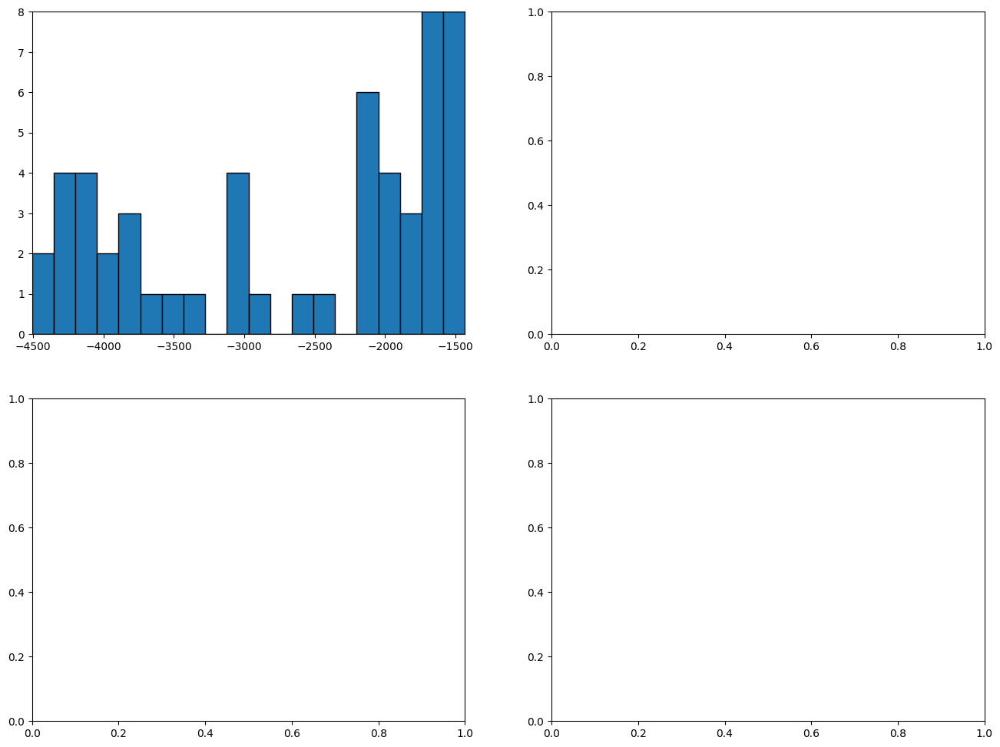

In [ ]:
# Note: TensorBoard (above) shows REAL-TIME learning curves within each trial
# These matplotlib plots show SUMMARY statistics across all trials

import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# 1. Reward distribution
ax = axes[0, 0]
ax.hist(results_df["episode_return_mean"].dropna(), bins=20, edgecolor='black')
ax.axvline(best_trial.last_result['episode_return_mean'],
           color='red', linestyle='--', linewidth=2, label='Best')
ax.set_xlabel("Final Episode Reward Mean")
ax.set_ylabel("Number of Trials")
ax.set_title("Distribution of Final Rewards Across All Trials")
ax.legend()
ax.grid(True, alpha=0.3)

# 2. Hyperparameter importance
ax = axes[0, 1]
hyperparam_cols = [
    "config/learning_rate",
    "config/n_steps",
    "config/n_epochs",
    "config/gamma",
    "config/ent_coef"
]

correlations = []
for col in hyperparam_cols:
    if col in results_df.columns:
        numeric_col = pd.to_numeric(results_df[col], errors='coerce')
        corr = numeric_col.corr(results_df["episode_return_mean"])
        correlations.append((col.replace("config/", ""), abs(corr)))

correlations.sort(key=lambda x: x[1], reverse=True)
params, corrs = zip(*correlations)

ax.barh(params, corrs, color='steelblue')
ax.set_xlabel("Absolute Correlation with Reward")
ax.set_title("Hyperparameter Importance")
ax.grid(True, axis='x', alpha=0.3)

# 3. Timesteps vs Reward (ASHA effectiveness)
ax = axes[1, 0]
ax.scatter(results_df["timesteps_total"],
           results_df["episode_return_mean"],
           alpha=0.6, s=50)
ax.axhline(best_trial.last_result['episode_return_mean'],
           color='red', linestyle='--', linewidth=1, label='Best')
ax.set_xlabel("Timesteps Trained")
ax.set_ylabel("Episode Reward Mean")
ax.set_title("ASHA Early Stopping: Timesteps vs Reward")
ax.legend()
ax.grid(True, alpha=0.3)

# 4. Learning rate vs Reward
ax = axes[1, 1]
lr_values = pd.to_numeric(results_df["config/learning_rate"], errors='coerce')
ax.scatter(lr_values, results_df["episode_return_mean"], alpha=0.6, s=50)
ax.set_xscale('log')
ax.set_xlabel("Learning Rate (log scale)")
ax.set_ylabel("Episode Reward Mean")
ax.set_title("Learning Rate vs Performance")
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig("/content/optimization_analysis.png", dpi=150)
plt.savefig(f"{EXP_ROOT}/optimization_analysis.png", dpi=150)
plt.show()

print("✓ Visualization saved to:")
print(f"   Local: /content/optimization_analysis.png")
print(f"   Drive: {EXP_ROOT}/optimization_analysis.png")

#Best model

## Train Best Model

### Create Env and Algo

In [75]:
# Shutdown and re-initialize Ray
if ray.is_initialized():
    ray.shutdown()

ray.init(
    ignore_reinit_error=True,
    num_cpus=2,
    num_gpus=0,
    runtime_env={
        "py_modules": ["/content/custom_reward.py"],
        "env_vars": {"PYTHONPATH": "/content"}
    }
)

# Register environment
def env_creator(config):
    return RllibCityLearnEnv(config)

register_env("CityLearnMAPPO-v0", env_creator)

# Environment config
env_config = {
    "schema": SCHEMA_PATH,
    "buildings": BUILDINGS_TRAIN,
    "simulation_start_time_step": TRAIN_START_TIMESTEP,
    "simulation_end_time_step": TRAIN_END_TIMESTEP,
    "episode_limit": TRAIN_END_TIME_STEP - TRAIN_START_TIME_STEP,
}

# Get agent info
temp_env = env_creator(env_config)
agent_ids = list(temp_env.possible_agents)

print("="*70)
print("TRAINING FINAL MODEL WITH BEST HYPERPARAMETERS")
print("="*70)
for key, value in best_config.items():
    print(f"  {key}: {value}")
print("="*70)

# Build config with best hyperparameters + full resources
final_config = (
    PPOConfig()
    .environment(
        env="CityLearnMAPPO-v0",
        env_config=env_config,
    )
    .learners(
        num_gpus_per_learner=0,
        num_cpus_per_learner=1,
    )
    .env_runners(
        num_env_runners=NUM_ENV_RUNNERS,
        num_envs_per_env_runner=1,
        rollout_fragment_length=best_config["rollout_fragment_length"],
    )
    .training(
        # BEST HYPERPARAMETERS FROM OPTUNA
        train_batch_size=best_config["train_batch_size"],
        minibatch_size=best_config["minibatch_size"],
        num_epochs=best_config["num_epochs"],
        lr=best_config["learning_rate"],
        gamma=best_config["gamma"],
        entropy_coeff=best_config["entropy_coeff"],

        # FIXED HYPERPARAMETERS (from MAPPO paper)
        lambda_=0.95,
        clip_param=0.2,
        vf_clip_param=10.0,
        vf_loss_coeff=0.5,
        grad_clip=0.5,
    )
    .multi_agent(
        policies={"shared_policy": PolicySpec()},
        policy_mapping_fn=lambda agent_id, *args, **kwargs: "shared_policy",
    )
    .rl_module(
    rl_module_spec=MultiRLModuleSpec(
        rl_module_specs={
            "shared_policy": RLModuleSpec(
                module_class=MAPPOTorchRLModule,
            )
        },
    ),
    model_config=DefaultModelConfig(
        fcnet_hiddens=[64, 64],
        fcnet_activation="tanh",
    ),
)
    .debugging(
        log_level="WARN",
    )
)

# Build and train
algo_try = final_config.build()

print("Algo build successuflly!")

INFO:root:Failed to configure TPU pod. Got: tpu_name: None, worker_id: 0, accelerator_type: v6e-1
2026-02-13 14:51:36,941	INFO worker.py:2007 -- Started a local Ray instance.
2026-02-13 14:51:36,944	INFO packaging.py:691 -- Creating a file package for local module '/content/custom_reward.py'.
2026-02-13 14:51:36,945	INFO packaging.py:463 -- Pushing file package 'gcs://_ray_pkg_9c82dd1520ed948b.zip' (0.00MiB) to Ray cluster...
2026-02-13 14:51:36,946	INFO packaging.py:476 -- Successfully pushed file package 'gcs://_ray_pkg_9c82dd1520ed948b.zip'.
2026-02-13 14:51:39,515	WARNING ipython-input-1167754597.py:96 -- DeprecationWarning: `build` has been deprecated. Use `AlgorithmConfig.build_algo` instead. This will raise an error in the future!
2026-02-13 14:51:39,516	WARNING algorithm_config.py:5118 -- You are running PPO on the new API stack! This is the new default behavior for this algorithm. If you don't want to use the new API stack, set `config.api_stack(enable_rl_module_and_learner=Fa

Environment created with 4 agents:
  Local obs dim : 31
  Global state dim: 124
TRAINING FINAL MODEL WITH BEST HYPERPARAMETERS
  learning_rate: 0.0005
  rollout_fragment_length: 240
  train_batch_size: 480
  minibatch_size: 480
  num_epochs: 10
  gamma: 0.85
  entropy_coeff: 0.003


(pid=33825) /usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
(pid=33825)   warnings.warn(


(MultiAgentEnvRunner pid=33825) Environment created with 4 agents:
(MultiAgentEnvRunner pid=33825)   Local obs dim : 31
(MultiAgentEnvRunner pid=33825)   Global state dim: 124


(MultiAgentEnvRunner pid=33825) DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
2026-02-13 14:51:46,182	WARNING rl_module.py:459 -- DeprecationWarning: `RLModule(config=[RLModuleConfig object])` has been deprecated. Use `RLModule(observation_space=.., action_space=.., inference_only=.., model_config=.., catalog_class=..)` instead. This will raise an error in the future!
2026-02-13 14:51:46,781	WARNING util.py:61 -- Install gputil for GPU system monitoring.


Algo build successuflly!


### Training Loop

In [76]:
def clean(x):
    if x is None:
        return None
    try:
        return None if np.isnan(x) else float(x)
    except TypeError:
        return float(x)

In [77]:
tb_log_dir = f"{EXP_ROOT}/tensorboard_best_model"
print(f"TensorBoard log dir: {tb_log_dir}")

os.makedirs(tb_log_dir, exist_ok=True)

%reload_ext tensorboard
%tensorboard --logdir {tb_log_dir}

TensorBoard log dir: /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1/tensorboard_best_model


<IPython.core.display.Javascript object>

In [79]:
# Train for longer
import time
from torch.utils.tensorboard import SummaryWriter


NUM_ITERATIONS =300
best_reward = -np.inf
results = []

writer = SummaryWriter(log_dir=tb_log_dir)

time_start = time.perf_counter()
print("\nStarting final training...")
for iteration in range(NUM_ITERATIONS):
    result = algo_try.train()

    episode_return_mean = result.get("env_runners", {}).get("episode_return_mean")
    episode_len_mean = result.get("env_runners", {}).get("episode_len_mean")
    timesteps_total = result.get("num_env_steps_sampled_lifetime")

    episode_len_mean = clean(episode_len_mean)
    episode_return_mean = clean(episode_return_mean)

    # --- Per-agent rewards ---
    agent_returns = result.get("env_runners", {}).get("agent_episode_returns_mean", {})
    for agent_id in agent_ids:
        val = clean(agent_returns.get(agent_id))
        if val is not None:
            writer.add_scalar(f"agents/reward_{agent_id}", val, timesteps_total)


     # --- Loss metrics averaged across agents ---
    policy_losses, vf_losses, entropies = [], [], []
    for agent_id in agent_ids:
        learner_stats = result.get("learners", {}).get(agent_id, {})
        if learner_stats:
            policy_losses.append(learner_stats.get("policy_loss", 0))
            vf_losses.append(learner_stats.get("vf_loss", 0))
            entropies.append(learner_stats.get("entropy", 0))

    policy_loss = np.mean(policy_losses) if policy_losses else 0
    vf_loss     = np.mean(vf_losses)     if vf_losses     else 0
    entropy     = np.mean(entropies)     if entropies      else 0

    # --- Write to TensorBoard ---
    if episode_return_mean is not None:
        writer.add_scalar("training/episode_return_mean", episode_return_mean, timesteps_total)
    if episode_len_mean is not None:
        writer.add_scalar("training/episode_len_mean", episode_len_mean, timesteps_total)
    writer.add_scalar("training/policy_loss", policy_loss, timesteps_total)
    writer.add_scalar("training/vf_loss",     vf_loss,     timesteps_total)
    writer.add_scalar("training/entropy",     entropy,     timesteps_total)
    writer.flush()

    results.append({
        "iteration": iteration + 1,
        "reward_mean": episode_return_mean,
        "episode_len": episode_len_mean,
        "timesteps": timesteps_total,
    })

    reward_str = f"{episode_return_mean:8.2f}" if episode_return_mean is not None else "n/a"
    len_str = f"{episode_len_mean:6.1f}" if episode_len_mean is not None else "n/a"

    # print(f"Iter {iteration + 1:3d} | "
    #       f"Reward: {reward_str} | "
    #       f"Len: {len_str} | "
    #       f"Steps: {timesteps_total}")

    learners = result.get("learners", {})
    # depending on config, keys differ; just print once
    # if iteration == 6:
    #   print("learners keys:", learners.keys())

    if episode_return_mean is not None and episode_return_mean > best_reward:
        best_reward = episode_return_mean
        # Save to both local and Drive
        checkpoint_dir_local = algo_try.save("/content/mappo_best_checkpoint")
        checkpoint_dir_drive = algo_try.save(f"{EXP_ROOT}/mappo_best_checkpoint")
        print(f"  → New best! Saved checkpoint to Drive")
        print(f"Iter {iteration + 1:3d} | "
          f"Reward: {reward_str} | "
          f"Len: {len_str} | "
          f"Steps: {timesteps_total}")

print("\n" + "="*70)
print(f"Final Training Complete! Best reward: {best_reward:.2f}")
time_end = time.perf_counter()
print(f"Total training time: {time_end - time_start:.2f} seconds")
print("="*70)



Starting final training...
  → New best! Saved checkpoint to Drive
Iter   6 | Reward: -2308.09 | Len: 1440.0 | Steps: 5760.0
  → New best! Saved checkpoint to Drive
Iter  12 | Reward: -1998.01 | Len: 1440.0 | Steps: 8640.0
  → New best! Saved checkpoint to Drive
Iter  18 | Reward: -1878.35 | Len: 1440.0 | Steps: 11520.0
  → New best! Saved checkpoint to Drive
Iter  24 | Reward: -1767.82 | Len: 1440.0 | Steps: 14400.0
  → New best! Saved checkpoint to Drive
Iter  30 | Reward: -1748.65 | Len: 1440.0 | Steps: 17280.0
  → New best! Saved checkpoint to Drive
Iter  36 | Reward: -1688.92 | Len: 1440.0 | Steps: 20160.0
  → New best! Saved checkpoint to Drive
Iter  48 | Reward: -1662.28 | Len: 1440.0 | Steps: 25920.0
  → New best! Saved checkpoint to Drive
Iter  54 | Reward: -1627.82 | Len: 1440.0 | Steps: 28800.0
  → New best! Saved checkpoint to Drive
Iter  60 | Reward: -1584.81 | Len: 1440.0 | Steps: 31680.0
  → New best! Saved checkpoint to Drive
Iter  66 | Reward: -1560.02 | Len: 1440.0 |

In [ ]:
#learners['Building_1']

{'total_loss': np.float64(0.30912530422210693),
 'default_optimizer_learning_rate': np.float64(0.001),
 'entropy': np.float64(1.2090725898742676),
 'num_module_steps_trained_lifetime': 55440.0,
 'policy_loss': np.float64(0.03318047896027565),
 'weights_seq_no': np.float64(11.0),
 'module_train_batch_size_mean': np.float64(240.0),
 'vf_explained_var': np.float64(0.5683766603469849),
 'curr_entropy_coeff': np.float64(0.001),
 'vf_loss': np.float64(0.539128303527832),
 'curr_kl_coeff': np.float64(0.675000011920929),
 'mean_kl_loss': np.float64(0.011244107037782669),
 'num_module_steps_trained': np.int64(5040),
 'vf_loss_unclipped': np.float64(0.6351123452186584),
 'num_trainable_parameters': nan,
 'diff_num_grad_updates_vs_sampler_policy': np.float64(1.0),
 'gradients_default_optimizer_global_norm': np.float64(0.26973748207092285),
 'num_module_steps_trained_lifetime_throughput': {'throughput_since_last_reduce': 1139.4362869299937,
  'throughput_since_last_restore': 631.9379159724501}}

### Upload the model

In [ ]:
checkpoint_dir_drive = (f"{EXP_ROOT}/mappo_best_checkpoint")
print(checkpoint_dir_drive)
algo.restore(checkpoint_dir_drive)

print("Algo Restored Successfully")


/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/IPPO/2026_02_12_IPPO_Summer_Optuna_trial_v2/ippo_best_checkpoint


2026-02-12 17:45:43,427	INFO trainable.py:578 -- Restored on 172.28.0.12 from checkpoint: Checkpoint(filesystem=local, path=/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/IPPO/2026_02_12_IPPO_Summer_Optuna_trial_v2/ippo_best_checkpoint)


Algo Restored Successfully


/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/IPPO/2026_02_12_IPPO_Summer_Optuna_trial_v2


## Evaluate Best Model

In [90]:
import torch
from ray.rllib.core.columns import Columns


print("="*70)
print("EVALUATING ON TEST SET")
print("="*70)

test_env_config = {
    "schema": SCHEMA_PATH,
    "buildings": BUILDINGS_TEST,
    "simulation_start_time_step": EVAL_START_TIMESTEP,
    "simulation_end_time_step": EVAL_END_TIMESTEP-1,  # +1 for 1440 steps
    "episode_limit": TEST_END_TIME_STEP - TEST_START_TIME_STEP + 1,
}

test_env = env_creator(test_env_config)

obs, _ = test_env.reset()
terminated = {"__all__": False}
truncated  = {"__all__": False}
step_count = 0

# Per-agent reward accumulator
per_agent_rewards = {agent_id: [] for agent_id in agent_ids}
combined_rewards  = []

while not (terminated["__all__"] or truncated["__all__"]):
    actions = {}
    for agent_id in obs.keys():
        agent_obs = obs[agent_id]  # dict: {"obs": np.array, "state": np.array}

        obs_tensor = {
            Columns.OBS: {
                "obs":   torch.FloatTensor(agent_obs["obs"]).unsqueeze(0),
                "state": torch.FloatTensor(agent_obs["state"]).unsqueeze(0),
            }
        }

        with torch.no_grad():
            out = algo_try.env_runner.module["shared_policy"].forward_inference(obs_tensor)

        # Gaussian actor: ACTION_DIST_INPUTS = [means..., log_stds...]
        # Take only the first half (means) as the deterministic action
        dist_inputs = out[Columns.ACTION_DIST_INPUTS]
        action = dist_inputs[..., :dist_inputs.shape[-1] // 2].squeeze(0).numpy()
        actions[agent_id] = action

    obs, rewards, terminated, truncated, _ = test_env.step(actions)

    for agent_id in agent_ids:
        per_agent_rewards[agent_id].append(rewards.get(agent_id, 0.0))

    combined_rewards.append(sum(rewards.values()))
    step_count += 1

# --- Summary ---
print(f"\nEpisode length:          {step_count} steps")
print(f"Combined total reward:   {sum(combined_rewards):.4f}")
print(f"Combined mean reward:    {np.mean(combined_rewards):.4f}")
print(f"\nPer-agent rewards:")
for agent_id in agent_ids:
    total = sum(per_agent_rewards[agent_id])
    mean  = np.mean(per_agent_rewards[agent_id])
    std   = np.std(per_agent_rewards[agent_id])
    print(f"  {agent_id}: total={total:.4f}  mean/step={mean:.4f}  std={std:.4f}")

EVALUATING ON TEST SET
Environment created with 4 agents:
  Local obs dim : 31
  Global state dim: 124

Episode length:          743 steps
Combined total reward:   -919.3759
Combined mean reward:    -1.2374

Per-agent rewards:
  Building_1: total=-250.1081  mean/step=-0.3366  std=0.3824
  Building_10: total=-280.9068  mean/step=-0.3781  std=0.5284
  Building_13: total=-190.2881  mean/step=-0.2561  std=0.2673
  Building_16: total=-198.0733  mean/step=-0.2666  std=0.3711


# Retrieve Data

### Retrieve data from Optuna

In [ ]:
RETRIEVE_DATA = True

if RETRIEVE_DATA == True:
    # 1. Carica lo study
    study = optuna.load_study(
        study_name="PPO_Optimization",  # Usa il nome del tuo study
        storage=storage_url  # O il path del tuo database
    )

    # 2. Estrai i dati
    data = []

    for trial in study.trials:
        # Salta trial non completati
        if trial.state != optuna.trial.TrialState.COMPLETE:
            continue

        # Calcola batch_size
        n_steps = trial.params.get('n_steps')
        batch_fraction = trial.params.get('batch_fraction')
        batch_size = int(n_steps * batch_fraction) if (n_steps and batch_fraction) else None

        row = {
            'trial': trial.number,
            'n_steps': n_steps,
            'batch_fraction': batch_fraction,
            'batch_size': batch_size,
            'n_epochs': trial.params.get('n_epochs'),
            'gamma': trial.params.get('gamma'),
            'ent_coef': trial.params.get('ent_coef'),
            'best_mean_reward': trial.user_attrs.get('best_mean_reward'),
            'duration_minutes': trial.user_attrs.get('duration_minutes'),
            'n_evaluations': trial.user_attrs.get('n_evaluations'),
            'total_timesteps': trial.user_attrs.get('total_timesteps'),  # Se l'hai salvato
            'objective_value': trial.value
        }

        data.append(row)

    # 3. Crea DataFrame
    df = pd.DataFrame(data)

    # 4. Ordina per trial number
    df = df.sort_values('trial')

    # 5. Salva in CSV
    df.to_csv(drive_optuna_dir+'/optuna_results.csv', index=False)

    print(f"Salvati {len(df)} trial completati in optuna_results.csv")
    print(f"\nAnteprima:")
    print(df.head(10))

In [ ]:
work_on = df

In [ ]:
work_plot = work_on.sort_values('best_mean_reward', ascending =False)
#display(work_plot)

In [ ]:
plt.plot(work_plot['best_mean_reward'], work_plot['gamma'])
plt.plot(work_plot['best_mean_reward'], work_plot['ent_coef']*10)


In [ ]:
print(drive_optuna_dir)

### Retrieve data from Tensorboard


In [ ]:
from tensorboard.backend.event_processing import event_accumulator

if RETRIEVE_DATA == True:
    def extract_tensorboard_data(trial_dir, trial_number):
        """
        Estrae eval_mean_reward e custom_reward ai timestep delle evaluations.
        """

        # Trova il file degli eventi
        event_file = None
        for root, dirs, files in os.walk(trial_dir):
            for file in files:
                if file.startswith('events.out.tfevents'):
                    event_file = os.path.join(root, file)
                    break
            if event_file:
                break

        if not event_file:
            print(f"No event file found in {trial_dir}")
            return []

        # Carica gli eventi
        ea = event_accumulator.EventAccumulator(event_file)
        ea.Reload()

        # Estrai eval_mean_reward
        if 'eval/mean_reward' not in ea.Tags()['scalars']:
            print(f"No eval/mean_reward in trial {trial_number}")
            return []

        eval_rewards = ea.Scalars('eval/mean_reward')
        eval_data = [(e.step, e.value) for e in eval_rewards]

        # Estrai custom/episode_reward
        episode_rewards = []
        if 'custom/episode_reward' in ea.Tags()['scalars']:
            episode_rewards = [(e.step, e.value) for e in ea.Scalars('custom/episode_reward')]

        # Allinea ai timestep delle evaluations
        rows = []

        for eval_step, eval_reward in eval_data:
            row = {
                'trial': trial_number,
                'step': eval_step,
                'eval_mean_reward': eval_reward,
                'custom_reward': None
            }

            # Trova l'ultimo episode_reward prima o uguale a eval_step
            if episode_rewards:
                valid_episodes = [r for s, r in episode_rewards if s <= eval_step]
                if valid_episodes:
                    row['custom_reward'] = valid_episodes[-1]

            rows.append(row)

        return rows

    # Estrai per tutti i trial
    all_rows = []

    # MODIFICA QUESTO PATH - usa il tuo EXP_ROOT o LOCAL_ROOT
    base_path = EXP_ROOT

    # MODIFICA IL RANGE - metti il numero massimo di trial che hai
    for trial_num in range(30):
        trial_dir = os.path.join(base_path, f"trial_{trial_num}")

        if os.path.exists(trial_dir):
            print(f"Processing trial {trial_num}...")
            rows = extract_tensorboard_data(trial_dir, trial_num)
            all_rows.extend(rows)

    # Crea DataFrame e salva
    df = pd.DataFrame(all_rows)
    df.to_csv(drive_optuna_dir+'/tensorboard_results.csv', index=False)

    print(f"\n Salvati {len(df)} evaluation records da {df['trial'].nunique()} trial")
    print(f"\nAnteprima:")
    print(df.head(10))
    print(f"\nEvaluations per trial:")
    print(df.groupby('trial').size())

# Resume Training for one model

### Tensorboard for resumed training

In [ ]:
#shutil.rmtree(resumed_trial_dir)

In [ ]:
RESUME_TRAINING = False

if RESUME_TRAINING == True:

  resumed_trial_dir = "resumed_trial"
  resumed_models_dir = os.path.join(resumed_trial_dir, "models")
  resumed_eval_logs_dir = os.path.join(resumed_trial_dir, "eval_logs")
  resumed_tensorboard_dir = os.path.join(resumed_trial_dir, "tensorboard")

  os.makedirs(resumed_models_dir, exist_ok=True)
  os.makedirs(resumed_eval_logs_dir, exist_ok=True)
  os.makedirs(resumed_tensorboard_dir, exist_ok=True)

  %reload_ext tensorboard
  %tensorboard --logdir {resumed_tensorboard_dir}

else:
  resumed_path = '/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/Optuna_params/resumed_trial'
  resumed_tensorboard_dir = os.path.join(resumed_path, "tensorboard")

  %reload_ext tensorboard
  %tensorboard --logdir {resumed_tensorboard_dir}




Reusing TensorBoard on port 6008 (pid 3727), started 0:06:58 ago. (Use '!kill 3727' to kill it.)

<IPython.core.display.Javascript object>

### Resume training script

#### Callback for Saving the CSV



In [ ]:
class SaveEvalCSVCallback(BaseCallback):
    def __init__(self, eval_log_path, verbose=0):
        super(SaveEvalCSVCallback, self).__init__(verbose)
        self.eval_log_path = eval_log_path
        self.best_mean_reward = -np.inf
        self.max_reward = -np.inf

    def _on_step(self) -> bool:
        # Check if there's new evaluation data
        eval_results_file = os.path.join(self.eval_log_path, "evaluations.npz")
        if os.path.exists(eval_results_file):
            eval_data = np.load(eval_results_file)

            # Extract data
            timesteps = eval_data['timesteps']
            results = eval_data['results']
            ep_lengths = eval_data['ep_lengths'] if 'ep_lengths' in eval_data else None

            # Update best_mean_reward and max_reward
            current_mean_reward = results[-1].mean() if results.ndim > 1 else results[-1]
            current_max_reward = results[-1].max() if results.ndim > 1 else results[-1]

            if current_mean_reward > self.best_mean_reward:
                self.best_mean_reward = current_mean_reward
            if current_max_reward > self.max_reward:
                self.max_reward = current_max_reward

            # Create DataFrame
            eval_df = pd.DataFrame({
                'timestep': timesteps,
                'mean_reward': results.mean(axis=1) if results.ndim > 1 else results,
                'std_reward': results.std(axis=1) if results.ndim > 1 else 0,
                'min_reward': results.min(axis=1) if results.ndim > 1 else results,
                'max_reward': results.max(axis=1) if results.ndim > 1 else results,
            })

            # Add best_mean_reward and overall max_reward
            eval_df['best_mean_reward'] = self.best_mean_reward
            eval_df['overall_max_reward'] = self.max_reward

            if ep_lengths is not None:
                eval_df['mean_ep_length'] = ep_lengths.mean(axis=1) if ep_lengths.ndim > 1 else ep_lengths

            # Save to CSV
            csv_path = os.path.join(self.eval_log_path, "evaluation_scores.csv")
            eval_df.to_csv(csv_path, index=False)

            if self.verbose > 0:
                print(f"CSV updated: best_mean_reward={self.best_mean_reward:.2f}, max_reward={self.max_reward:.2f}")

        return True

#### Resumed training

In [ ]:
# --- Resume training

train_env = create_citylearn_env(
        buildings=BUILDINGS_TRAIN_LIST,
        schema=TRAIN_SCHEMA,
        start_timestep=TRAIN_START_TIMESTEP,
        end_timestep=TRAIN_END_TIMESTEP,
        seed=SEED_TRAIN
    )

eval_env = create_citylearn_env(
    buildings=BUILDINGS_EVAL_LIST,
    schema=EVAL_SCHEMA,
    start_timestep=EVAL_START_TIMESTEP,
    end_timestep=EVAL_END_TIMESTEP,
    seed=SEED_EVAL
)

if RESUME_TRAINING == True:

    # Epochs to continue
    EPOCHS = 400
    EVAL_FREQUENCY = TOTAL_TIMESTEPS * 10
    N_EVALUATION_EPISODES = 1

    model_path = best_model_path
    model_to_train = PPO.load(
        model_path,
        env=train_env,
        tensorboard_log=resumed_tensorboard_dir
    )
    print("Model loaded correctly from:", model_path)
    print("Timesteps trained:", model_to_train.num_timesteps)

    total_timesteps = EPOCHS * TOTAL_TIMESTEPS
    print("Total timesteps needed for train", total_timesteps)

    # Train the model to round up the number of timesteps.
    if model_to_train.num_timesteps < 200*TOTAL_TIMESTEPS:
        print("Epoch reached ")
        epochs_reached = np.ceil(model_to_train.num_timesteps/TOTAL_TIMESTEPS)
        print("Epochs reached: ", epochs_reached)
        remaining_epochs = EPOCHS - epochs_reached
        print("Remaining epochs: ", remaining_epochs)

        remaining_timesteps = int(remaining_epochs*TOTAL_TIMESTEPS)
        print("Remaining timesteps: ", remaining_timesteps)

        # Evaluation callback (saves best model at each evaluation)
        eval_callback = EvalCallback(
            eval_env=eval_env,
            eval_freq=EVAL_FREQUENCY,
            n_eval_episodes=N_EVALUATION_EPISODES,
            deterministic=True,
            best_model_save_path=resumed_models_dir,
            log_path=resumed_eval_logs_dir,
            verbose=1
        )

        # CSV saver callback
        csv_callback = SaveEvalCSVCallback(
            eval_log_path=resumed_eval_logs_dir,
            verbose=1
        )

        # Episode reward logger
        episode_logger = EpisodeRewardLogger(verbose=0)

        callbacks = [eval_callback, csv_callback, episode_logger]

        started_execution = time.perf_counter()
        model_to_train.learn(
            total_timesteps=remaining_timesteps,
            tb_log_name="resume_training",
            reset_num_timesteps=False,
            callback=callbacks,
        )
        ended_execution = time.perf_counter() - started_execution

        print(f"Training time: {ended_execution/60:.2f} minutes")
        print("\nResume training completed!")

        # Save final model
        final_model_path = os.path.join(resumed_models_dir, "final_model")
        model_to_train.save(final_model_path)
        print(f"All results saved to: {resumed_trial_dir}")

        # Save execution time to file
        time_info_path = os.path.join(resumed_trial_dir, "training_time.txt")
        with open(time_info_path, 'w') as f:
            f.write(f"Training execution time: {ended_execution:.2f} seconds\n")
            f.write(f"Training execution time: {ended_execution/60:.2f} minutes\n")
            f.write(f"Training execution time: {ended_execution/3600:.2f} hours\n")
            f.write(f"Epochs trained: {remaining_epochs}\n")
            f.write(f"Timesteps trained: {remaining_timesteps}\n")
        print(f"Training time saved to: {time_info_path}")

        # Copy to Google Drive
        drive_destination = os.path.join(drive_optuna_dir, resumed_trial_dir)
        shutil.copytree(resumed_trial_dir, drive_destination, dirs_exist_ok=True)
        print(f"Copied to Google Drive: {drive_destination}")

else:

  # Upload the trained model
  model_to_load = "models/best_model.zip"
  model_path = os.path.join(resumed_path, model_to_load)
  print("Model path:", model_path)
  model_trained = PPO.load(
      model_path,
      env=train_env,
      tensorboard_log=resumed_tensorboard_dir)
  print("Model loaded correctly from:", model_path)
  print("Timesteps trained:", model_trained.num_timesteps)



/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/Optuna_params/resumed_trial
Model path: /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/Optuna_params/resumed_trial/models/best_model.zip
Model loaded correctly from: /content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/Optuna_params/resumed_trial/models/best_model.zip
Timesteps trained: 575859


# Plot Optuna Params

/tmp/ipython-input-2295787756.py:2: ExperimentalWarning: optuna.visualization.matplotlib._optimization_history.plot_optimization_history is experimental (supported from v2.2.0). The interface can change in the future.
  plot_optimization_history(study)


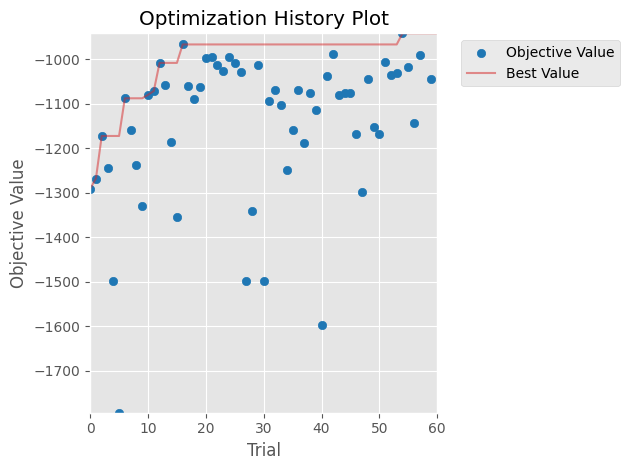

In [ ]:
# --- Plot ----
plot_optimization_history(study)
os.makedirs(drive_optuna_dir, exist_ok=True)
plt.savefig(f"{drive_optuna_dir}/Optimization_History_plot.png")

In [ ]:
print(optuna_saves_dir)
print(drive_optuna_dir)

/tmp/ipython-input-4053187012.py:1: ExperimentalWarning: optuna.visualization.matplotlib._param_importances.plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


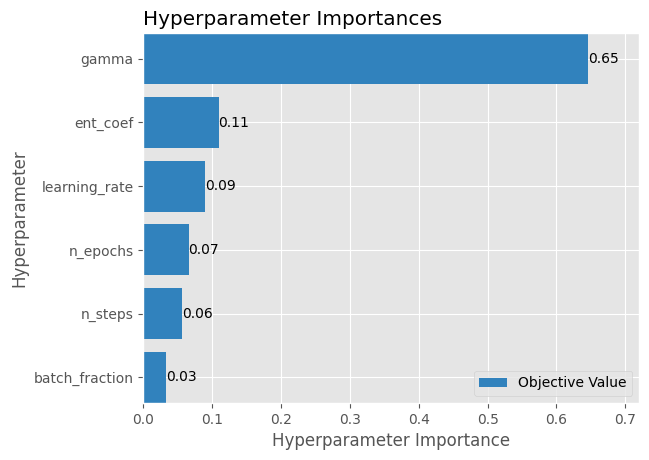

In [ ]:
plot_param_importances(study)
os.makedirs(drive_optuna_dir, exist_ok=True)
plt.savefig(f"{drive_optuna_dir}/Hyperparameter_Importances.png")

# Test

## Baseline sim - Summer

In [82]:
baseline_env = CityLearnEnv(
    TEST_DATASET,
    central_agent=CENTRAL_AGENT,
    buildings=BUILDINGS_TEST,
    active_observations=ACTIVE_OBSERVATIONS,
    #active_observations=ACTIVE_OBSERVATIONS,
    simulation_start_time_step=TEST_START_TIME_STEP,
    simulation_end_time_step=TEST_END_TIME_STEP,
)


In [83]:
baseline_model= BaselineAgent(baseline_env)

In [84]:
# always start by reseting the environment
observations, _ = baseline_env.reset()
steps = 0
# step through the environment until terminal
# state is reached i.e., the control episode ends
start = time.perf_counter()
while not baseline_env.terminated:
    # select actions from the model
    actions = baseline_model.predict(observations)
    # apply selected actions to the environment
    observations, _, _, _, _ = baseline_env.step(actions)

    steps = steps+1
end = time.perf_counter() - start
print(end)
print(steps)

1.592491482999776
743


## Rule Based Control

In [85]:
# define action map
action_map = {
    1: 1/12, # Rule for 1 AM
    2: 1/12, # Rule for 2 AM
    3: 1/12, # Rule for 3 AM
    4: 1/12, # Rule for 4 AM
    5: 1/12, # Rule for 5 AM
    6: 1/12, # Rule for 6 AM
    7: 1/12, # Rule for 7 AM
    8: 1/12, # Rule for 8 AM
    9: 1/12, # Rule for 9 AM
    10: 1/12, # Rule for 10 AM
    11: 1/12, # Rule for 11 AM
    12: 1/12, # Rule for 12 PM
    13: -1/12, # Rule for 1 PM
    14: -1/12, # Rule for 2 PM
    15: -1/12, # Rule for 3 PM
    16: -1/12, # Rule for 4 PM
    17: -1/12, # Rule for 5 PM
    18: -1/12, # Rule for 6 PM
    19: -1/12, # Rule for 7 PM
    20: -1/12, # Rule for 8 PM
    21: -1/12, # Rule for 9 PM
    22: -1/12, # Rule for 10 PM
    23: -1/12, # Rule for 11 PM
    24: -1/12, # Rule for 12 AM
}

# run inference
rbc_env = CityLearnEnv(
    TEST_DATASET,
    central_agent=False,
    buildings=BUILDINGS_TEST,
    active_observations=ACTIVE_OBSERVATIONS,
    simulation_start_time_step=TEST_START_TIME_STEP,
    simulation_end_time_step=TEST_END_TIME_STEP,
)
rbc_model = HourRBC(rbc_env, action_map=action_map)
observations, _ = rbc_env.reset()

while not rbc_env.terminated:
    actions = rbc_model.predict(observations)
    observations, _, _, _, _ = rbc_env.step(actions)


print("RBC Successfully completed")

RBC Successfully completed


## CityLearn Test



### Model load

In [86]:
SAVE_FIGS = False

# best_trial = study.best_trial
# trial_number = best_trial.number
# print(f"{EXP_ROOT}/trial_{trial_number}/best_model.zip")
# model = PPO.load(
#     f"{EXP_ROOT}/trial_{trial_number}/best_model.zip",
# )

# --- Plot simulation MBsummary  ---
if SAVE_FIGS == True:
  image_saving_dir = f"{resumed_path}/CityLearnSim"
  os.makedirs(image_saving_dir, exist_ok=True)
  print(image_saving_dir)
else:
  image_saving_dir = None

# ------ This part is for playing
#G:\Il mio Drive\Università\2_Magistrale\RES\Thesis\06_simulations\PPO\2026_01_30_PPO_Agent_Summer_Optuna_trial_v1\Optuna_params\resumed_trial\models
print(EXP_ROOT)
single_agent_dir = '/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/Optuna_params/resumed_trial/models/best_model.zip'
# trial_study = "/trial_"
# trial_model_path = EXP_ROOT + trial_study + "/best_model.zip"
print(single_agent_dir)
# --- Plot simulation MBsummary  ---
# if SAVE_FIGS == True:
#   image_saving_dir = EXP_ROOT +trial_study+"/CityLearn"
#   os.makedirs(image_saving_dir, exist_ok=True)
# else:
#   image_saving_dir = None


single_agent_model = PPO.load(single_agent_dir)
print("MOdel Loaded successfully")

# --------- Finish playing part

/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/MAPPO/2026_02_13_MAPPO_Summer_Optuna_trial_v1
/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/PPO/2026_01_30_PPO_Agent_Summer_Optuna_trial_v1/Optuna_params/resumed_trial/models/best_model.zip
MOdel Loaded successfully


In [ ]:
print(EXP_ROOT)

/content/drive/MyDrive/Università/2_Magistrale/RES/Thesis/06_simulations/IPPO/2026_02_12_IPPO_Summer_Optuna_trial_v2


### Testing part - Single Agent


In [87]:
BUILDINGS_TEST = sorted(BUILDINGS_TEST)

import pprint
PPO_test_env = CityLearnEnv(
    buildings = BUILDINGS_TEST,
    schema = TEST_DATASET,
    active_observations=ACTIVE_OBSERVATIONS,
    simulation_start_time_step = TEST_START_TIME_STEP,
    simulation_end_time_step = TEST_END_TIME_STEP,
    central_agent = True,
    reward_function = CustomReward,
    random_seed = RANDOM_SEED,

)
observations, _ = PPO_test_env.reset()
print("\nThis is observations - Base env")
pprint.pprint(observations)

obs_names = PPO_test_env.observation_names
print("\nObservation Names - Base Env")
pprint.pprint(obs_names)

test_obs_dict = dict(zip(obs_names[0], observations[0]))
print('\nObservation Dictionary for Testing Env')
import pprint
pprint.pprint(test_obs_dict)

PPO_test_env = NormalizedObservationWrapper(PPO_test_env)

observations, _ = PPO_test_env.reset()
print("\nThis is observations - NormWrap")
pprint.pprint(observations)

obs_names = PPO_test_env.observation_names
print("\nObservation Names - NormWrap")
pprint.pprint(obs_names)


test_obs_dict = dict(zip(obs_names[0], observations[0]))
print('\nObservation Dictionary for Testing Env - Normalization Warp')

pprint.pprint(test_obs_dict)
PPO_test_env = StableBaselines3Wrapper(PPO_test_env)

observations, _ = PPO_test_env.reset()
print("\nObservations array after SB3 Wrap")
pprint.pprint(observations)


import pprint
pprint.pprint(test_obs_dict)


This is observations - Base env
[[np.int32(1),
  np.int32(1),
  np.float32(0.0),
  np.float32(0.0),
  np.float32(0.85116667),
  np.float32(0.0),
  np.float32(0.0),
  np.float32(0.5506778),
  np.float32(0.0),
  np.float32(0.0),
  np.float32(1.40575),
  np.float32(0.0),
  np.float32(0.0),
  np.float32(0.8959)]]

Observation Names - Base Env
[['day_type',
  'hour',
  'solar_generation',
  'electrical_storage_soc',
  'net_electricity_consumption',
  'solar_generation',
  'electrical_storage_soc',
  'net_electricity_consumption',
  'solar_generation',
  'electrical_storage_soc',
  'net_electricity_consumption',
  'solar_generation',
  'electrical_storage_soc',
  'net_electricity_consumption']]

Observation Dictionary for Testing Env
{'day_type': np.int32(1),
 'electrical_storage_soc': np.float32(0.0),
 'hour': np.int32(1),
 'net_electricity_consumption': np.float32(0.8959),
 'solar_generation': np.float32(0.0)}

This is observations - NormWrap
[[np.float64(0.8019377358048384),
  np.float64

In [ ]:
print([b.name for b in PPO_test_env.unwrapped.buildings])
print(BUILDINGS_TEST)

In [ ]:
building_names = PPO_test_env.unwrapped.buildings
print("Buildings in environment:", building_names)
print("Number of buildings:", len(building_names))

In [88]:
observations, _ = PPO_test_env.reset()
ppo_action_list = []
reward_list = []
counter_steps = 0
verbose = 1

while not PPO_test_env.unwrapped.terminated:

  actions, _ = single_agent_model.predict(observations, deterministic = True)
  observations, reward, _, _, _ = PPO_test_env.step(actions)



  ppo_action_list.append(actions)
  reward_list.append(reward)
  counter_steps += 1

  #if counter_steps % 4 == 0 and verbose == 1:
    #print('Reward:',reward)
    #print('Actions:',actions)
    # print(observations)
    # print('Electrical storage soc:', {
    # b.name: b.electrical_storage.soc[b.time_step] for b in PPO_test_env.unwrapped.buildings
    # })
    # print('Net Consumption',{
    # b.name: b.net_electricity_consumption[b.time_step] for b in PPO_test_env.unwrapped.buildings
    # })
    # print('Price',{
    # b.name: b.pricing.electricity_pricing[b.time_step] for b in PPO_test_env.unwrapped.buildings
    # })


print(np.mean(ppo_action_list))
print(np.std(reward_list))


-0.37202325
0.9965014


In [ ]:
# actions_random = []
# action_model = []
# observations, _ = PPO_test_env.reset()

# for _ in range(50):
#   random_action = PPO_test_env.action_space.sample()
#   actions_random.append(random_action)

#   model_action, _ = model.predict(observations, deterministic = True)
#   action_model.append(model_action)

#   observations, reward, terminated, _, _ = PPO_test_env.step(model_action)
#   if terminated:
#     observations, _ = PPO_test_env.reset()

# print("Random actions mean:", np.mean(actions_random))
# print("Random actions std:", np.std(actions_random))
# print("Model actions mean:", np.mean(action_model))
# print("Model actions std:", np.std(action_model))

In [ ]:
print('Electrical storage nominal power:', {
    b.name: b.electrical_storage.nominal_power for b in PPO_test_env.unwrapped.buildings
})

In [ ]:
ppo_action_list

In [ ]:
for ii in range(4):
  plt.plot(PPO_test_env.unwrapped.buildings[ii].electrical_storage.soc[:118])

In [ ]:
plt.plot(ppo_action_list[:96])
plt.legend()

for ii in range(3):
  plt.plot(PPO_test_env.unwrapped.buildings[ii].electrical_storage.soc[:118])

In [ ]:
# observations, _ = PPO_test_env.reset()
# actions, _ =  model.predict(observations, deterministic = True)
# print('ACTIONS:',actions)

# observations, reward, terminated, truncated, info = PPO_test_env.step(actions)
# print('OBSERVATIONS:',observations)
# print('Reward:',reward)
# print('Terminated:',terminated)
# print('Truncated:',truncated)
# print('Info:',info)

In [ ]:
# print(ppo_action_list)

# first_elements = [arr[0] for arr in ppo_action_list]
# soc = np.array(PPO_test_env.unwrapped.buildings[0].electrical_storage.soc)

# plt.plot(first_elements)
# plt.plot(soc)
# plt.figure()
# second_elements = [arr[1] for arr in ppo_action_list]
# plt.plot(second_elements, color = 'g')
# soc = np.array(PPO_test_env.unwrapped.buildings[1].electrical_storage.soc)
# plt.plot(soc)



# plt.figure()
# third_elements = [arr[2] for arr in ppo_action_list]
# plt.plot(third_elements, color = 'b')

In [ ]:
# soc = np.array(PPO_test_env.unwrapped.buildings[0].electrical_storage.soc)
# plt.plot(soc)

# plt.figure()
# soc = np.array(PPO_test_env.unwrapped.buildings[1].electrical_storage.soc)
# print(soc)
# plt.plot(soc)

# plt.figure()
# soc = np.array(PPO_test_env.unwrapped.buildings[2].electrical_storage.soc)
# plt.plot(soc)

### Figure

######## BUILDING-LEVEL ########
Building-level KPIs:


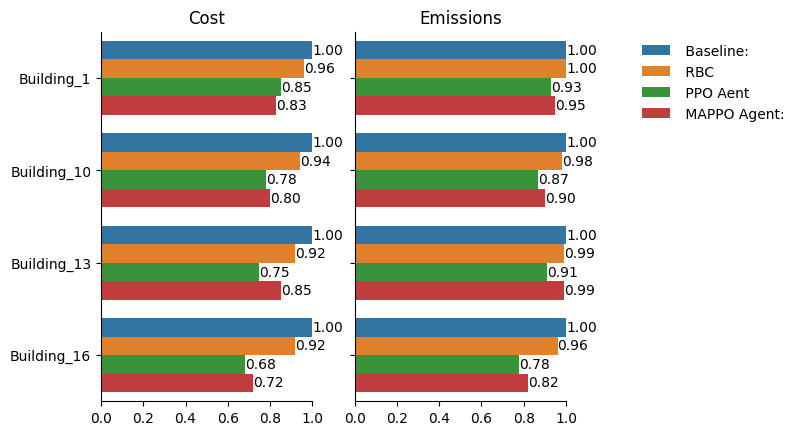

Building-level simulation period load profiles:


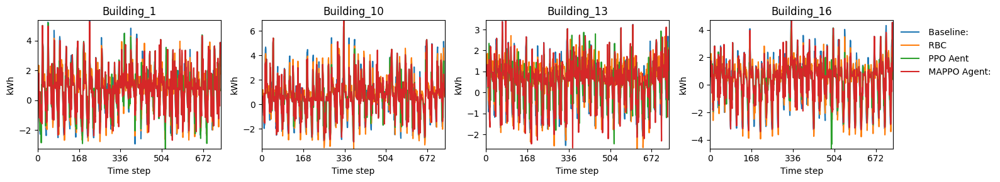

Building-level daily-average load profiles:


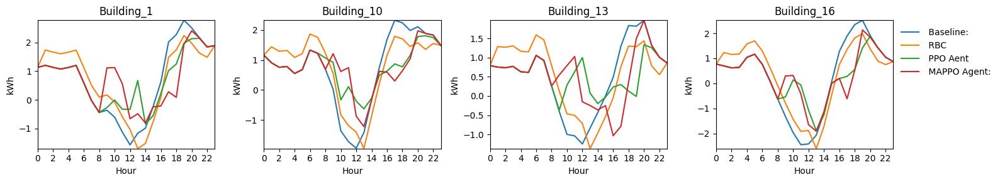

Battery SoC profiles:


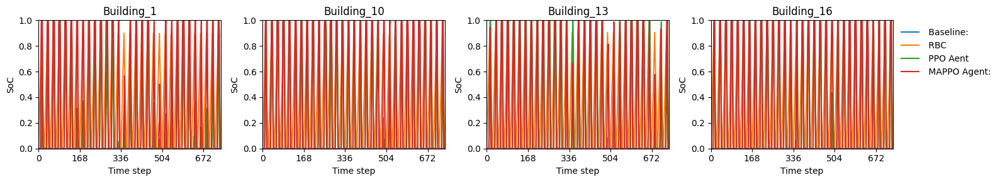

######## DISTRICT-LEVEL ########
District-level KPIs:


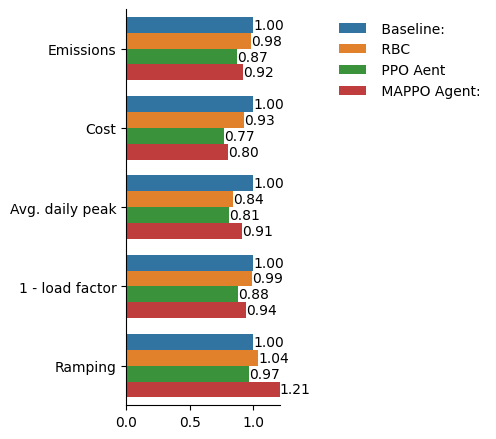

District-level simulation period load profiles:


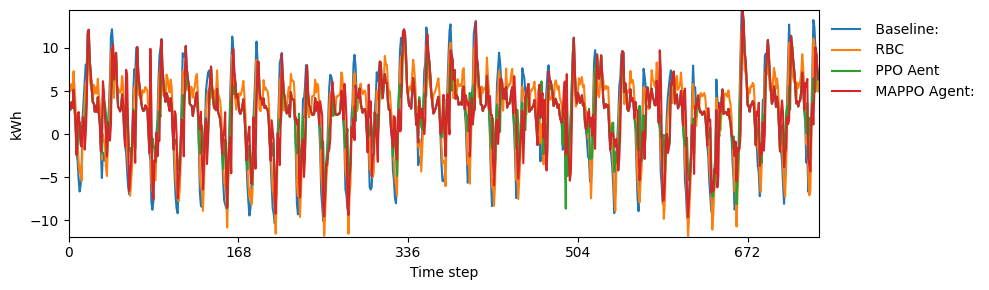

District-level daily-average load profiles:


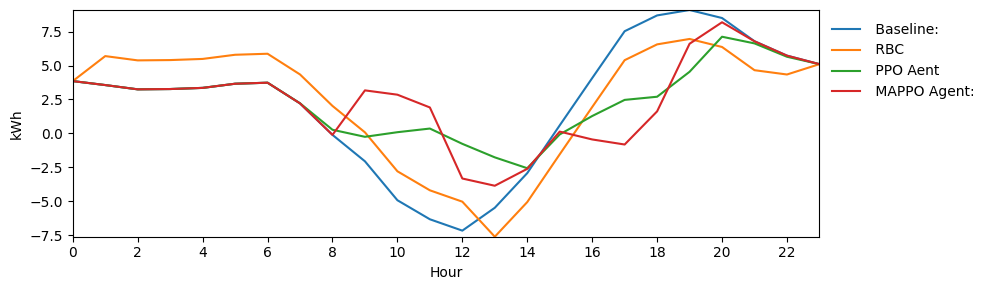

In [91]:
# --- Plot simulation summary  ---
plot_simulation_summary({
    ' Baseline:' : baseline_env,
    ' RBC': rbc_env,
    ' PPO Aent' : PPO_test_env,
    ' MAPPO Agent:' : test_env.env.unwrapped,

},
    save_dir = image_saving_dir)

plt.show()

In [ ]:
plot_actions(ppo_action_list, BUILDINGS_TEST, 'PPO Agent - Action list')
if SAVE_FIGS == True:
  plt.savefig(f"{image_saving_dir}/PPO-Agent - Action List.png")


NameError: name 'ppo_action_list' is not defined

In [ ]:
plot_actions_daily_profile(ppo_action_list, BUILDINGS_TEST, 'Average Daily Action List')

if SAVE_FIGS == True:
  plt.savefig(f"{image_saving_dir}/Average Daily Action List.png")

NameError: name 'ppo_action_list' is not defined

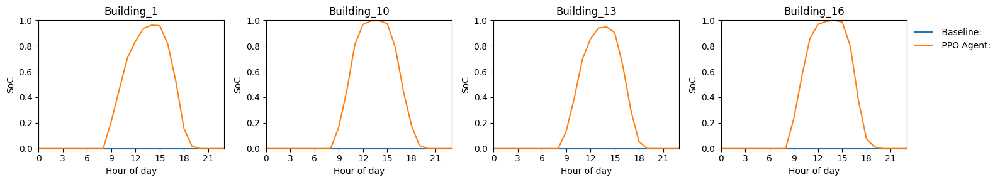

In [92]:
fig = plot_24h_soc_profiles({
    ' Baseline:' : baseline_env,
    ' PPO Agent:' : test_env.env.unwrapped,
})

if SAVE_FIGS == True:
  fig.savefig(f"{image_saving_dir}/24h_SoC_profile.png")


plt.show()